In [1]:
import scanpy as sc
import numpy as np
import scipy as sp
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib import rcParams
from matplotlib import colors
import seaborn as sb
from gprofiler import GProfiler
import seaborn as sns
import rpy2.rinterface_lib.callbacks
import logging

from rpy2.robjects import pandas2ri
import anndata2ri

Unable to determine R home: [WinError 2] The system cannot find the file specified


In [2]:
import importlib
import warnings
warnings.filterwarnings("ignore")

import pickle as pkl

from sccoda.util import comp_ana as mod
from sccoda.util import cell_composition_data as dat
from sccoda.util import data_visualization as viz

In [3]:
#This pallete is for colorblinds
my_pallete = ['#0351A8','#8CB0E0','#D56D11','#FFBB78','#234E08','#53CB8B','#D30083','#CB788D','#4E195A','#C58CCF','#AA290F','#B03FD1','#E8BCCF','#64605F','#B2AD9A','#D2D30B','#D1BD4F','#06DCF2','#9EDAE5','#517219','#5B43CF','#D92F24','#FFD900','#002F33','#B8A3A3']

In [4]:
from matplotlib.colors import LinearSegmentedColormap
values = [0,1]
colors = [(227, 227, 227), (255, 42, 18)]
norm = plt.Normalize(min(values), max(values))
my_cmap = LinearSegmentedColormap.from_list(
    '', [(norm(value), tuple(np.array(color) / 255)) for value, color in zip(values, colors)])

In [5]:
# Ignore R warning messages
#Note: this can be commented out to get more verbose R output
rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# Automatically convert rpy2 outputs to pandas dataframes
pandas2ri.activate()
anndata2ri.activate()
%load_ext rpy2.ipython

plt.rcParams['figure.figsize']=(8,8) #rescale figures
sc.settings.verbosity = 3
#sc.set_figure_params(dpi=200, dpi_save=300)
sc.logging.print_versions()

-----
anndata     0.8.0
scanpy      1.9.1
-----
PIL                                         9.2.0
aa8f2297d25b4dc6fd3d98411eb3ba53823c4f42    NA
absl                                        NA
anndata2ri                                  1.1
arviz                                       0.12.1
asttokens                                   NA
astunparse                                  1.6.3
backcall                                    0.2.0
beta_ufunc                                  NA
binom_ufunc                                 NA
brotli                                      NA
certifi                                     2022.09.24
cffi                                        1.15.1
cftime                                      1.6.2
charset_normalizer                          2.1.1
cloudpickle                                 2.2.0
colorama                                    0.4.5
cycler                                      0.10.0
cython_runtime                              NA
dateutil         

In [6]:
%%R
# Load libraries from correct lib Paths for my environment - ignore this!
.libPaths(.libPaths('C:\\Users\\16220\\AppData\\Local\\R\\win-library\\4.2'))

# Load all the R libraries we will be using in the notebook
library(scran)
library(Seurat)
library(RColorBrewer)
library(slingshot)
library(monocle)
library(gam)
library(ggplot2)
library(plyr)
library(MAST)
library(clusterExperiment)
library(monocle3)

Exception ignored from cffi callback <function _consolewrite_ex at 0x000001A42CAB9040>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 0: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x000001A42CAB9040>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2


    an issue that caused a segfault when used with rpy2:
    https://github.com/rstudio/reticulate/pull/1188
    Make sure that you use a version of that package that includes
    the fix.
    

Exception ignored from cffi callback <function _consolewrite_ex at 0x000001A42CAB9040>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\conversion.py", line 138, in _cchar_to_str_with_maxlen
    s = ffi.string(c, maxlen).decode(encoding)
UnicodeDecodeError: 'utf-8' codec can't decode byte 0xd4 in position 1: invalid continuation byte
Exception ignored from cffi callback <function _consolewrite_ex at 0x000001A42CAB9040>:
Traceback (most recent call last):
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2\rinterface_lib\callbacks.py", line 133, in _consolewrite_ex
    s = conversion._cchar_to_str_with_maxlen(buf, n, _CCHAR_ENCODING)
  File "C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\rpy2

# Preprocess

## Read data

In [5]:
adata1 = sc.read_10x_h5('C1_filtered_feature_bc_matrix.h5')
adata2 = sc.read_10x_h5('C2_filtered_feature_bc_matrix.h5')
adata3 = sc.read_10x_h5('T_filtered_feature_bc_matrix.h5')

reading C1_filtered_feature_bc_matrix.h5
 (0:00:00)
reading C2_filtered_feature_bc_matrix.h5


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)
reading T_filtered_feature_bc_matrix.h5


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


 (0:00:00)


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


In [6]:
adata1.var_names_make_unique()
adata2.var_names_make_unique()
adata3.var_names_make_unique()

## Filter low quality cells

### Dataset1 Filtering

In [7]:
# Quality control - calculate QC covariates
adata1.obs['n_counts'] = adata1.X.sum(1)
adata1.obs['log_counts'] = np.log(adata1.obs['n_counts'])
adata1.obs['n_genes'] = (adata1.X > 0).sum(1)
adata1.obs['log10GenesPerUMI'] = np.log10(adata1.obs['n_genes'])/np.log10(adata1.obs['n_counts']) #This is the complexity

mt_gene_mask = [gene.startswith('MT-') for gene in adata1.var_names]
adata1.obs['mt_frac'] = np.array(adata1.X[:, mt_gene_mask].sum(1).ravel())[0]/adata1.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata1.var_names]
adata1.obs['ribo_frac'] = np.array(adata1.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata1.obs['n_counts']

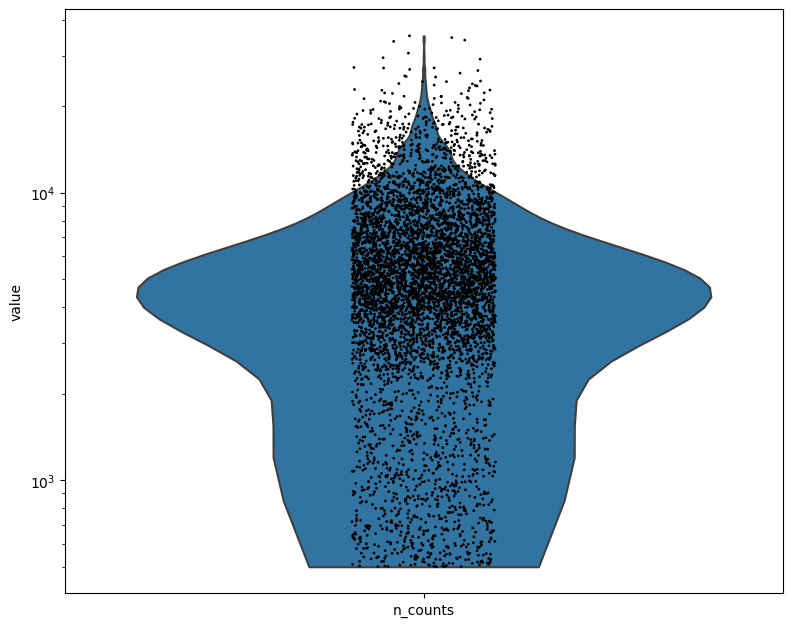

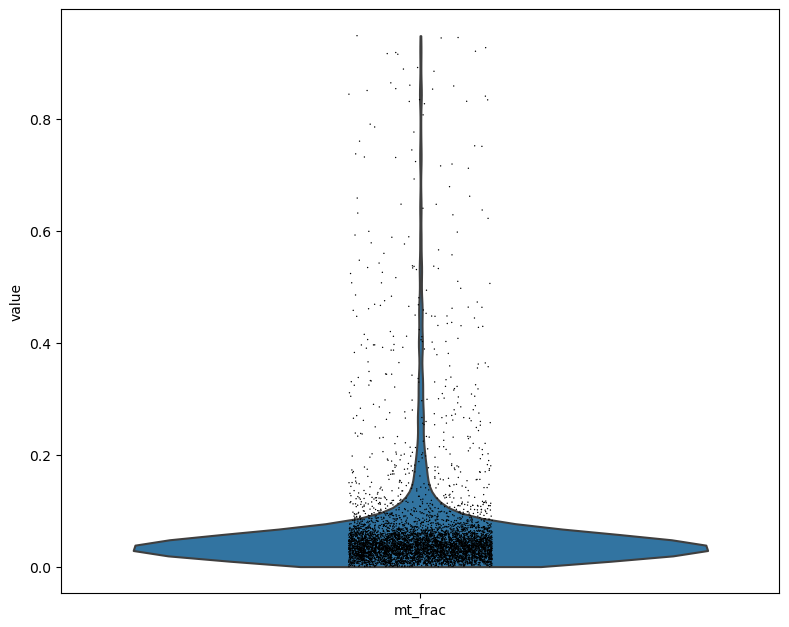

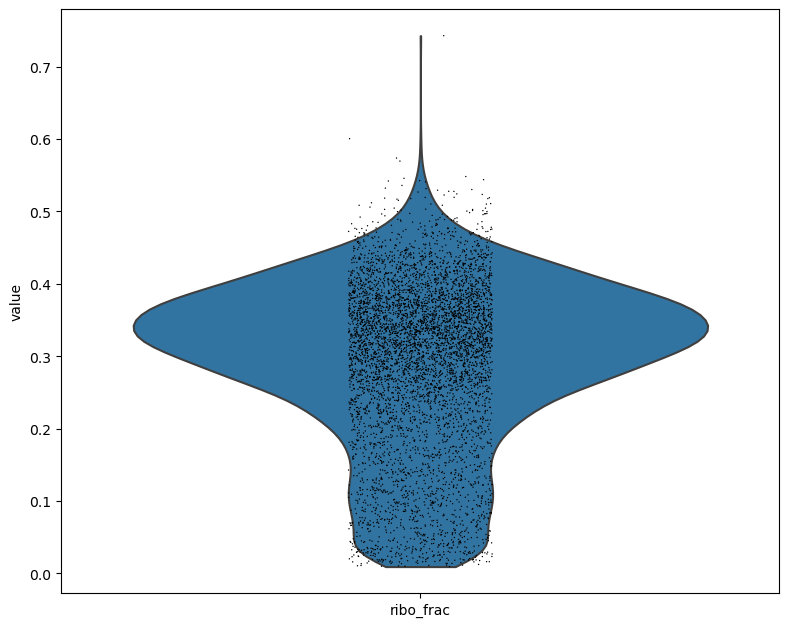

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


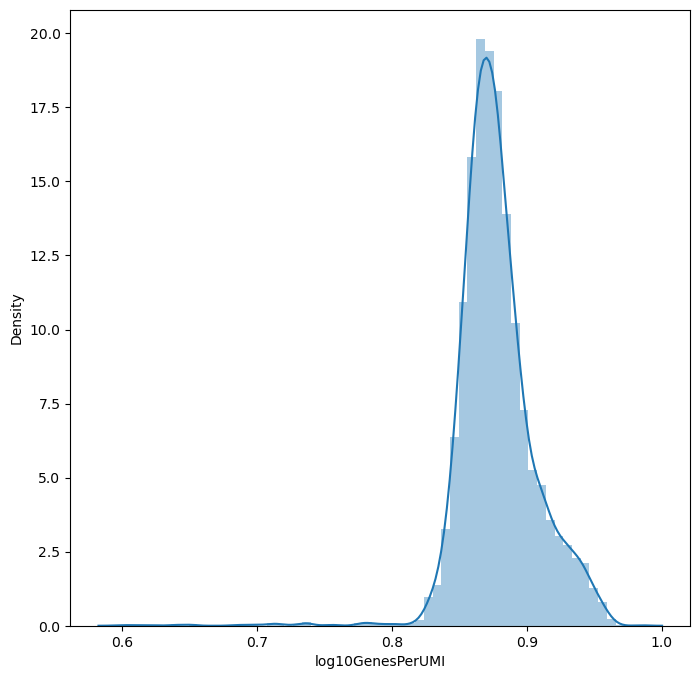

In [8]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata1, 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata1, 'mt_frac')
t3 = sc.pl.violin(adata1, 'ribo_frac')
t4 = sns.distplot(adata1.obs['log10GenesPerUMI'],bins = 60)

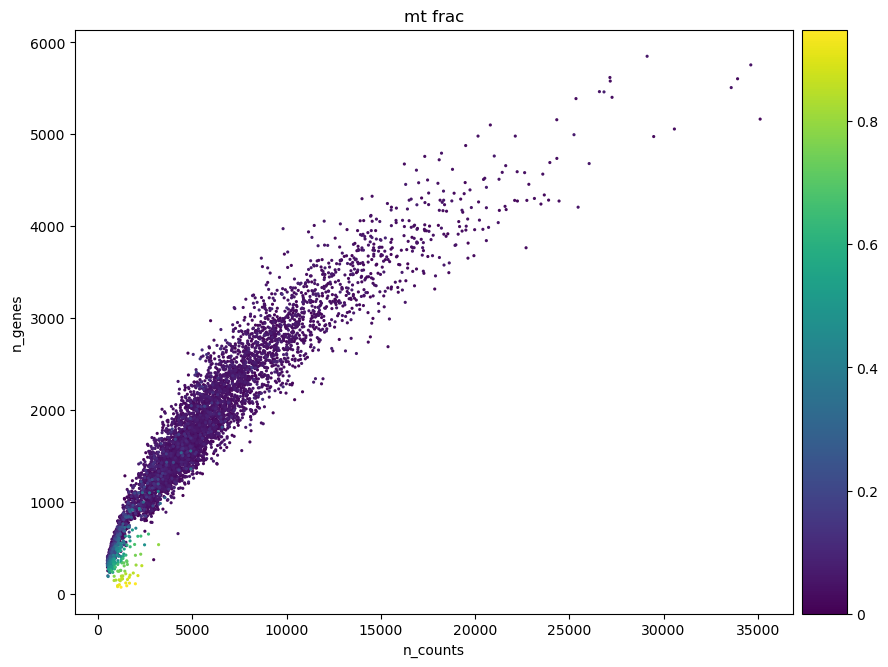

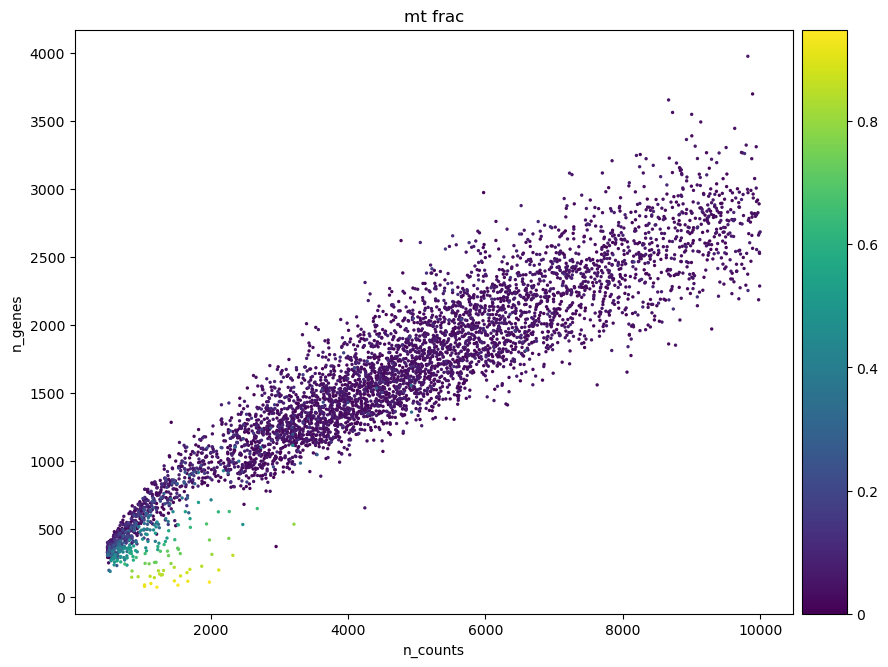

In [9]:
#Data quality summary plots
p1 = sc.pl.scatter(adata1, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata1[adata1.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


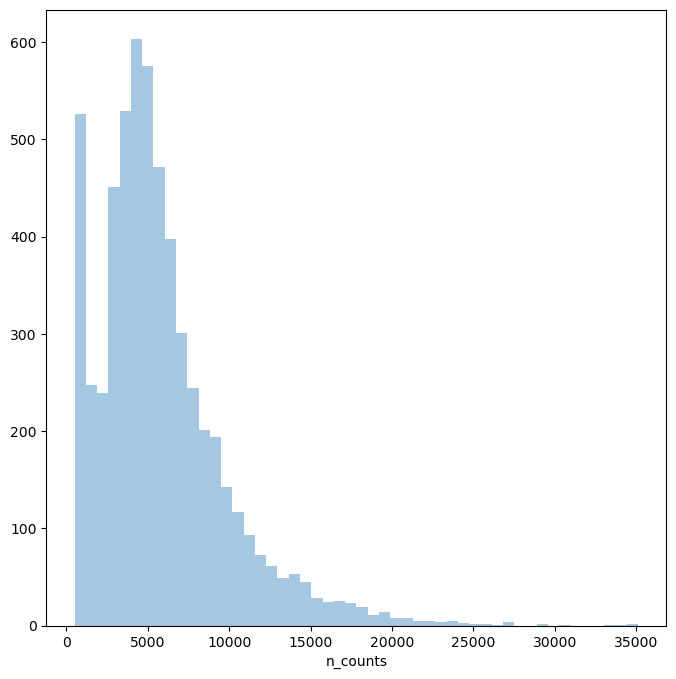

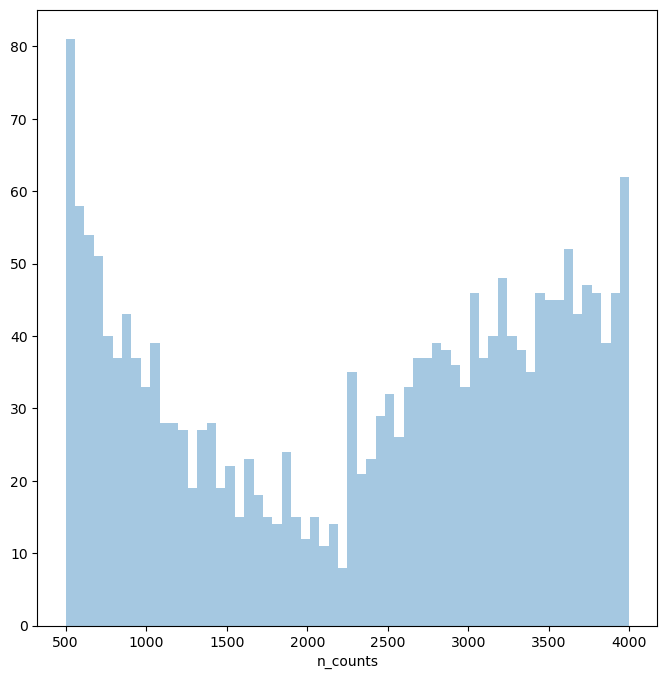

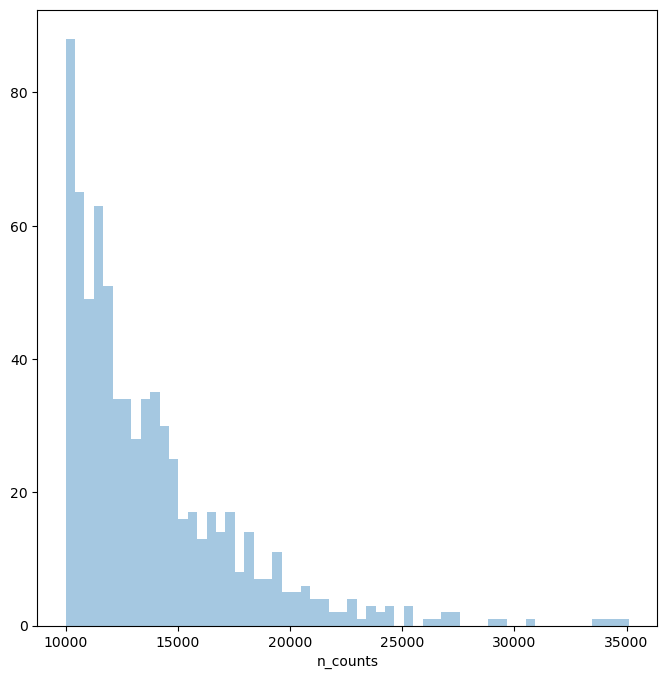

In [10]:
#Thresholding decision: counts
p3 = sns.distplot(adata1.obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata1.obs['n_counts'][adata1.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

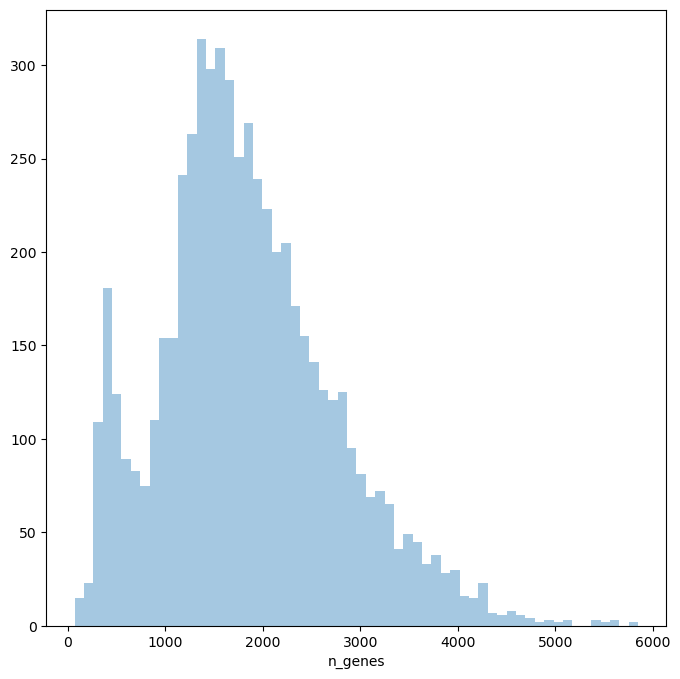

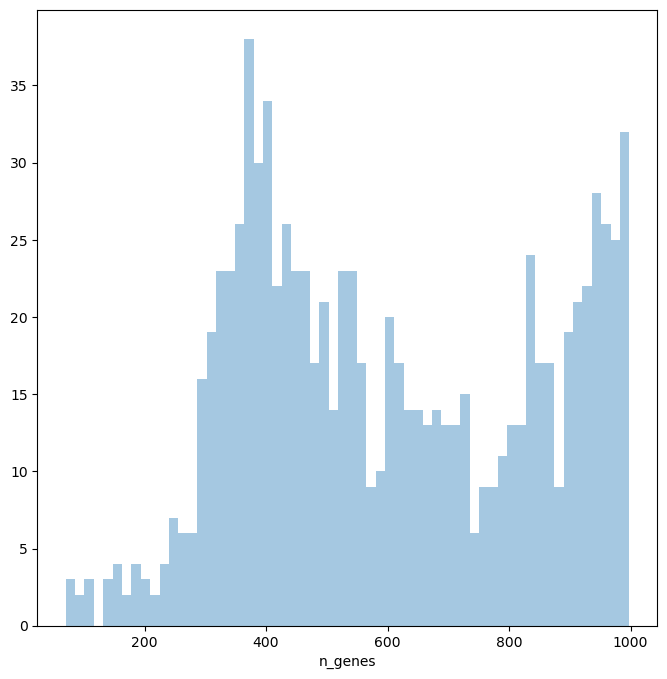

In [11]:
#Thresholding decision: genes
p6 = sns.distplot(adata1.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata1.obs['n_genes'][adata1.obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [12]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata1.n_obs))

sc.pp.filter_cells(adata1, min_counts = 2250)
print('Number of cells after min count filter: {:d}'.format(adata1.n_obs))

#sc.pp.filter_cells(adata1, max_counts = 15000)
#print('Number of cells after max count filter: {:d}'.format(adata1.n_obs))

adata1 = adata1[adata1.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata1.n_obs))

adata1 = adata1[adata1.obs['ribo_frac'] > 0.05]
print('Number of cells after ribo filter: {:d}'.format(adata1.n_obs))

sc.pp.filter_cells(adata1, min_genes = 770)
print('Number of cells after gene filter: {:d}'.format(adata1.n_obs))

#adata1 = adata1[adata1.obs['log10GenesPerUMI'] > 0.8]
#print('Number of cells after complexity filter: {:d}'.format(adata1.n_obs))

Total number of cells: 5811
filtered out 855 cells that have less than 2250 counts
Number of cells after min count filter: 4956
Number of cells after MT filter: 4932
Number of cells after ribo filter: 4912
filtered out 3 cells that have less than 770 genes expressed
Number of cells after gene filter: 4909
Number of cells after complexity filter: 4909


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


### Dataset2 Filtering

In [13]:
# Quality control - calculate QC covariates
adata2.obs['n_counts'] = adata2.X.sum(1)
adata2.obs['log_counts'] = np.log(adata2.obs['n_counts'])
adata2.obs['n_genes'] = (adata2.X > 0).sum(1)

mt_gene_mask = [gene.startswith('MT-') for gene in adata2.var_names]
adata2.obs['mt_frac'] = np.array(adata2.X[:, mt_gene_mask].sum(1).ravel())[0]/adata2.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata2.var_names]
adata2.obs['ribo_frac'] = np.array(adata2.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata2.obs['n_counts']
adata2.obs['log10GenesPerUMI'] = np.log10(adata2.obs['n_genes'])/np.log10(adata2.obs['n_counts'])

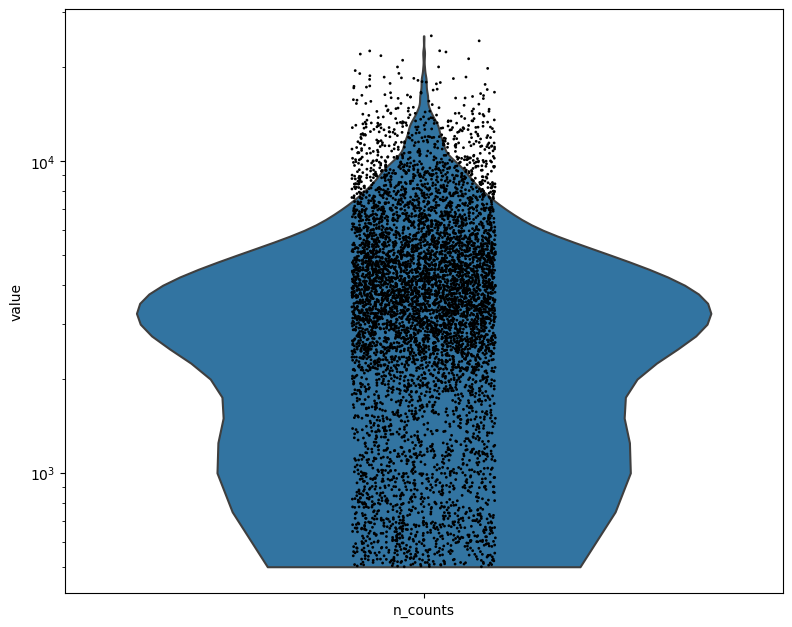

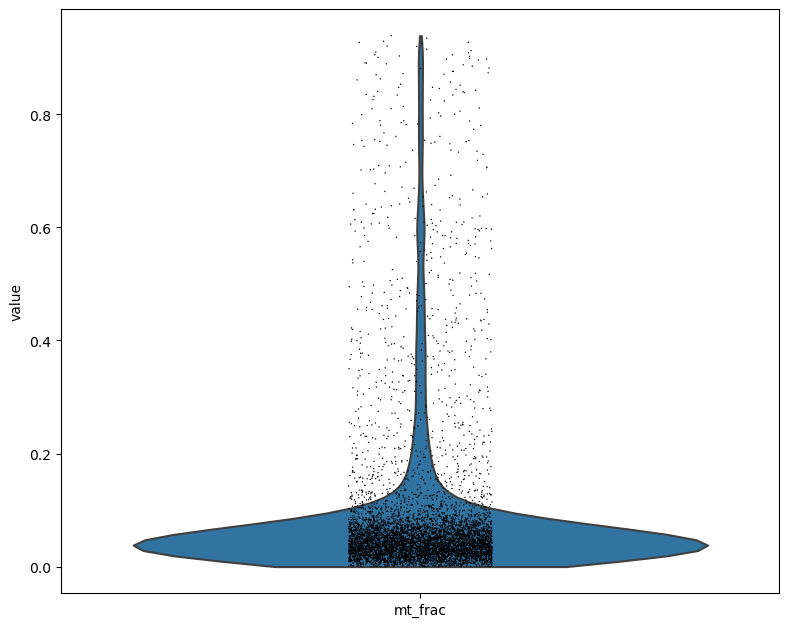

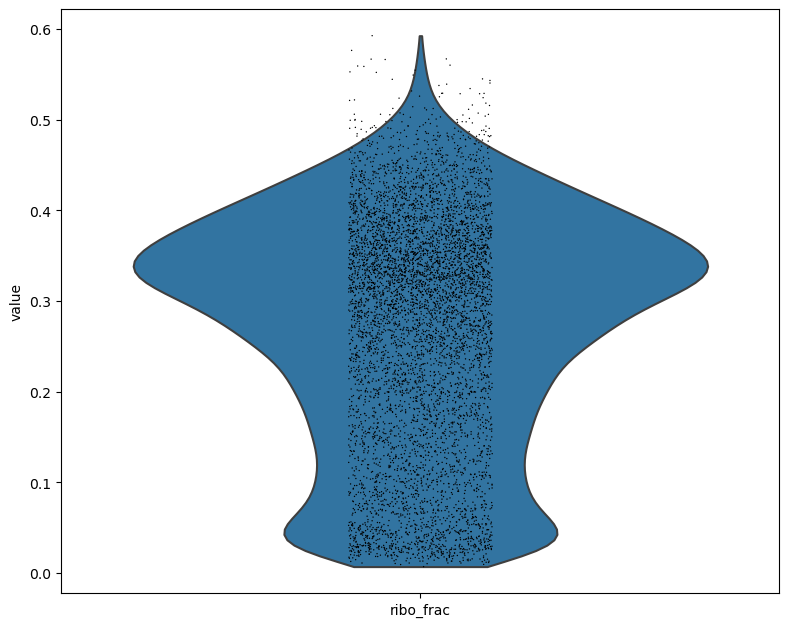

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


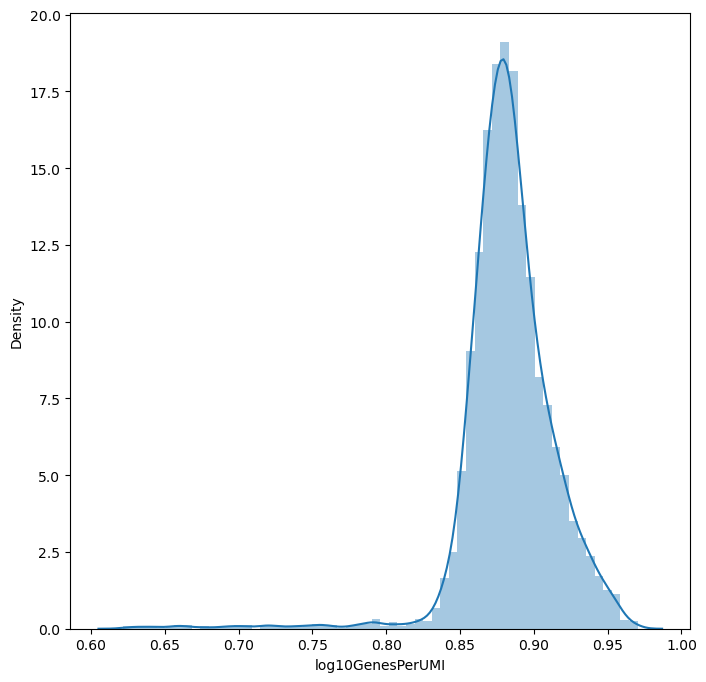

In [14]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata2, 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata2, 'mt_frac')
t3 = sc.pl.violin(adata2, 'ribo_frac')
t4 = sns.distplot(adata2.obs['log10GenesPerUMI'],bins = 60)

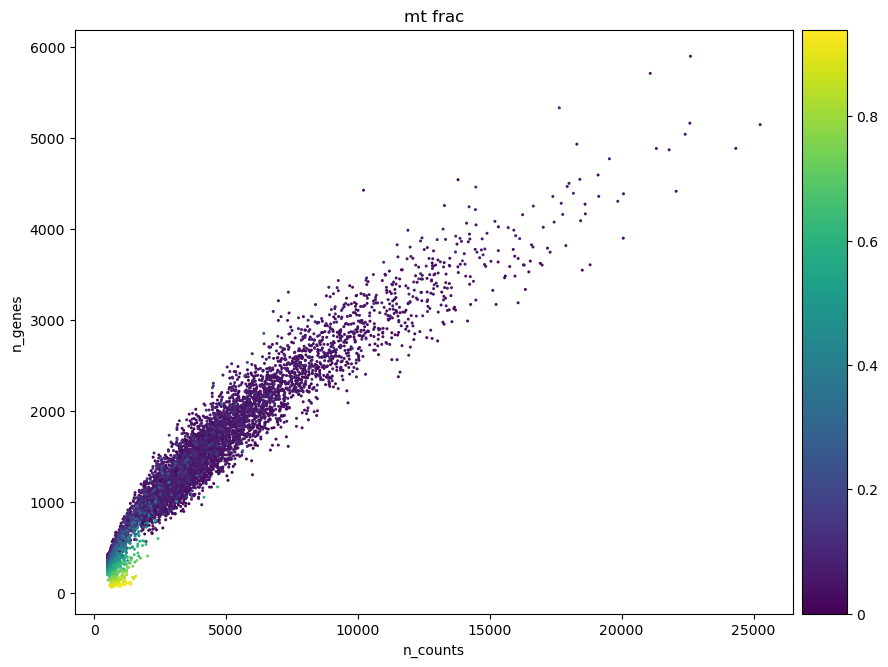

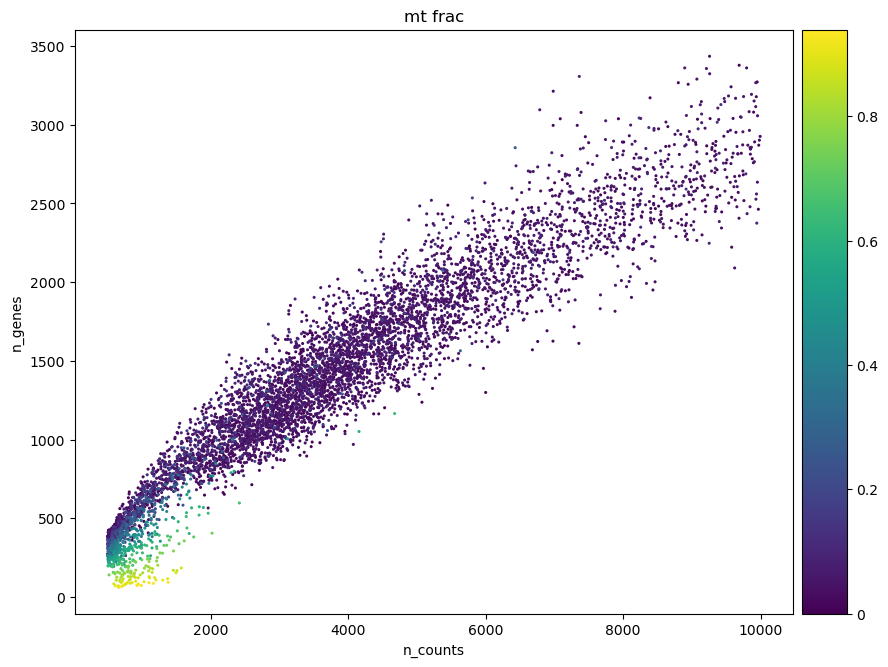

In [15]:
#Data quality summary plots
p1 = sc.pl.scatter(adata2, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata2[adata2.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


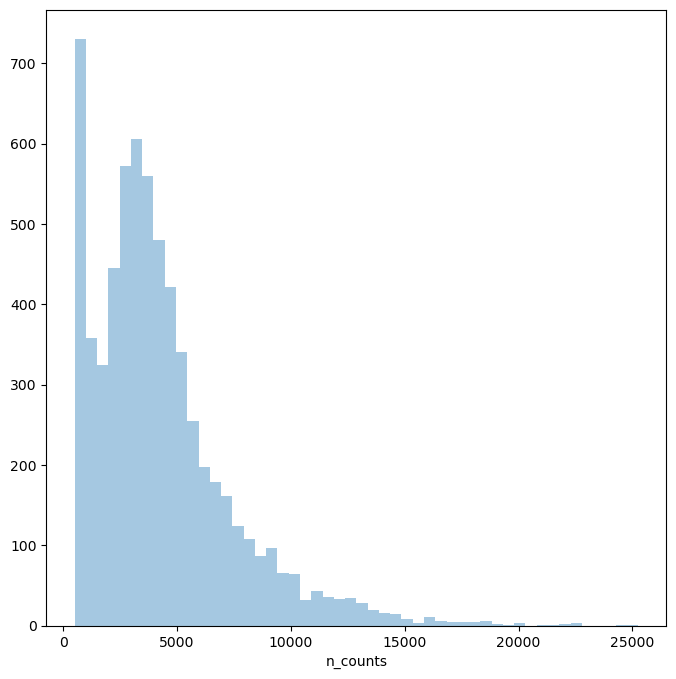

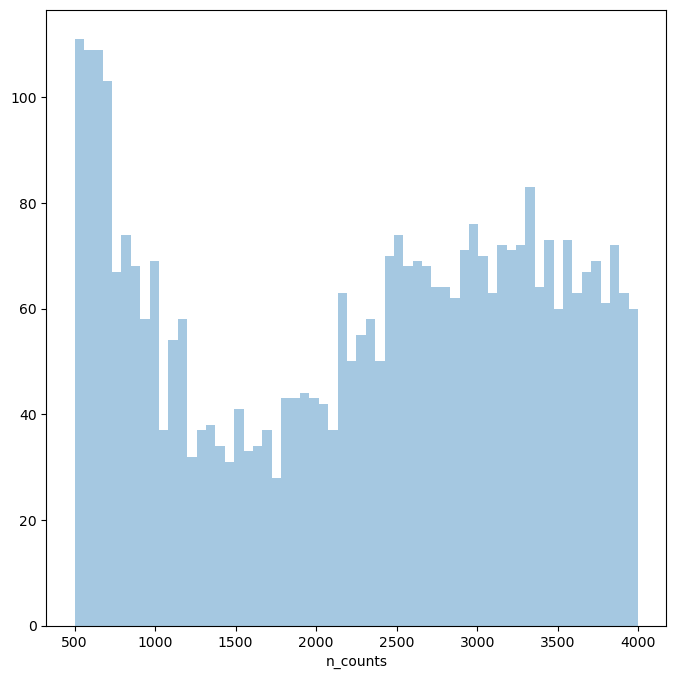

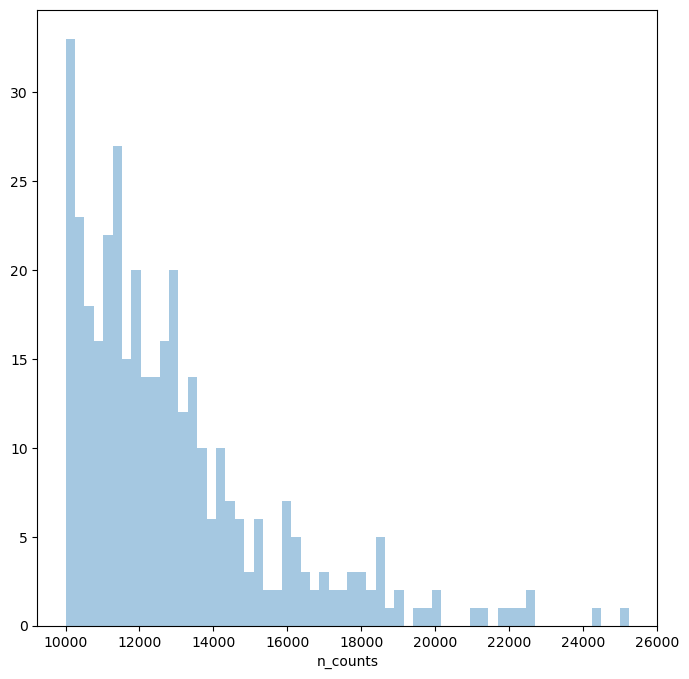

In [16]:
#Thresholding decision: counts
p3 = sns.distplot(adata2.obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata2.obs['n_counts'][adata2.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata2.obs['n_counts'][adata2.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

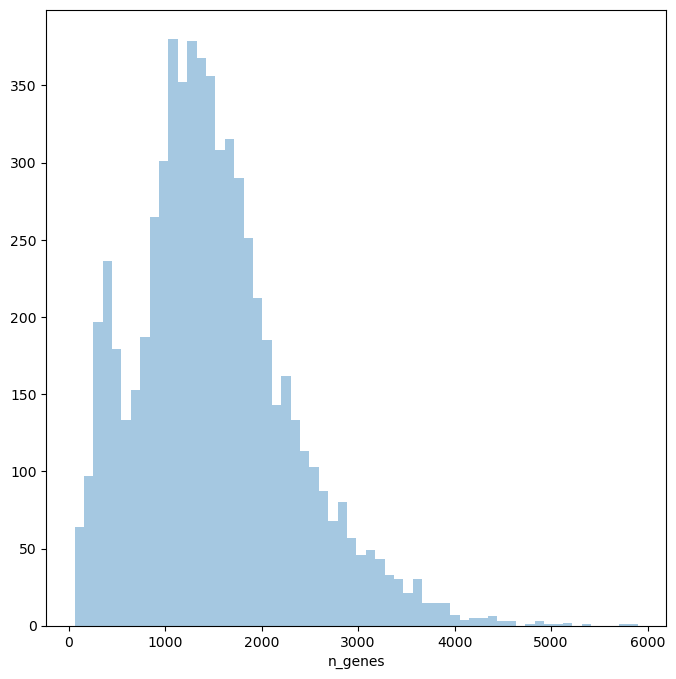

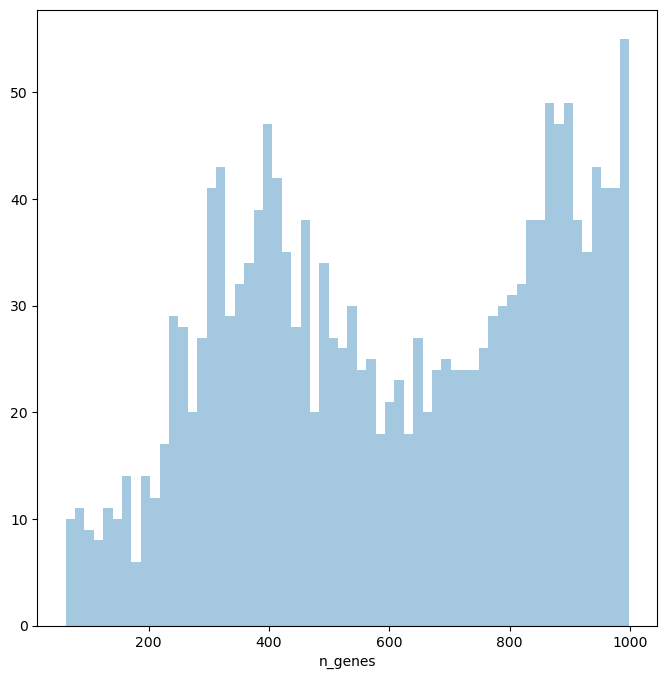

In [17]:
#Thresholding decision: genes
p6 = sns.distplot(adata2.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata2.obs['n_genes'][adata2.obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [18]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata2.n_obs))

sc.pp.filter_cells(adata2, min_counts = 1500)
print('Number of cells after min count filter: {:d}'.format(adata2.n_obs))

#sc.pp.filter_cells(adata2, max_counts = 15000)
#print('Number of cells after max count filter: {:d}'.format(adata2.n_obs))

adata2 = adata2[adata2.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata2.n_obs))

adata2 = adata2[adata2.obs['ribo_frac'] > 0.05]
print('Number of cells after ribo filter: {:d}'.format(adata2.n_obs))

sc.pp.filter_cells(adata2, min_genes = 700)
print('Number of cells after gene filter: {:d}'.format(adata2.n_obs))

#adata2 = adata2[adata2.obs['log10GenesPerUMI'] > 0.8]

print('Number of cells after complexity filter: {:d}'.format(adata2.n_obs))

Total number of cells: 6495
filtered out 1095 cells that have less than 1500 counts
Number of cells after min count filter: 5400
Number of cells after MT filter: 5320
Number of cells after ribo filter: 5252
filtered out 9 cells that have less than 700 genes expressed
Number of cells after gene filter: 5243
Number of cells after complexity filter: 5243


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


### Dataset3 Filtering

In [19]:
# Quality control - calculate QC covariates
adata3.obs['n_counts'] = adata3.X.sum(1)
adata3.obs['log_counts'] = np.log(adata3.obs['n_counts'])
adata3.obs['n_genes'] = (adata3.X > 0).sum(1)
adata3.obs['log10GenesPerUMI'] = np.log10(adata3.obs['n_genes'])/np.log10(adata3.obs['n_counts'])

mt_gene_mask = [gene.startswith('MT-') for gene in adata3.var_names]
adata3.obs['mt_frac'] = np.array(adata3.X[:, mt_gene_mask].sum(1).ravel())[0]/adata3.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata3.var_names]
adata3.obs['ribo_frac'] = np.array(adata3.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata3.obs['n_counts']

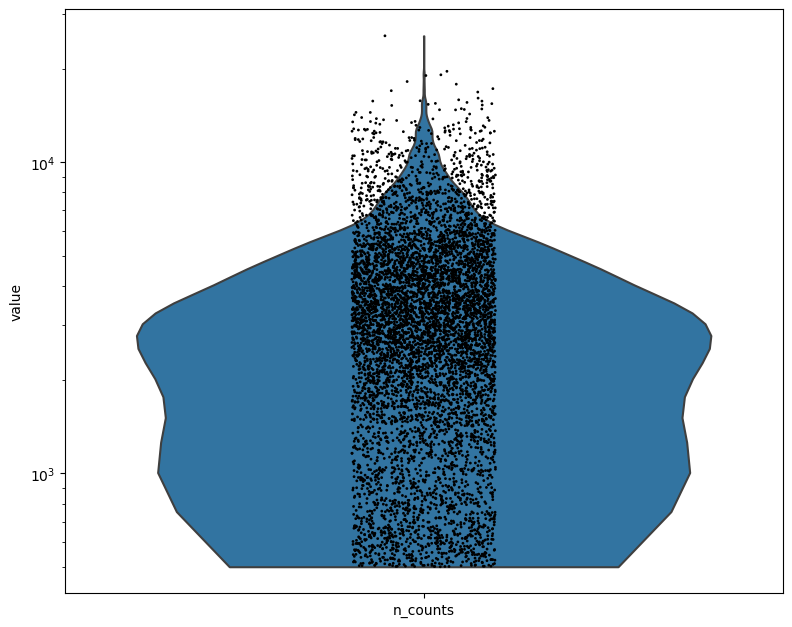

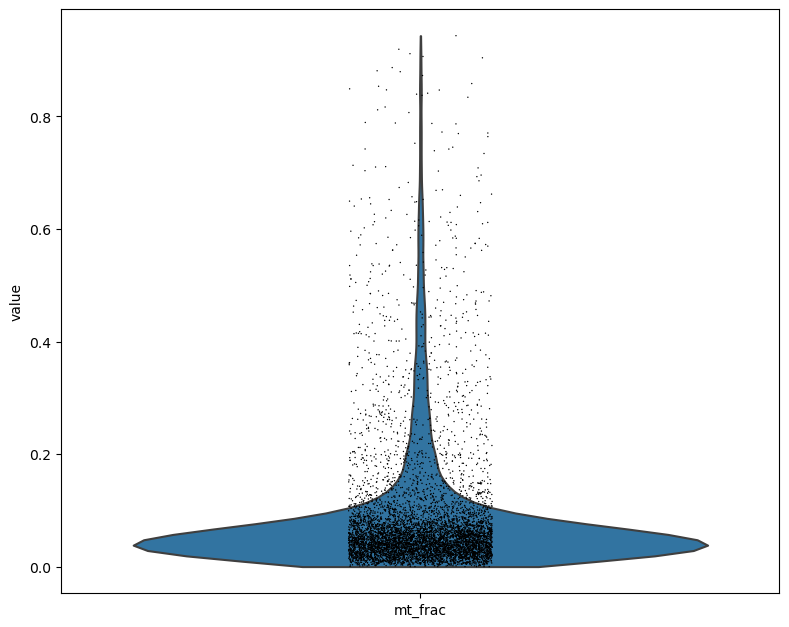

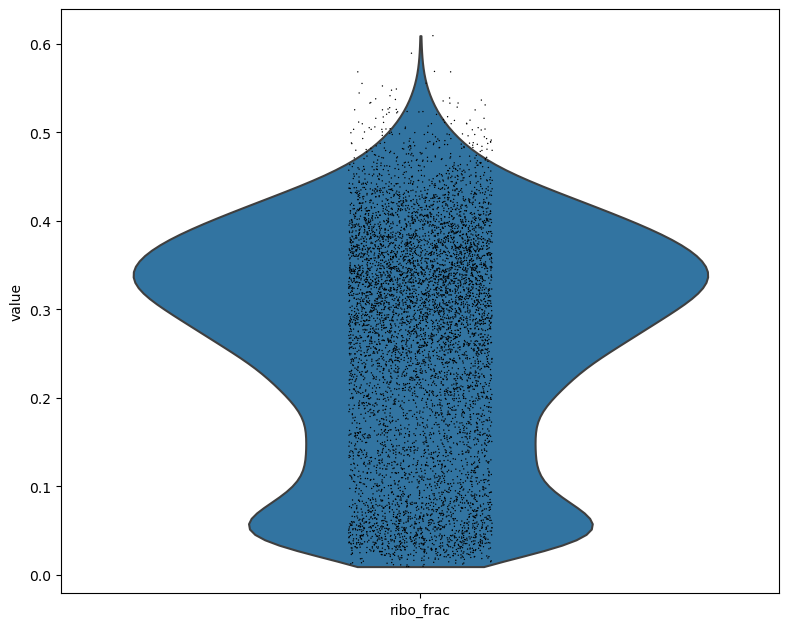

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


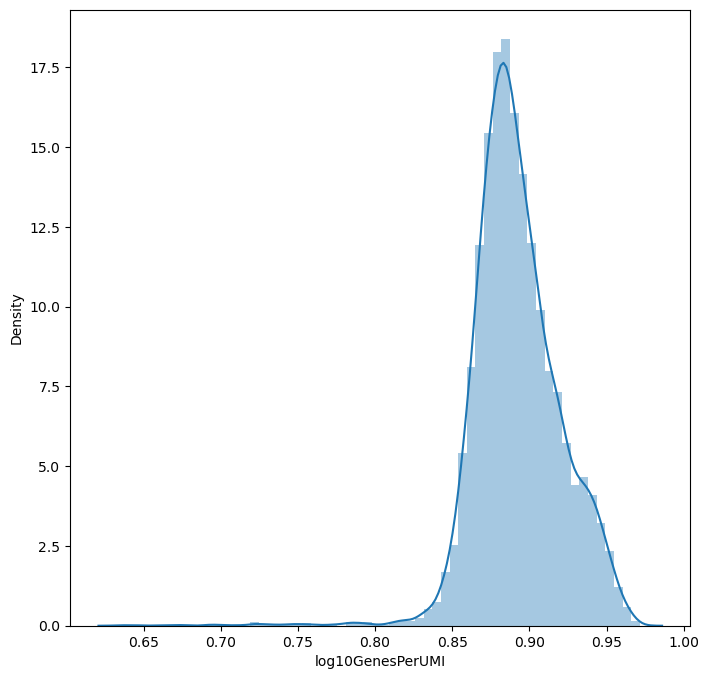

In [20]:
# Quality control - plot QC metrics
t1 = sc.pl.violin(adata3, 'n_counts', size=2, log=True, cut=0)
t2 = sc.pl.violin(adata3, 'mt_frac')
t3 = sc.pl.violin(adata3, 'ribo_frac')
t4 = sns.distplot(adata3.obs['log10GenesPerUMI'],bins = 60)

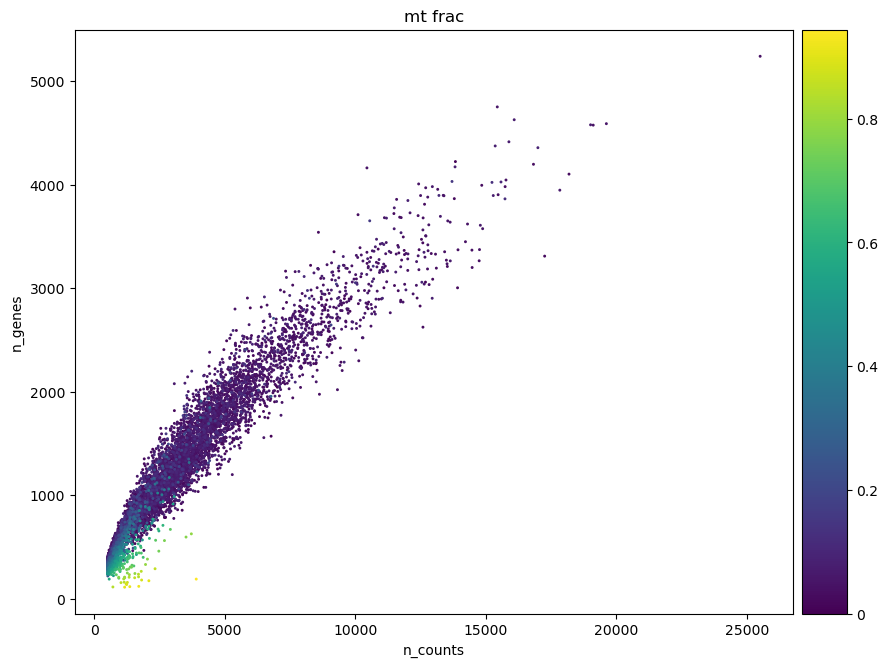

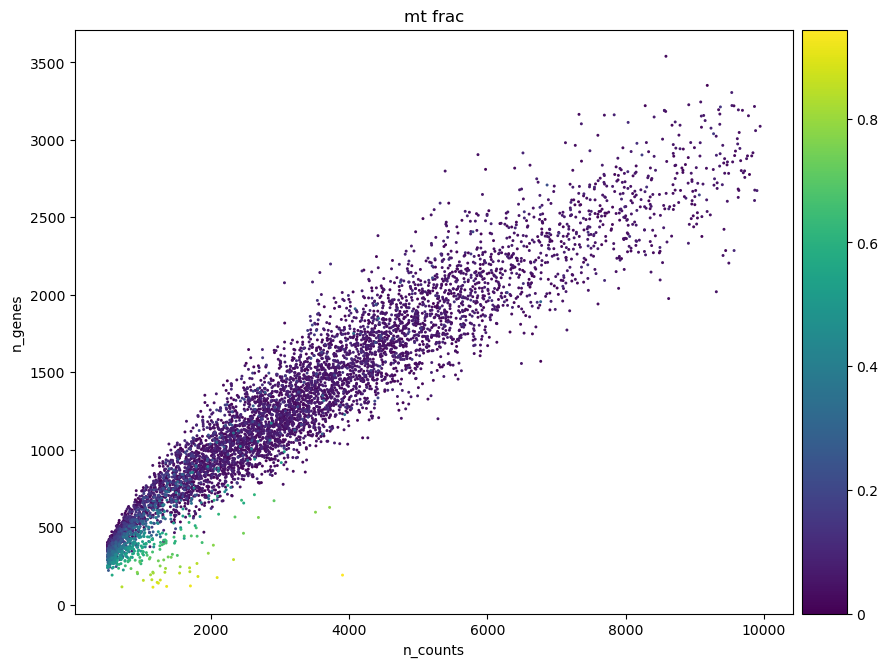

In [21]:
#Data quality summary plots
p1 = sc.pl.scatter(adata3, 'n_counts', 'n_genes', color='mt_frac')
p2 = sc.pl.scatter(adata3[adata3.obs['n_counts']<10000], 'n_counts', 'n_genes', color='mt_frac')

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\seaborn\distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


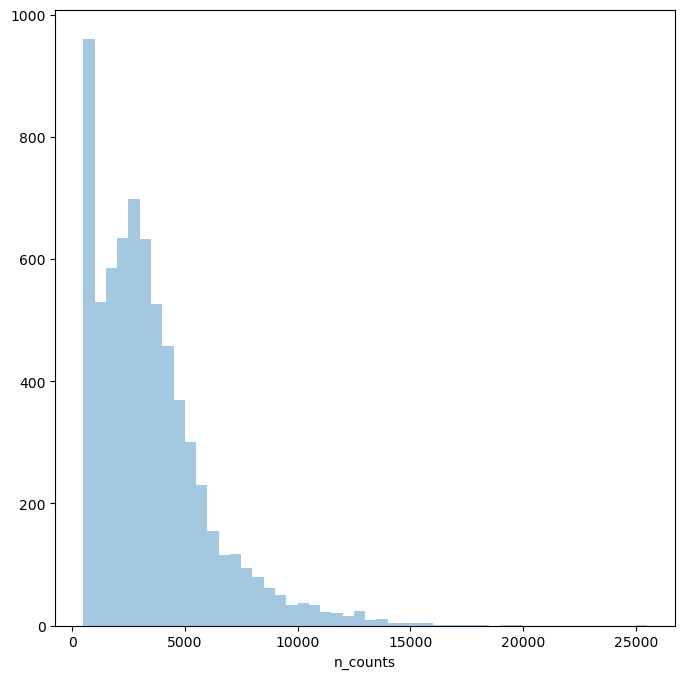

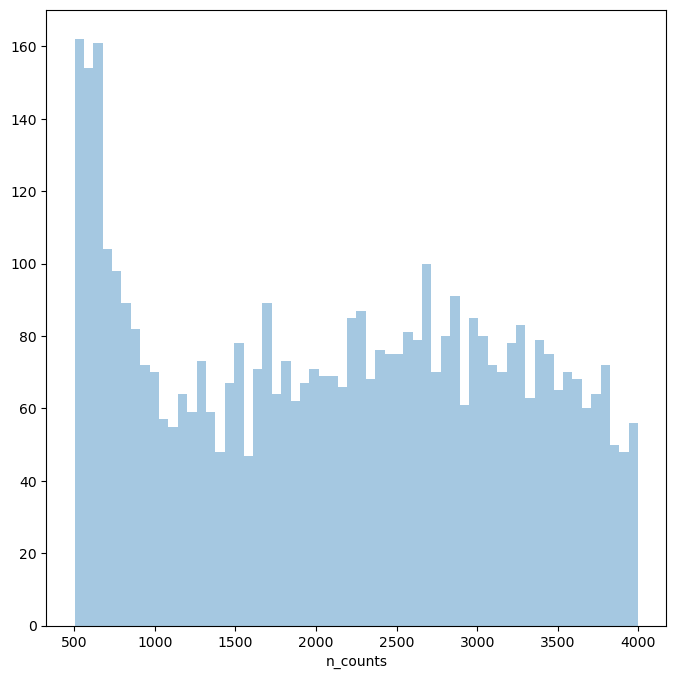

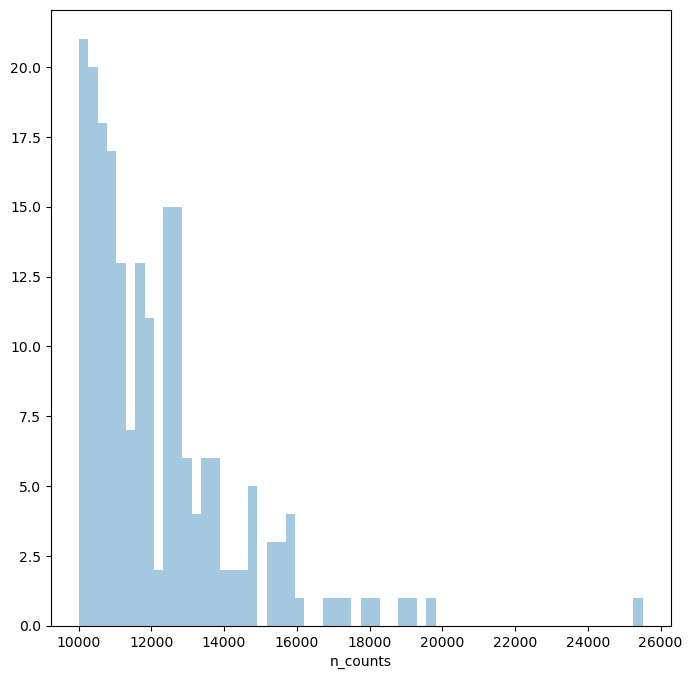

In [22]:
#Thresholding decision: counts
p3 = sns.distplot(adata3.obs['n_counts'], kde=False)
plt.show()

p4 = sns.distplot(adata3.obs['n_counts'][adata3.obs['n_counts']<4000], kde=False, bins=60)
plt.show()

p5 = sns.distplot(adata3.obs['n_counts'][adata3.obs['n_counts']>10000], kde=False, bins=60)
plt.show()

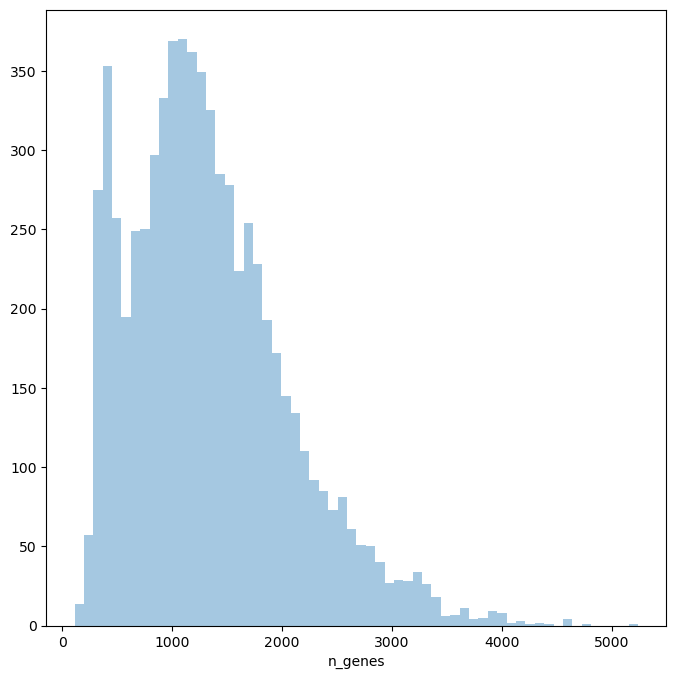

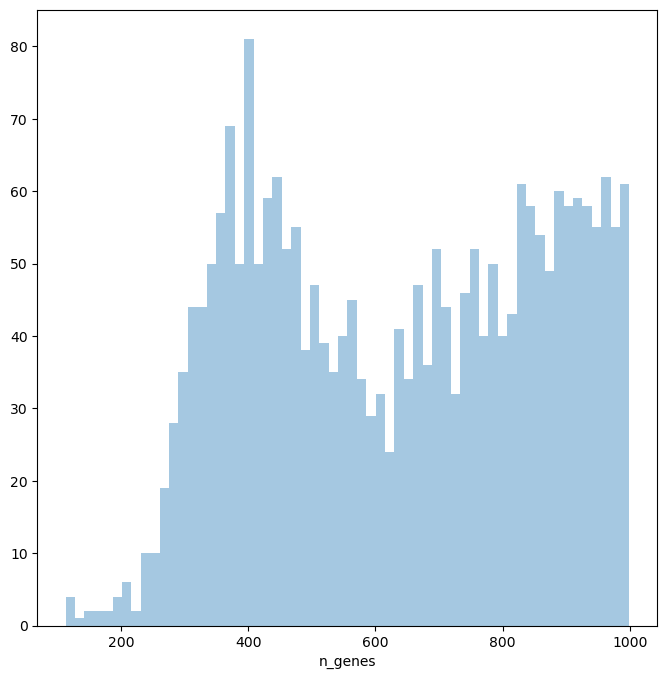

In [23]:
#Thresholding decision: genes
p6 = sns.distplot(adata3.obs['n_genes'], kde=False, bins=60)
plt.show()

p7 = sns.distplot(adata3.obs['n_genes'][adata3.obs['n_genes']<1000], kde=False, bins=60)
plt.show()

In [24]:
# Filter cells according to identified QC thresholds:
print('Total number of cells: {:d}'.format(adata3.n_obs))

sc.pp.filter_cells(adata3, min_counts = 1500)
print('Number of cells after min count filter: {:d}'.format(adata3.n_obs))

#sc.pp.filter_cells(adata3, max_counts = 14500)
#print('Number of cells after max count filter: {:d}'.format(adata3.n_obs))

adata3 = adata3[adata3.obs['mt_frac'] < 0.2]
print('Number of cells after MT filter: {:d}'.format(adata3.n_obs))

adata3 = adata3[adata3.obs['ribo_frac'] > 0.05]
print('Number of cells after ribo filter: {:d}'.format(adata3.n_obs))

sc.pp.filter_cells(adata3, min_genes = 620)
print('Number of cells after gene filter: {:d}'.format(adata3.n_obs))

adata3 = adata3[adata3.obs['log10GenesPerUMI'] > 0.8]
print('Number of cells after complexity filter: {:d}'.format(adata3.n_obs))

Total number of cells: 6838
filtered out 1487 cells that have less than 1500 counts
Number of cells after min count filter: 5351
Number of cells after MT filter: 5221
Number of cells after ribo filter: 5165
filtered out 14 cells that have less than 620 genes expressed
Number of cells after gene filter: 5151
Number of cells after complexity filter: 5151


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


## Multiplet removal
Scrublet and doubletdetection don't work well. Set threshold manually for each dataset

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.71
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.5%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 17.4%
Elapsed time: 3.6 seconds
Detected doublet rate = 10.0%
Estimated detectable doublet fraction = 55.3%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 18.1%


C:\Users\16220\AppData\Local\Temp\ipykernel_1224\1655152377.py:4: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata1.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

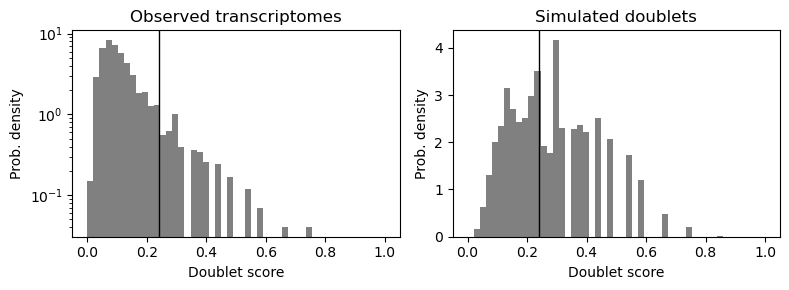

In [25]:
import scrublet as scr
scrub = scr.Scrublet(adata1.X)
scrub.scrub_doublets()
adata1.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)
scrub.plot_histogram()

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.72
Detected doublet rate = 0.0%
Estimated detectable doublet fraction = 1.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 3.9%
Elapsed time: 3.5 seconds
Detected doublet rate = 8.4%
Estimated detectable doublet fraction = 53.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 15.8%


C:\Users\16220\AppData\Local\Temp\ipykernel_1224\156094603.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata2.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

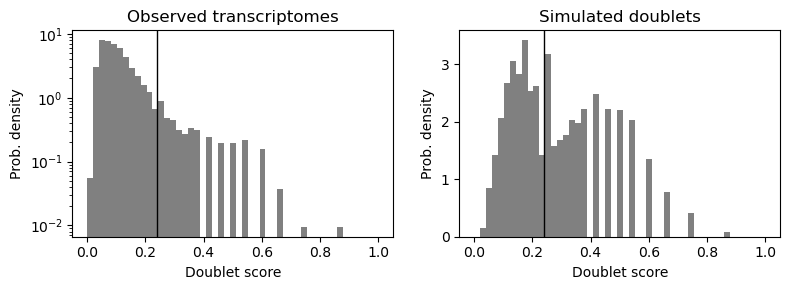

In [26]:
scrub = scr.Scrublet(adata2.X)
scrub.scrub_doublets()
adata2.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)
scrub.plot_histogram()

Preprocessing...
Simulating doublets...
Embedding transcriptomes using PCA...
Calculating doublet scores...
Automatically set threshold at doublet score = 0.72
Detected doublet rate = 0.1%
Estimated detectable doublet fraction = 0.7%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 8.5%
Elapsed time: 3.3 seconds
Detected doublet rate = 11.5%
Estimated detectable doublet fraction = 57.0%
Overall doublet rate:
	Expected   = 10.0%
	Estimated  = 20.1%


C:\Users\16220\AppData\Local\Temp\ipykernel_1224\1001343784.py:3: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata3.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)


(<Figure size 800x300 with 2 Axes>,
 array([<AxesSubplot:title={'center':'Observed transcriptomes'}, xlabel='Doublet score', ylabel='Prob. density'>,
        <AxesSubplot:title={'center':'Simulated doublets'}, xlabel='Doublet score', ylabel='Prob. density'>],
       dtype=object))

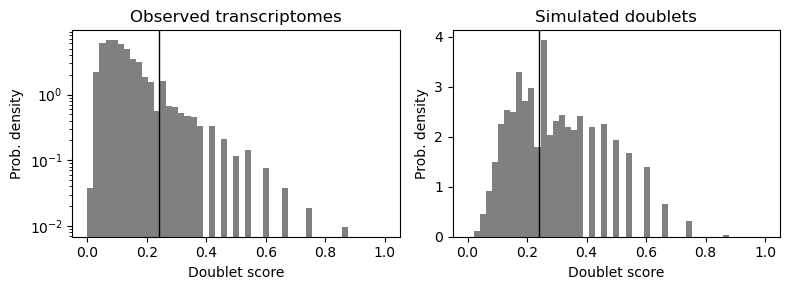

In [27]:
scrub = scr.Scrublet(adata3.X)
scrub.scrub_doublets()
adata3.obs['predicted_doublets'] = scrub.call_doublets(threshold=0.24)
scrub.plot_histogram()

In [28]:
adata1 = adata1[~adata1.obs['predicted_doublets'],:]
adata2 = adata2[~adata2.obs['predicted_doublets'],:]
adata3 = adata3[~adata3.obs['predicted_doublets'],:]

## Ignore genes that are not actively expressed

In [29]:
sc.pp.filter_genes(adata1, min_cells = 5)
sc.pp.filter_genes(adata2, min_cells = 5)
sc.pp.filter_genes(adata3, min_cells = 5)

filtered out 16396 genes that are detected in less than 5 cells
filtered out 16553 genes that are detected in less than 5 cells


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number
C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


filtered out 16932 genes that are detected in less than 5 cells


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\preprocessing\_simple.py:251: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  adata.var['n_cells'] = number


Here, concatenate the three datasets into adata_concat

In [30]:
adata_concat = adata1.concatenate(adata2,adata3, batch_categories=['control_1', 'control_2','treated'])

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\anndata\_core\anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


In [31]:
adata_concat.layers['raw_filtered'] = adata_concat.X

In [32]:
adata_concat.obs['n_counts'] = adata_concat.X.sum(1)
adata_concat.obs['log_counts'] = np.log(adata_concat.obs['n_counts'])
adata_concat.obs['n_genes'] = (adata_concat.X > 0).sum(1)
adata_concat.obs['log10GenesPerUMI'] = np.log10(adata_concat.obs['n_genes'])/np.log10(adata_concat.obs['n_counts'])

mt_gene_mask = [gene.startswith('MT-') for gene in adata_concat.var_names]
adata_concat.obs['mt_frac'] = np.array(adata_concat.X[:, mt_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata_concat.var_names]
adata_concat.obs['ribo_frac'] = np.array(adata_concat.X[:, ribo_gene_mask].sum(1).ravel())[0]/adata_concat.obs['n_counts']

## Calculate cell cycle score before normalization

### Normalization and log transformation

In [33]:
adata_forcycle = adata_concat.copy()
sc.pp.normalize_total(adata_forcycle, key_added = 'normalization_factors')
sc.pp.log1p(adata_forcycle)

normalizing counts per cell
    finished (0:00:00)


### Find HVG and proceed to dimesion reduction PCA + UMAP

In [34]:
sc.pp.highly_variable_genes(adata_forcycle, flavor='seurat', n_top_genes=1000)
print('\n','Number of highly variable genes: {:d}'.format(np.sum(adata_forcycle.var['highly_variable'])))

If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)

 Number of highly variable genes: 1000


In [35]:
sc.pp.pca(adata_forcycle, n_comps=50, use_highly_variable=True, svd_solver='arpack')
sc.pp.neighbors(adata_forcycle, n_neighbors = 15, n_pcs = 50)

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:20)


In [36]:
sc.tl.umap(adata_forcycle, min_dist = 0.4, spread = 1.2)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


### Visualiaze different conditions, the batch effect is negligible

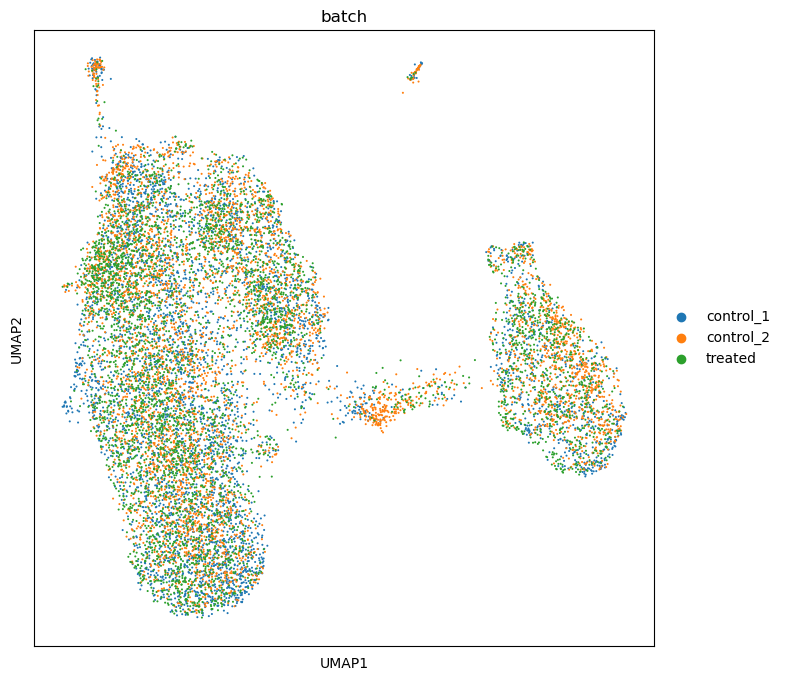

In [37]:
sc.pl.umap(adata_forcycle, color='batch')

### Use the cell cycle gene list summarized by Triosh et al. to calculate the cc score

In [38]:
cc_genes = pd.read_excel('\GSE185224\Triosh_cc.xlsx')

In [39]:
s_genes = cc_genes['G1/S'].dropna()
g2m_genes = cc_genes['G2/M'].dropna()

s_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, s_genes)]
g2m_genes_mm_ens = adata_forcycle.var_names[np.in1d(adata_forcycle.var_names, g2m_genes)]

In [40]:
sc.tl.score_genes_cell_cycle(adata_forcycle, s_genes=s_genes_mm_ens, g2m_genes=g2m_genes_mm_ens)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs).
    752 total control genes are used. (0:00:00)
computing score 'G2M_score'


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\tools\_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


    finished: added
    'G2M_score', score of gene set (adata.obs).
    626 total control genes are used. (0:00:00)
-->     'phase', cell cycle phase (adata.obs)


C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\scanpy\tools\_score_genes.py:151: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  for cut in np.unique(obs_cut.loc[gene_list]):


### Visualize the cell phases of the co-cultured cells

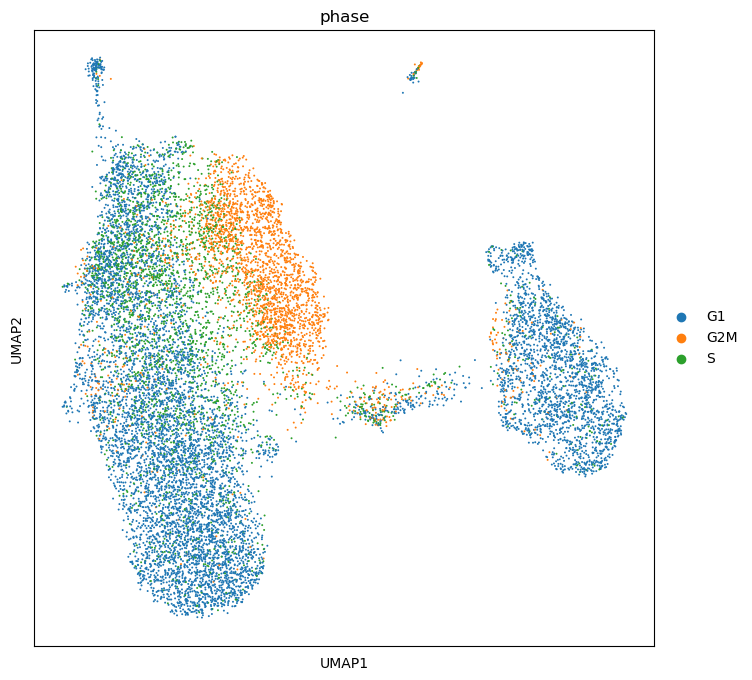

In [41]:
sc.pl.umap(adata_forcycle, color='phase',size = 8)

### Export the result to input it into the Seurat

In [42]:
Sscore = adata_forcycle.obs['S_score'].values.tolist()
G2Mscore = adata_forcycle.obs['G2M_score'].values.tolist()
S_G2M_diff = adata_forcycle.obs['S_score'] - adata_forcycle.obs['G2M_score']
S_G2M_diff = S_G2M_diff.values.tolist()

### Perform basic leiden clustering and compare the mito/ribo fractions among clusters

running Leiden clustering
    finished: found 10 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


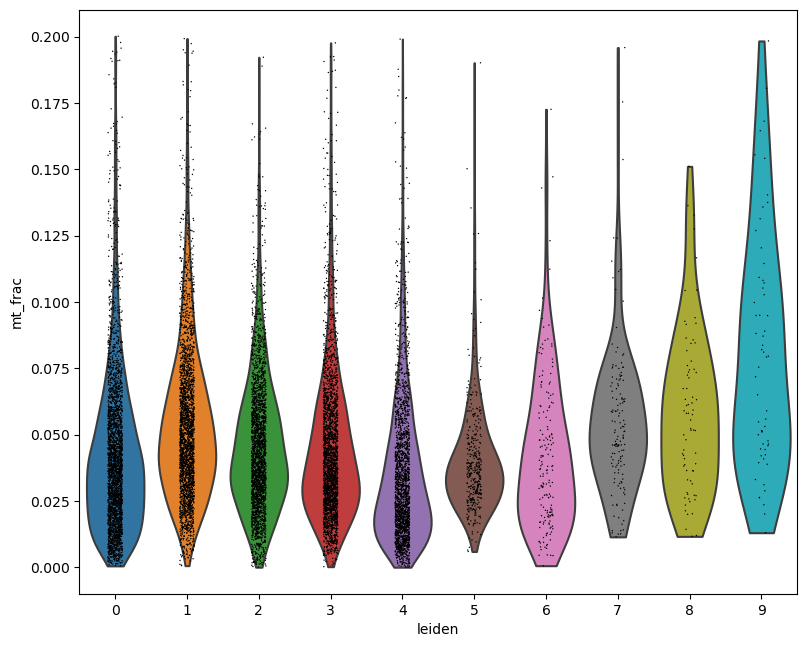

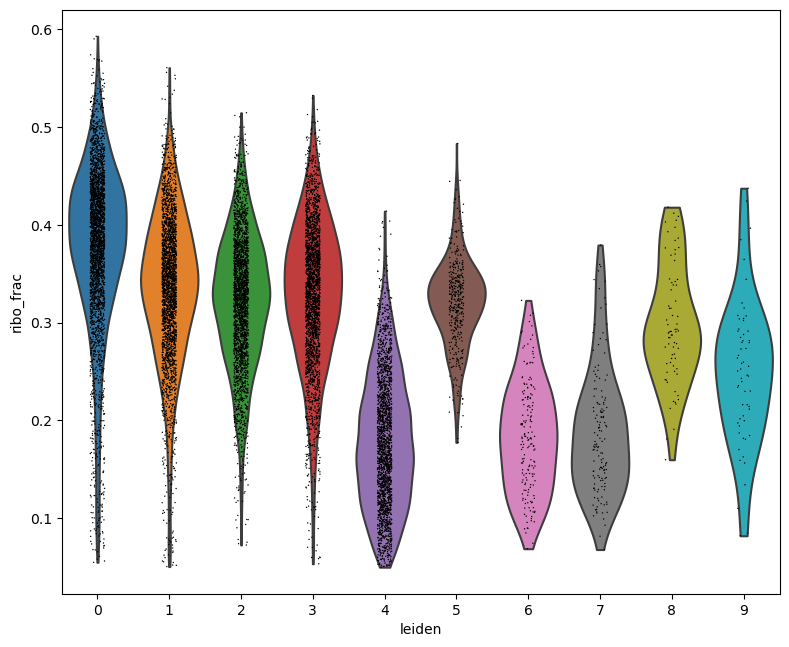

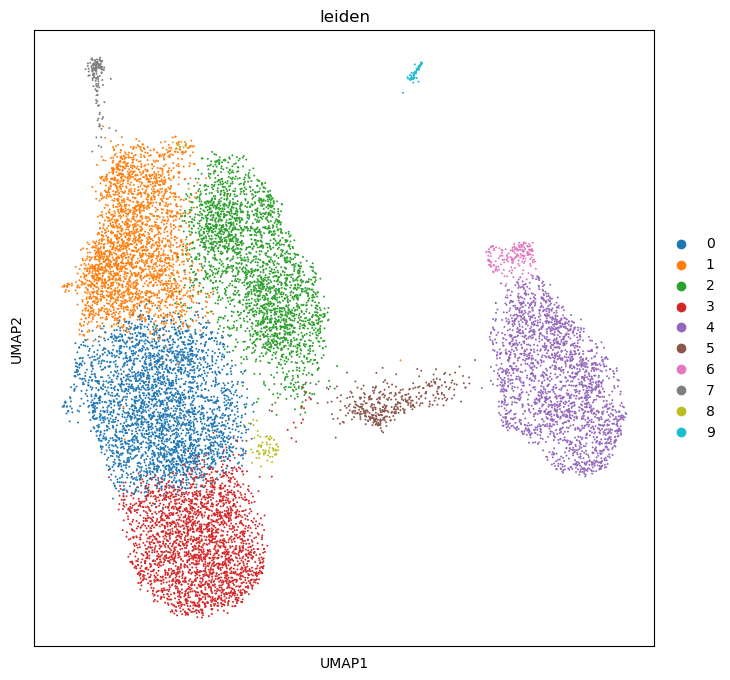

In [43]:
sc.tl.leiden(adata_forcycle, resolution = 0.6, key_added= 'leiden')
t1 = sc.pl.violin(adata_forcycle, 'mt_frac', groupby = 'leiden')
t2 = sc.pl.violin(adata_forcycle, 'ribo_frac', groupby = 'leiden')
t3 = sc.pl.umap(adata_forcycle, color='leiden',size = 8)

## SCTransform - Normalization and Variance Stablization

In [44]:
adata_concat.uns['allgenes'] = list(adata1.var_names)
adata_concat.obs['S_score'] = adata_forcycle.obs['S_score']
adata_concat.obs['G2M_score'] = adata_forcycle.obs['G2M_score']
adata_concat.obs['S_G2M_diff'] = adata_concat.obs['S_score'] - adata_concat.obs['G2M_score']
adata_concat.obs['phase'] = adata_forcycle.obs['phase']

In [45]:
adata_concat.write('beforetrans_concat.h5ad')

In [36]:
adata_concat = sc.read_h5ad('beforetrans_concat.h5ad') # savepoint 

### Preparations before input things into Seurat

In [29]:
colnames = adata_concat.obs_names
rownames = adata_concat.var_names
condition = adata_concat.obs['batch']
mt_frac = adata_concat.obs['mt_frac']
S_G2M_diff = adata_concat.obs['S_score'] - adata_concat.obs['G2M_score']
S_G2M_diff = S_G2M_diff.values.tolist()

### Construct the Seurat object

In [30]:
%%R -i adata_concat -i colnames -i rownames -i S_G2M_diff -i mt_frac -i condition
counts = adata_concat@assays@data$X
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "transwell", min.cells = 0, min.features = 0, assay = "RNA")

srat[["S_G2M_diff"]] = S_G2M_diff
srat[["cond"]] = condition
srat[["mt_frac"]] = mt_frac

[1] "done"
[1] "done"
[1] "done"


### SCTransform dataset separately

In [31]:
%%R
cond.list = SplitObject(srat, split.by = "cond")
ctrl1 <- cond.list[["control_1"]]
ctrl2 <- cond.list[["control_2"]]
trtd <- cond.list[["treated"]]

ctrl1 = SCTransform(object = ctrl1, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("S_G2M_diff","mt_frac")) #c("G2Mscore","Sscore"))

ctrl1 = RunPCA(ctrl1, verbose = FALSE)

ctrl2 = SCTransform(object = ctrl2, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("S_G2M_diff","mt_frac")) #c("G2Mscore","Sscore"))

ctrl2 = RunPCA(ctrl2, verbose = FALSE)

trtd = SCTransform(object = trtd, verbose = FALSE, vst.flavor = "v2", vars.to.regress = c("S_G2M_diff","mt_frac")) #c("G2Mscore","Sscore"))

trtd = RunPCA(trtd, verbose = FALSE)

[1] "done"
[1] "done"
[1] "done"
[1] "done"
[1] "done"
An object of class Seurat 
32038 features across 4561 samples within 2 assays 
Active assay: SCT (16019 features, 3000 variable features)
 1 other assay present: RNA
[1] "done"


### Find 3000 genes as anchors across 3 datasets. Integrate the data.

In [32]:
%%R
ifnb.list <- list(ctrl1 = ctrl1, ctrl2 = ctrl2, trtd = trtd)
features <- SelectIntegrationFeatures(object.list = ifnb.list, nfeatures = 3000)
ifnb.list <- PrepSCTIntegration(object.list = ifnb.list, anchor.features = features)

mod.anchors <- FindIntegrationAnchors(object.list = ifnb.list, normalization.method = "SCT",
    anchor.features = features)
srat_combined <- IntegrateData(anchorset = mod.anchors, normalization.method = "SCT")

  |                                                  | 0 % ~calculating   |+++++++++++++++++                                 | 33% ~03s           |++++++++++++++++++++++++++++++++++                | 67% ~02s           |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=04s  
  |                                                  | 0 % ~calculating   |+++++++++++++++++                                 | 33% ~03m 17s       |++++++++++++++++++++++++++++++++++                | 67% ~01m 37s       |++++++++++++++++++++++++++++++++++++++++++++++++++| 100% elapsed=05m 00s


### Extract useful info from Seurat and bring it back to jupyter

In [33]:
%%R -o HVG -o varExplained -o PCs -o mat -o adata_transformed -o left_genes

srat_combined = RunPCA(srat_combined,verbose = FALSE)

HVG = VariableFeatures(srat_combined)

mat <- Seurat::GetAssayData(object = srat_combined, slot = 'scale.data')
pca <- srat_combined[["pca"]]

# Get the total variance:
total_variance <- sum(matrixStats::rowVars(mat))

eigValues = (pca@stdev)^2  ## EigenValues
varExplained = eigValues / total_variance

PCs = Loadings(srat_combined, reduction = "pca")

adata_transformed = as.SingleCellExperiment(srat_combined)
left_genes = rownames(x = srat_combined[["SCT"]])

C:\Users\16220\anaconda3\envs\scvi-env\lib\site-packages\anndata2ri\r2py.py:106: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  return AnnData(exprs, obs, var, uns, obsm or None, layers=layers)


In [78]:
%%R -o counts -o logcounts

counts = srat_combined[["SCT"]]@counts
logcounts = srat_combined[["SCT"]]@data

In [224]:
%R -o srat_combined

In [225]:
srat_combined.r("save(my_df, file='{}')".format(filename)) # Try to save the seurat object, but somehow does not work

<rpy2.robjects.methods.RS4 object at 0x000001E0F97DE440> [RTYPES.S4SXP]
R classes: ('Seurat',)

### Transfer the SCTransform result back to python

In [80]:
import anndata
adata = anndata.AnnData(X = logcounts.T)
adata.var_names = left_genes
adata.obs_names = adata_transformed.obs_names
adata.uns['scaled'] = mat.T
adata.layers['counts'] = counts.T
adata.layers['logcounts'] = logcounts.T
adata.obsm['X_pca'] = adata_transformed.obsm['X_pca']
adata.layers['raw'] = adata_concat.X

C:\Users\16220\AppData\Local\Temp\ipykernel_42316\663429006.py:2: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  adata = anndata.AnnData(X = logcounts.T)


In [81]:
adata.varm['PCs'] = np.zeros([np.shape(adata.X.A)[1],50])
for i in range(0,50):
    genename = HVG[i]
    adata.varm['PCs'][adata.var_names == genename,:] = PCs[i,:]

In [83]:
adata.obs['n_counts'] = adata.layers['counts'].sum(1)
adata.obs['n_genes'] = (adata.layers['counts'] > 0).sum(1)
adata.var['highly_variable'] = adata.var_names.isin(HVG)
adata.obs['condition'] = adata_concat.obs['batch']
adata.obs['phase'] = adata_concat.obs['phase']
adata.uns['pca'] = dict({'variance_ratio': varExplained})
adata.obs['condition_general'] = ['control' if reg!='treated' else 'treated' for reg in adata.obs['condition']]

In [84]:
mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
adata.obs['mt_frac'] = np.array(adata.layers['counts'][:, mt_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

In [85]:
ribo_gene_mask = [gene.startswith('RPL') or gene.startswith('RPS') for gene in adata.var_names]
adata.obs['ribo_frac'] = np.array(adata.layers['counts'][:, ribo_gene_mask].sum(1).ravel())[0]/adata.obs['n_counts']

## Proceed the generated adata with PCA + Leiden + UMAP

In [139]:
sc.pp.neighbors(adata, n_pcs = 50)

computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)


running Leiden clustering
    finished: found 16 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)


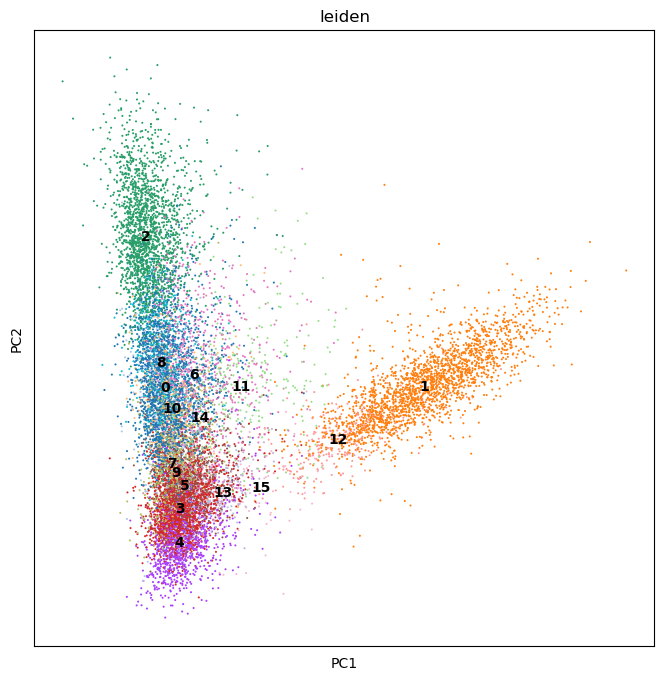

In [140]:
sc.tl.leiden(adata, resolution = 0.65, key_added= 'leiden')
sc.pl.pca(adata, color='leiden', legend_loc = 'on data')

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:00)
--> added 'pos', the PAGA positions (adata.uns['paga'])


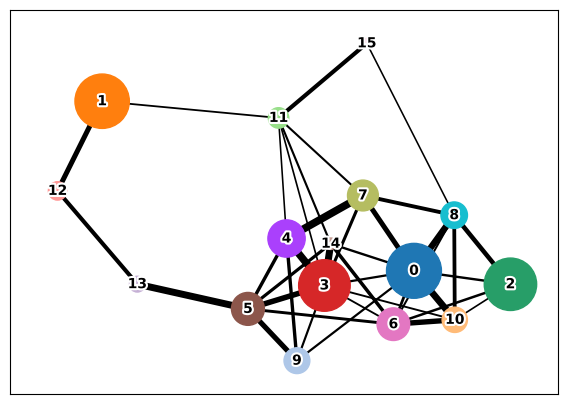

In [286]:
sc.tl.paga(adata, groups='leiden')
sc.pl.paga(adata,threshold = 0.15, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:08)


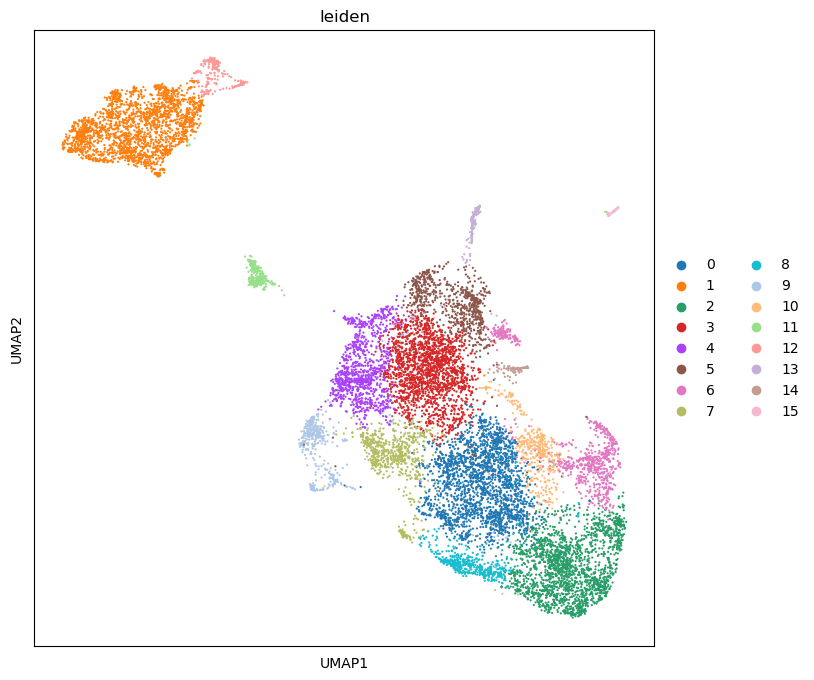

In [61]:
sc.tl.umap(adata, min_dist = 0.1, spread = 1.1,init_pos = 'paga')
sc.pl.umap(adata, color = 'leiden',size = 10)

## Cell cluster identification

### Use prior knowledge (markers) to have a conjecture of the identity of each cluster

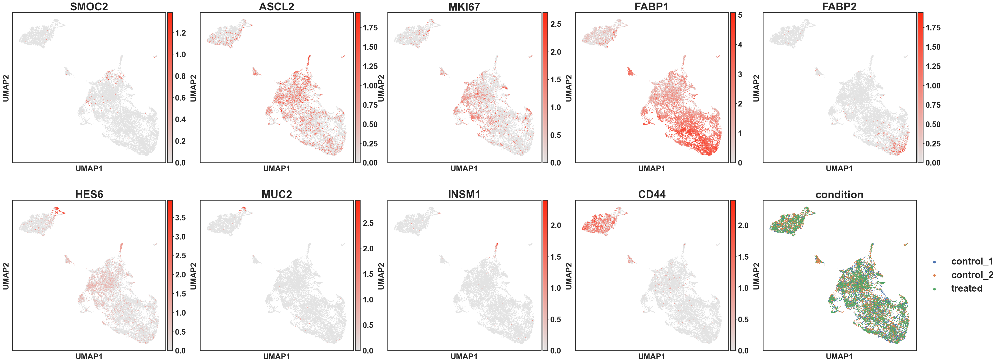

In [368]:
plt.close()
plt.rcParams['axes.linewidth'] = 2
fig = sc.pl.umap(adata, color=['SMOC2', 'ASCL2','MKI67', 'FABP1','FABP2','HES6','MUC2','INSM1','CD44','condition'],size =20, ncols = 5, cmap = my_cmap, return_fig = True, legend_fontsize = 'large')
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('overall_map.png')

Stem

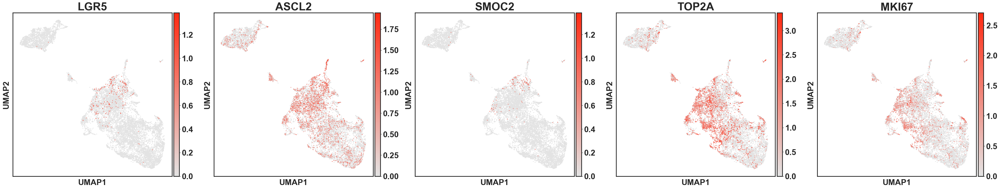

In [372]:
fig = sc.pl.umap(adata, color=['LGR5', 'ASCL2','SMOC2','TOP2A','MKI67'],size =20,ncols = 5,save = "stem_map.png",return_fig = True,cmap = my_cmap,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('stem_map.png')

Cancer Stem

In [ ]:
sc.pl.umap(adata, color=['CD24','CD44','PROM1','BMP4','NANOG','SOX2','POU5F1'],size = 20)

TA

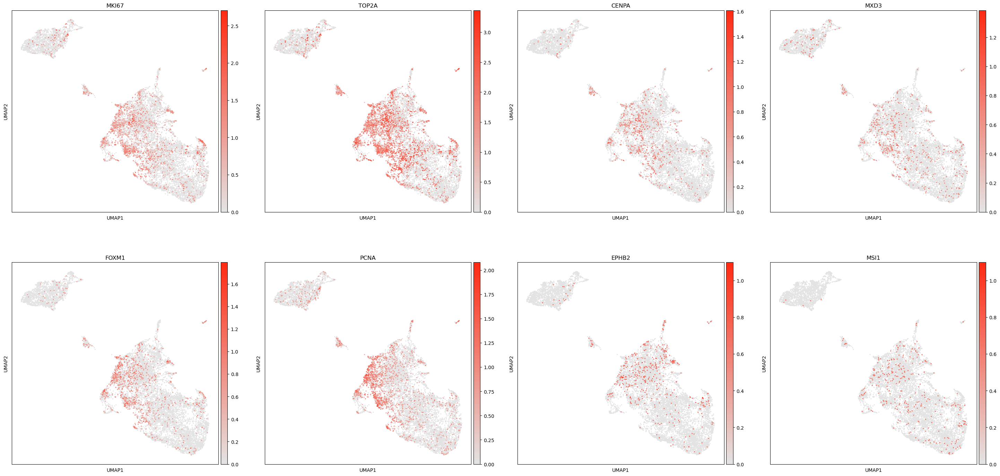

In [124]:
sc.pl.umap(adata, color=['MKI67','TOP2A','CENPA','MXD3','FOXM1','PCNA','EPHB2','MSI1'],size = 20,save = 'TA_map.png',cmap = my_cmap)

Paneth

In [ ]:
sc.pl.umap(adata, color=['LYZ','REG3A','SPIB','ITLN2','PLA2G2A'],size =20)

Sec Prog

In [ ]:
sc.pl.umap(adata, color=['ATOH1','DLL1','INSM1'],size = 20)

Colonocytes

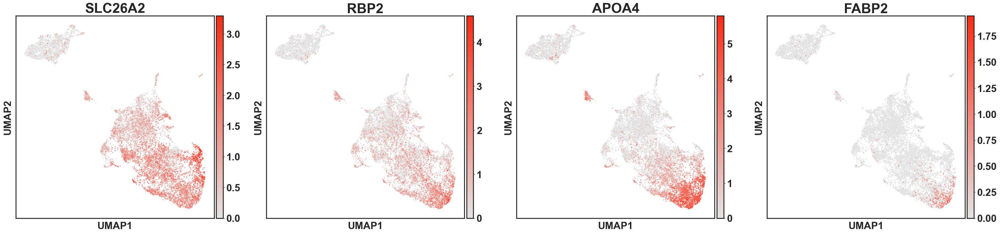

In [381]:
fig = sc.pl.umap(adata, color=['SLC26A2','RBP2','APOA4','FABP2','SLC2A3','AFP'],size = 20,save = 'EC_map.png',cmap = my_cmap,return_fig = True,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('EC_map.png')

SI Enterocytes

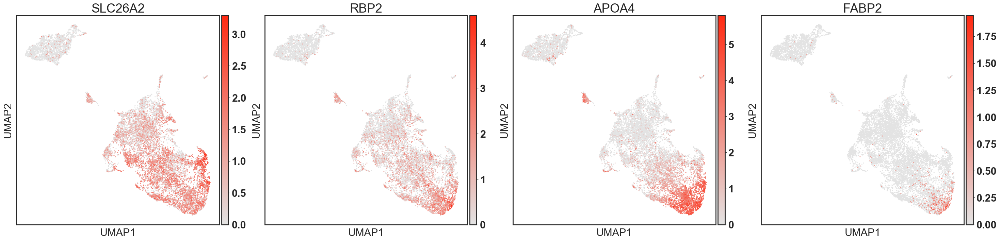

In [377]:
sc.pl.umap(adata, color=['SLC26A2','RBP2','APOA4','FABP2'],size = 20,save = 'EC_map.png',cmap = my_cmap)

GOBLET

In [ ]:
sc.pl.umap(adata, color=['SPDEF', 'FCGBP', 'MEX3A','TFF3'],size = 20)

Tuft - none

In [ ]:
sc.pl.umap(adata, color = ['LRMP', 'TRPM5','AZGP1','AVIL'],size = 20) #overview of the graph

EEC

In [ ]:
sc.pl.umap(adata, color = ['CHGB', 'INSM1','PAX4'],size = 20) #overview of the graph

Early EEC

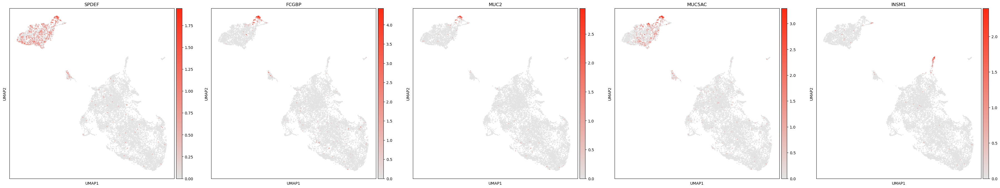

In [130]:
fig = sc.pl.umap(adata, color = ['SPDEF', 'FCGBP', 'MUC2','MUC5AC', 'INSM1'],size = 20,save = 'sec_map.png',ncols = 5,cmap = my_cmap) #overview of the graph
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('EC_map.png')

### Run a (simple) DE analysis and set up an appropriate threshold to identify cluster specific genes

In [416]:
sc.tl.rank_genes_groups(adata, groupby='leiden', key_added='rank',method = 'wilcoxon') #Wilcoxon method for DE analysis

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:27)


In [417]:
pass_genes = pd.DataFrame()
for i in set(adata.obs['leiden']):
    log2foldmask = adata.uns['rank']['logfoldchanges'][i].astype('double')>3
    pvalmask = adata.uns['rank']['pvals_adj'][i].astype('double')<0.01 #define DE in each cluster as adj-p < 0.01, log2 fold change>1
    additional = pd.DataFrame({
        i: adata.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

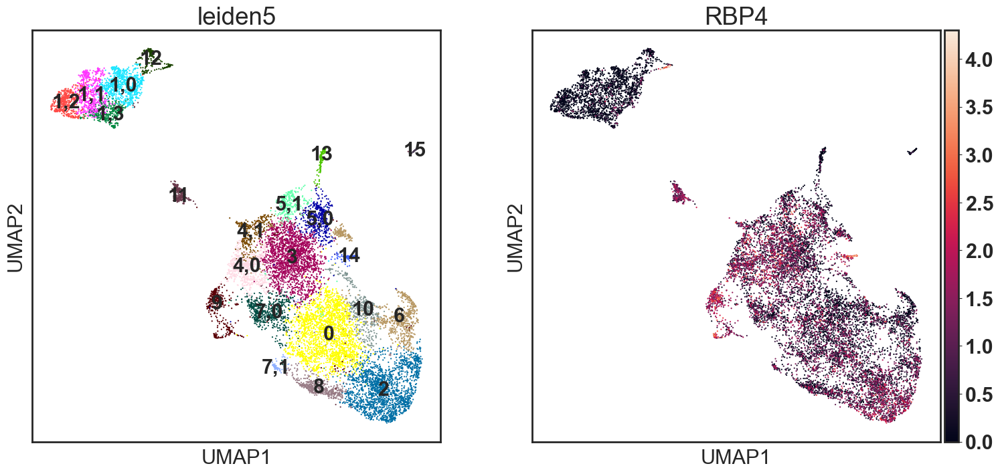

In [422]:
sc.pl.umap(adata, color=['leiden5','RBP4'], legend_loc = 'on data',size = 10) #Visualization and test

### Run a (simple) DE analysis with a cluster in reference to differentiate between similar clusters

In [1842]:
adata_de_copy=sc.tl.rank_genes_groups(adata, groupby='leiden6', groups =['9,2'],reference = '10',key_added='rank',method = 'wilcoxon',copy = True)
# Visit this part often when trying to labeling the cluster.

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)


In [1843]:
log2foldmask = np.array(adata_de_copy.uns['rank']['logfoldchanges'].astype('double')>4)
pvalmask = adata_de_copy.uns['rank']['pvals'].astype('double')<0.001
additional = pd.DataFrame(adata_de_copy.uns['rank']['names'][log2foldmask & pvalmask])

# the threshold is set high to differentiate similar clusters

In [ ]:
pass_genes = pd.DataFrame()
for i in ['9,0','9,1','9,2']:
    log2foldmask = adata_de_copy.uns['rank']['logfoldchanges'][i].astype('double')>6
    pvalmask = adata_de_copy.uns['rank']['pvals'][i].astype('double')<0.001
    additional = pd.DataFrame({
        i: adata_de_copy.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

### Subcluster

Found that cluster-specific DEs are not evenly expressed in some clusters, which means there are still availability for sbuclustering

running Leiden clustering
    finished: found 17 clusters and added
    'leiden2', the cluster labels (adata.obs, categorical) (0:00:00)


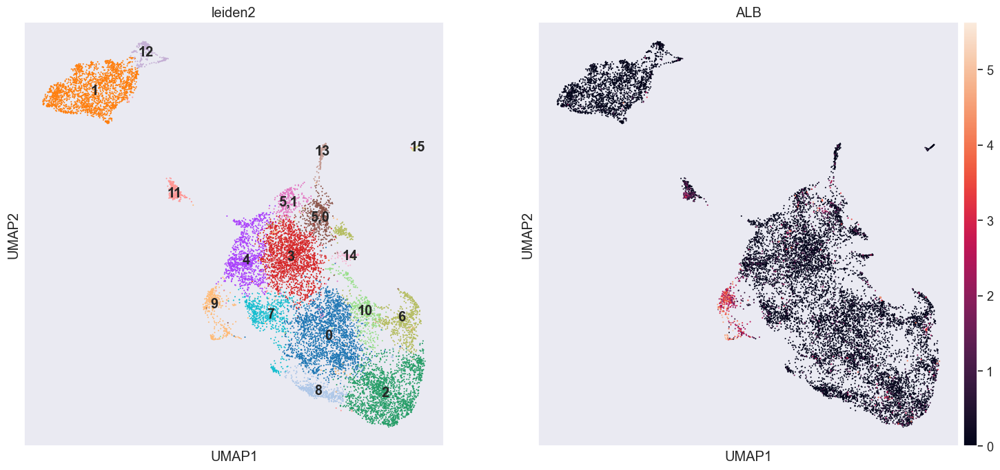

In [283]:
plt.rcParams['figure.figsize'] = [8,8] # Set up the parameters of the figure
sc.tl.leiden(adata, restrict_to = ('leiden', ['5']), resolution = 0.2, key_added= 'leiden2')
sc.pl.umap(adata, color=['leiden2','ALB'], legend_loc = 'on data')
#go back to the DE section to make sure this subcluster make sense

running Leiden clustering
    finished: found 18 clusters and added
    'leiden3', the cluster labels (adata.obs, categorical) (0:00:00)


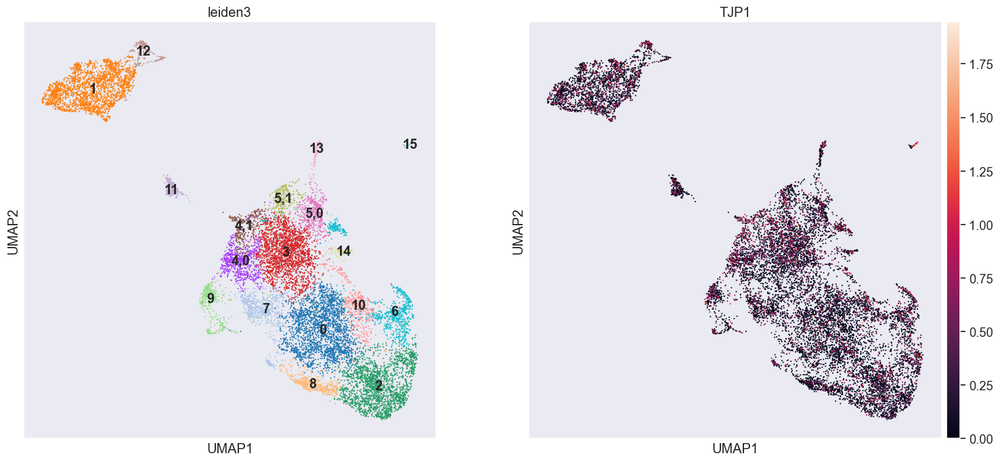

In [284]:
sc.tl.leiden(adata, restrict_to = ('leiden2', ['4']), resolution = 0.25, key_added= 'leiden3')
sc.pl.umap(adata, color=['leiden3','TJP1'], legend_loc = 'on data')

running Leiden clustering
    finished: found 19 clusters and added
    'leiden4', the cluster labels (adata.obs, categorical) (0:00:00)


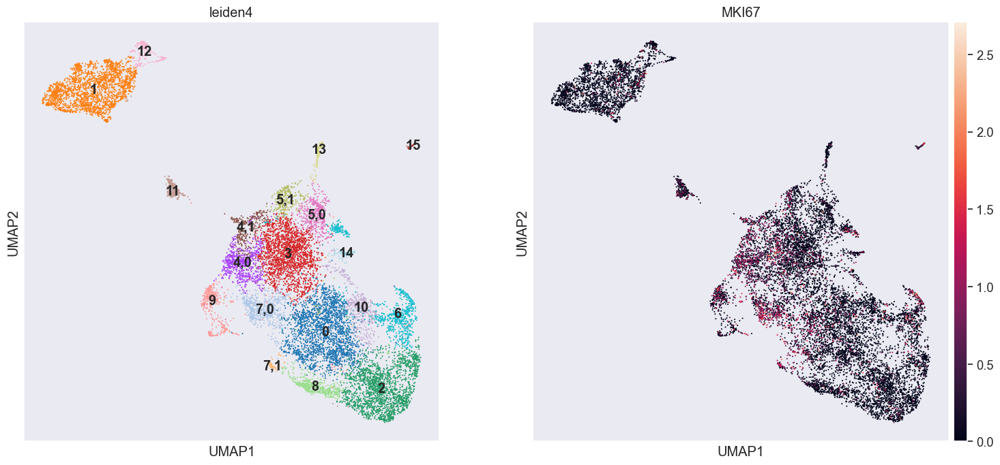

In [285]:
sc.tl.leiden(adata, restrict_to = ('leiden3', ['7']), resolution = 0.2, key_added= 'leiden4')
sc.pl.umap(adata, color=['leiden4','MKI67'], legend_loc = 'on data')

running Leiden clustering
    finished: found 22 clusters and added
    'leiden5', the cluster labels (adata.obs, categorical) (0:00:00)


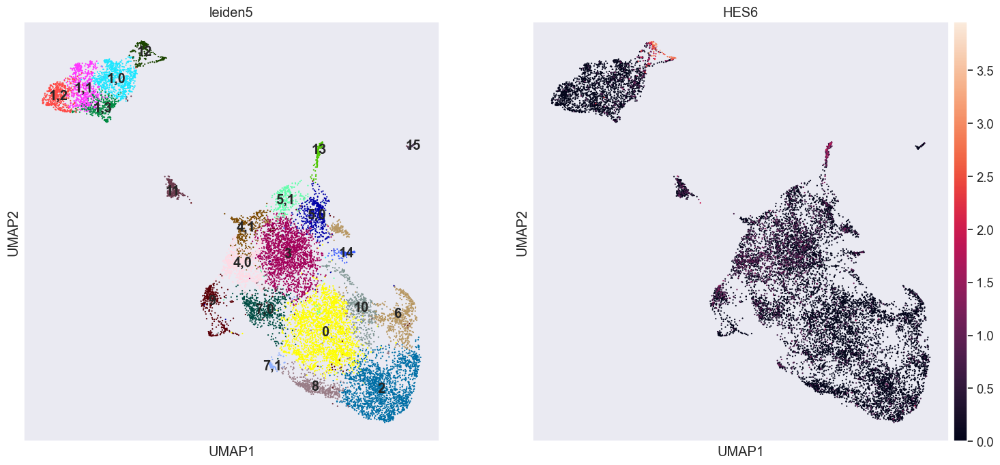

In [387]:
sc.tl.leiden(adata, restrict_to = ('leiden4', ['1']), resolution = 0.35, key_added= 'leiden5')
sc.pl.umap(adata, color=['leiden5','HES6'], legend_loc = 'on data',size = 10)

running Leiden clustering
    finished: found 26 clusters and added
    'leiden6', the cluster labels (adata.obs, categorical) (0:00:00)


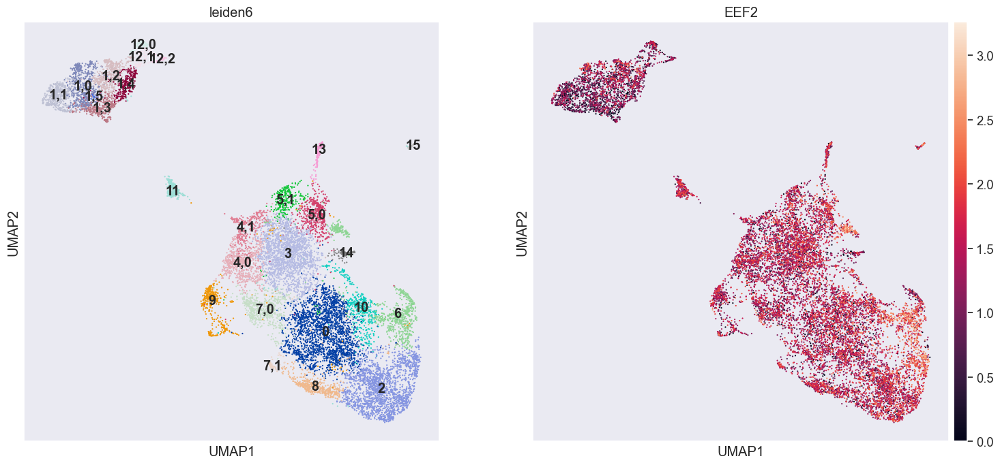

In [385]:
sc.tl.leiden(adata, restrict_to = ('leiden5', ['12']), resolution = 0.3, key_added= 'leiden6')
sc.pl.umap(adata, color=['leiden6','EEF2'], legend_loc = 'on data',size = 10)

running Leiden clustering
    finished: found 24 clusters and added
    'leiden7', the cluster labels (adata.obs, categorical) (0:00:00)


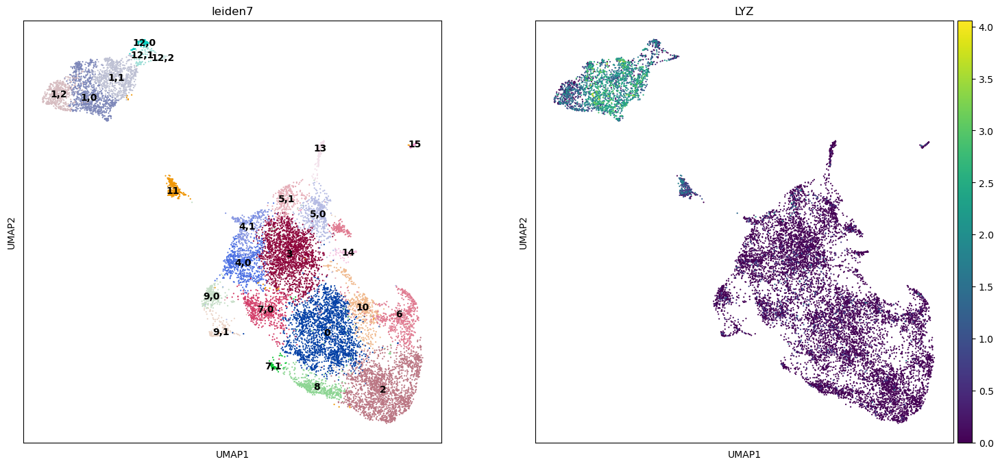

In [154]:
sc.tl.leiden(adata, restrict_to = ('leiden6', ['9']), resolution = 0.25, key_added= 'leiden7')
sc.pl.umap(adata, color=['leiden7','LYZ'], legend_loc = 'on data',size = 10)

running Leiden clustering
    finished: found 26 clusters and added
    'leiden8', the cluster labels (adata.obs, categorical) (0:00:00)


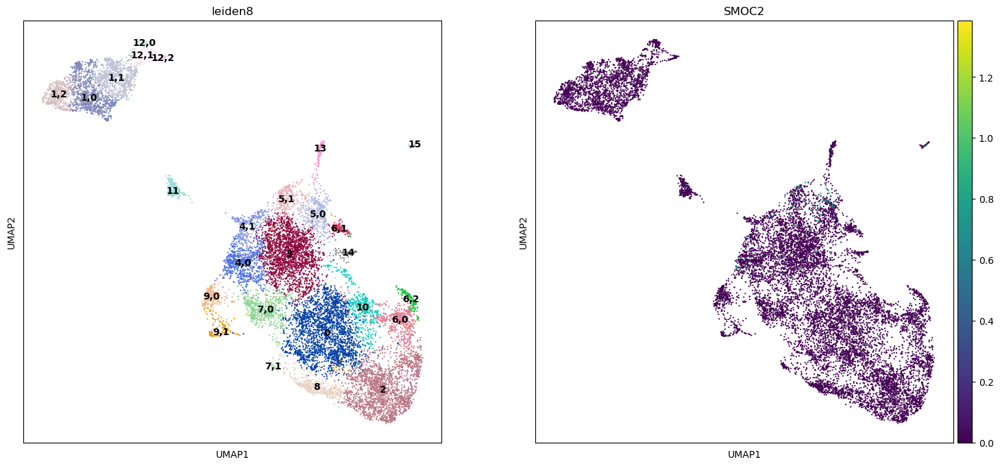

In [165]:
sc.tl.leiden(adata, restrict_to = ('leiden7', ['6']), resolution = 0.19, key_added= 'leiden8')
sc.pl.umap(adata, color=['leiden8','SMOC2'], legend_loc = 'on data',size = 10)

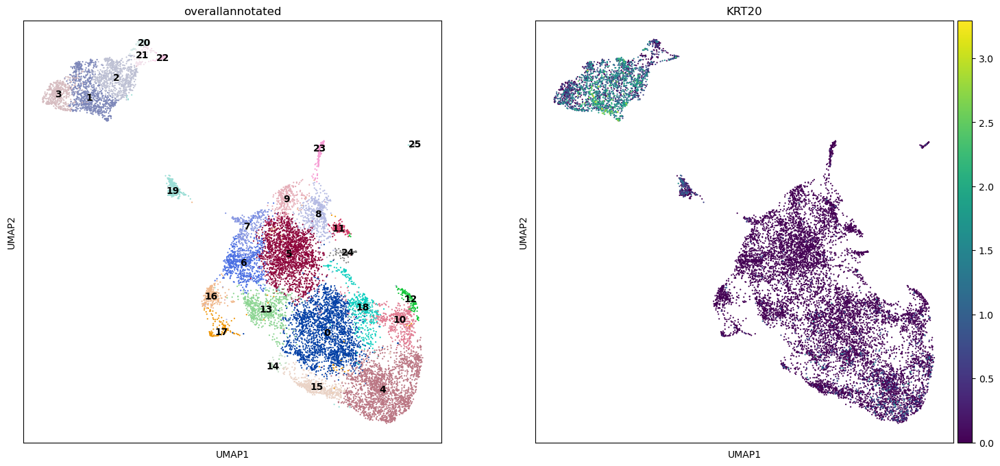

In [185]:
adata.obs['overallannotated'] = adata.obs.groupby('leiden8').ngroup()
adata.obs['overallannotated'] = adata.obs['overallannotated'].astype('str')
sc.pl.umap(adata, color=['overallannotated','KRT20'], legend_loc = 'on data',size = 10)

### Finalize the cluster label

In [677]:
adata.obs['overallannotated'] = adata.obs.groupby('leiden8').ngroup()
adata.obs['overallannotated'] = adata.obs['overallannotated'].astype('str')
adata.obs = adata.obs.replace({'overallannotated' : { 
    '0': 'ECLC',
    '1': 'U-HT29',
    '2': 'D-HT29',
    '3': 'U-HT29',
    '4': 'ECLC',
    '5': 'TALC',
    '6': 'TALC',    
    '7': 'TALC',
    '8': 'ISCLC',
    '9': 'ISCLC',
    '10': 'ECLC',
    '11': 'TALC',
    '12': 'TALC',
    '13': 'TALC',
    '14': 'TALC',
    '15': 'ECLC',
    '16': 'TALC',
    '17': 'ECLC',
    '18': 'ECLC',
    '19': 'ECLC',
    '20': 'GCLC',
    '21': 'SECPLC',
    '22': 'Early EECLC',
    '23': 'Early EECLC',
    '24': 'ECLC',
    '25': 'FLC'}})
adata.obs['overallannotated'] = adata.obs['overallannotated'].astype('category')

C:\Users\16220\AppData\Local\Temp\ipykernel_20848\2672909373.py:2: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['overallannotated'].cat.reorder_categories(cat_order, inplace= True)


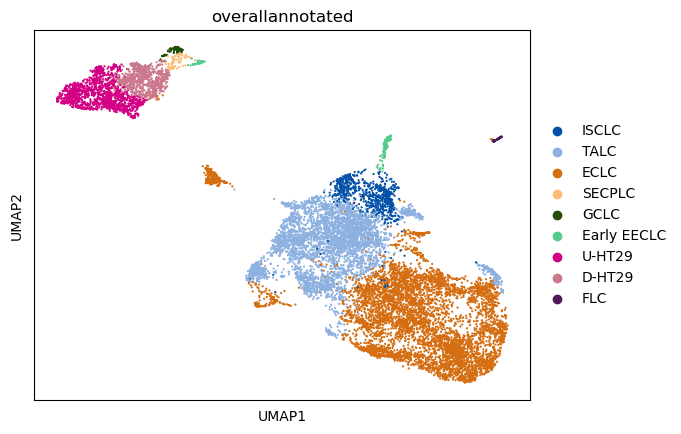

In [679]:
cat_order = ['ISCLC','TALC','ECLC','SECPLC','GCLC','Early EECLC','U-HT29','D-HT29','FLC']
adata.obs['overallannotated'].cat.reorder_categories(cat_order, inplace= True)
sc.pl.umap(adata, color=['overallannotated'] ,size = 10, palette  = my_pallete)

In [681]:
adata.obs['detailannotated'] = adata.obs.groupby('leiden8').ngroup()
adata.obs['detailannotated'] = adata.obs['detailannotated'].astype('str')
adata.obs = adata.obs.replace({'detailannotated' : { 
    '0': 'Early ECLC',
    '1': 'Interm U-HT29',
    '2': 'D-HT29',
    '3': 'Early U-HT29',
    '4': 'ECLC',
    '5': 'Early TALC',
    '6': 'Interm TALC',    
    '7': 'Early TALC',
    '8': 'ISCLC',
    '9': 'ISCLC',
    '10': 'Early ECLC',
    '11': 'TALC',
    '12': 'TALC',
    '13': 'TALC',
    '14': 'TALC',
    '15': 'Early ECLC',
    '16': 'TALC',
    '17': 'Early ECLC',
    '18': 'Early ECLC',
    '19': 'Early ECLC',
    '20': 'GCLC',
    '21': 'SECPLC',
    '22': 'Early EECLC',
    '23': 'Early EECLC',
    '24': 'Early ECLC',
    '25': 'FLC'}})
adata.obs['detailannotated'] = adata.obs['detailannotated'].astype('category')

C:\Users\16220\AppData\Local\Temp\ipykernel_20848\938231055.py:2: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['detailannotated'].cat.reorder_categories(cat_order, inplace= True)


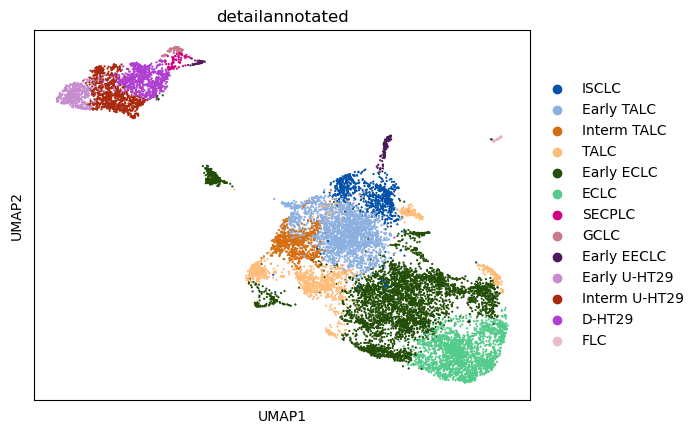

In [682]:
cat_order = ['ISCLC','Early TALC','Interm TALC','TALC','Early ECLC','ECLC','SECPLC','GCLC','Early EECLC','Early U-HT29','Interm U-HT29','D-HT29','FLC']
adata.obs['detailannotated'].cat.reorder_categories(cat_order, inplace= True)
sc.pl.umap(adata, color=['detailannotated'] ,size = 10, palette  = my_pallete)

In [683]:
adata.obs['verydetailannotated'] = adata.obs.groupby('leiden8').ngroup()
adata.obs['verydetailannotated'] = adata.obs['verydetailannotated'].astype('str')
adata.obs = adata.obs.replace({'verydetailannotated' : { 
    '0': 'Early ECLC 1',
    '1': 'Interm U-HT29',
    '2': 'D-HT29',
    '3': 'Early U-HT29',
    '4': 'ECLC',
    '5': 'Early TALC 1',
    '6': 'Interm TALC',    
    '7': 'Early TALC 2',
    '8': 'ISCLC 2',
    '9': 'ISCLC 1',
    '10': 'Early ECLC 3',
    '11': 'TALC 3',
    '12': 'TALC 3',
    '13': 'TALC 1',
    '14': 'TALC 4',
    '15': 'Early ECLC 4',
    '16': 'TALC 2',
    '17': 'Early ECLC 2',
    '18': 'Early ECLC 5',
    '19': 'Early ECLC 6',
    '20': 'GCLC',
    '21': 'SECPLC',
    '22': 'Early EECLC 1',
    '23': 'Early EECLC 2',
    '24': 'Early ECLC 7',
    '25': 'FLC'}})
adata.obs['verydetailannotated'] = adata.obs['verydetailannotated'].astype('category')

C:\Users\16220\AppData\Local\Temp\ipykernel_20848\2115004391.py:4: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  adata.obs['verydetailannotated'].cat.reorder_categories(cat_order, inplace= True)


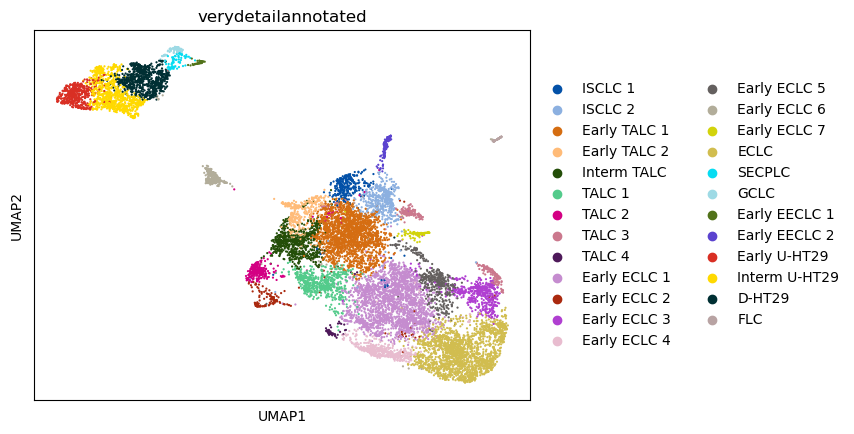

In [684]:
cat_order = ['ISCLC 1','ISCLC 2','Early TALC 1', 'Early TALC 2','Interm TALC', 'TALC 1', 'TALC 2', 'TALC 3','TALC 4',
             'Early ECLC 1','Early ECLC 2','Early ECLC 3','Early ECLC 4','Early ECLC 5','Early ECLC 6','Early ECLC 7',
             'ECLC','SECPLC','GCLC','Early EECLC 1','Early EECLC 2','Early U-HT29','Interm U-HT29','D-HT29','FLC']
adata.obs['verydetailannotated'].cat.reorder_categories(cat_order, inplace= True)
sc.pl.umap(adata, color=['verydetailannotated'] ,size = 10, palette  = my_pallete)

Clean up a little bit

In [221]:
adata.uns['overallannotated_colors'] = my_pallete[0:len(adata.uns['overallannotated_colors'])]
adata.uns['detailannotated_colors'] = my_pallete[0:len(adata.uns['detailannotated_colors'])]
adata.uns['verydetailannotated_colors'] = my_pallete[0:len(adata.uns['verydetailannotated_colors'])]

In [ ]:
del(adata.uns['celltype'])

AnnData object with n_obs × n_vars = 13784 × 16019
    obs: 'n_counts', 'n_genes', 'condition', 'phase', 'mt_frac', 'ribo_frac', 'leiden', 'condition_general', 'leiden8', 'overallannotated', 'detailannotated', 'verydetailannotated'
    var: 'highly_variable'
    uns: 'celltype_colors', 'leiden', 'leiden_colors', 'leiden_sizes', 'neighbors', 'paga', 'pca', 'rank', 'scaled', 'umap', 'leiden2_colors', 'leiden3_colors', 'leiden4_colors', 'leiden5_colors', 'leiden6_colors', 'leiden7_colors', 'leiden8_colors', 'leiden9_colors', 'overallannotated_colors', 'detailannotated_colors', 'verydetailannotated_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'connectivities', 'distances'

## Fit negative binomial distribution on CCLE RNA seq

In [449]:
# Download the CCLE RNAseq gene expression data for1019 cell lines (read counts)
ccle = pd.read_csv('\GSE185224\CCLE_RNAseq_reads.csv',index_col = 0)

In [450]:
table = np.round(ccle.loc[['ACH-000003','ACH-000552'],:])

In [451]:
table = table.transpose()

In [452]:
table.index = [table.index[i].split(' ')[0] for i in range(0,len(table.index))]

In [453]:
table.columns = ['CACO2','HT29']

In [454]:
table['Diff'] = table['CACO2']-table['HT29']

In [455]:
#CACO2 sig
zz = pd.DataFrame(table['Diff'][table['Diff']>0])

In [456]:
import statsmodels.discrete.discrete_model as smds

In [457]:
X = np.ones_like(zz)
z = smds.NegativeBinomial(zz,X).fit(start_params = [1,1])

Optimization terminated successfully.
         Current function value: 6.716019
         Iterations: 18
         Function evaluations: 19
         Gradient evaluations: 19


In [458]:
mu = np.exp(z.params[0])
p = 1/(1+np.exp(z.params[0])*z.params[1])
n = np.exp(z.params[0])*p/(1-p)

In [459]:
CACO2_cut = sp.stats.nbinom.ppf(0.95, n, p)

In [460]:
CACO2_sig = table['Diff'][table['Diff']>=CACO2_cut].index

In [461]:
#HT29 sig
zzz = np.abs(pd.DataFrame(table['Diff'][table['Diff']<0]))

In [462]:
X = np.ones_like(zzz)
z = smds.NegativeBinomial(zzz,X).fit(start_params = [1,1])
print(z.summary())

Optimization terminated successfully.
         Current function value: 5.701299
         Iterations: 16
         Function evaluations: 17
         Gradient evaluations: 17
                     NegativeBinomial Regression Results                      
Dep. Variable:                   Diff   No. Observations:                 9548
Model:               NegativeBinomial   Df Residuals:                     9547
Method:                           MLE   Df Model:                            0
Date:                Tue, 15 Nov 2022   Pseudo R-squ.:               2.866e-11
Time:                        21:17:49   Log-Likelihood:                -54436.
converged:                       True   LL-Null:                       -54436.
Covariance Type:            nonrobust   LLR p-value:                       nan
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          6.1476      0.022    28

In [463]:
mu = np.exp(z.params[0])
p = 1/(1+np.exp(z.params[0])*z.params[1])
n = np.exp(z.params[0])*p/(1-p)

In [465]:
HT29_cut = sp.stats.nbinom.ppf(0.95, n, p)

In [466]:
HT29_sig = table['Diff'][table['Diff']<=-HT29_cut].index
HT29_sig

Index(['NIPAL3', 'LASP1', 'AK2', 'HOXA11', 'ITGA3', 'RHBDF1', 'ST3GAL1',
       'CSDE1', 'SLC38A5', 'VSIG2',
       ...
       'TAF15', 'CD24', 'AL365181.3', 'AFAP1-AS1', 'MLLT6', 'ARHGAP23',
       'CISD3', 'ACACA', 'FP671120.6', 'FP236383.5'],
      dtype='object', length=411)

In [467]:
CH_marker = dict()
CH_marker['HT29 Signature'] = HT29_sig
CH_marker['CACO2 Signature'] = CACO2_sig

In [468]:
CH_marker_df = pd.DataFrame({'HT29 Signature':HT29_sig})
i = pd.DataFrame({'CACO2 Signature':CACO2_sig})
CH_marker_df = pd.concat([CH_marker_df, i], ignore_index=False, axis=1)

In [469]:
CH_marker_df.to_excel('Caco_HT29_markers.xlsx')

In [470]:
sc.tl.rank_genes_groups(adata, groupby = 'verydetailannotated',key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:32)


In [476]:
plt.rcParams['figure.figsize'] = [2,8]
#sns.reset_orig()
CH_annotation = sc.tl.marker_gene_overlap(adata, CH_marker, key='rank',normalize='reference')
ax = sns.heatmap(CH_annotation.T, cbar=True, annot=False, cbar_kws = {'ticks': [], 'label': 'Similarity'})
sns.set(font_scale=1.2)
#plt.yticks(np.arange(2)+0.5,('HT29 Signatures','Caco-2 Signatures',),fontsize="20")
plt.savefig('id_origin.jpg',bbox_inches='tight')

In [472]:
adata.obs['roughannotated'] = [ 'HT29' if i in ['1','11','12'] else 'Caco-2' for i in adata.obs['leiden']]

In [473]:
pass_genes = pd.DataFrame()
for i in set(adata.obs['verydetailannotated']):
    log2foldmask = adata.uns['rank']['logfoldchanges'][i].astype('double')>3
    pvalmask = adata.uns['rank']['pvals_adj'][i].astype('double')<0.01
    additional = pd.DataFrame({
        i: adata.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

In [474]:
pass_genes['D-HT29'][0:20]

0       LGALS4
1          LYZ
2     NDUFA4L2
3        KRT20
4         GPX2
5          CA9
6      SLC12A2
7       ERRFI1
8         XIST
9         TPM2
10        TESC
11       LCN15
12     CEACAM5
13       NUPR1
14       NXPH4
15    C6orf223
16       AZGP1
17     PPP1R1B
18        ECM1
19       BACE2
Name: D-HT29, dtype: object

## Run Pseudotime

### Goblet - slingshot

In [148]:
gob_ids = adata.obs['verydetailannotated'].isin(['D-HT29','SECPLC','GCLC','Early U-HT29','Interm U-HT29'])
gob = adata[gob_ids]
gob

View of AnnData object with n_obs × n_vars = 2320 × 16019
    obs: 'n_counts', 'n_genes', 'condition', 'phase', 'mt_frac', 'ribo_frac', 'leiden', 'condition_general', 'leiden8', 'overallannotated', 'detailannotated', 'verydetailannotated', 'roughannotated', 'leiden2', 'leiden3', 'leiden4', 'leiden5', 'leiden6'
    var: 'highly_variable'
    uns: 'condition_colors', 'detailannotated_colors', 'leiden', 'leiden2_colors', 'leiden3_colors', 'leiden4_colors', 'leiden6_colors', 'leiden_colors', 'leiden_sizes', 'neighbors', 'overallannotated_colors', 'paga', 'pca', 'rank', 'scaled', 'umap', 'verydetailannotated_colors'
    obsm: 'X_pca', 'X_umap'
    varm: 'PCs'
    layers: 'counts', 'logcounts'
    obsp: 'connectivities', 'distances'

In [102]:
%%R -i gob

gob_start <- slingshot(gob, clusterLabels = 'verydetailannotated', reducedDim = 'UMAP', start.clus='Early U-HT29', stretch = 2, extend = "n")
colors <- colorRampPalette(brewer.pal(11,'Spectral')[-6])(100)

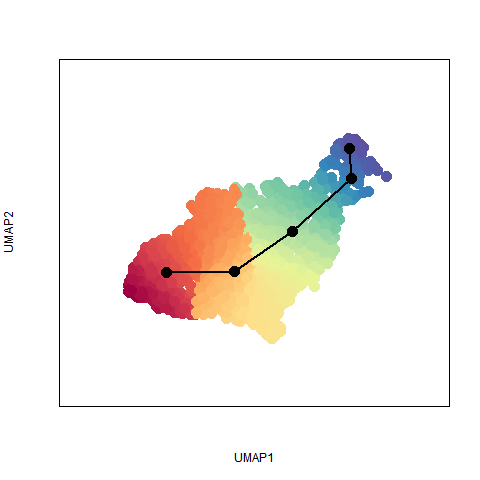

In [103]:
%%R
p = plot(reducedDims(gob_start)$UMAP[,c(1,2)], col = colors[cut(gob_start$slingPseudotime_1,breaks=100)], pch=19, asp = 1, cex = 2, xlab='UMAP1', ylab='UMAP2', xlim=c(-6, 1),ylim = c(10,15),xaxt='n',yaxt='n', axes= TRUE, box= TRUE)
lines(SlingshotDataSet(gob_start), lwd=2,type='lineages')

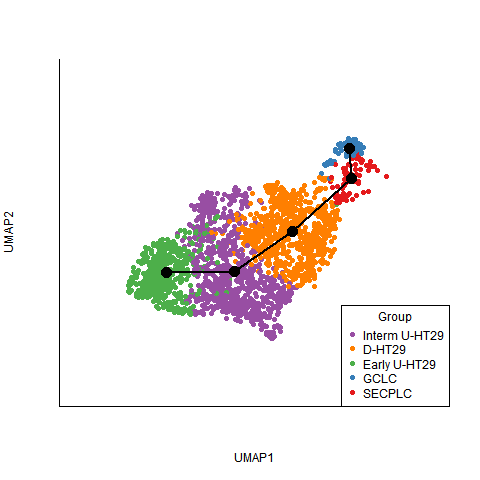

In [104]:
%%R
color = brewer.pal(11,'Set1')[gob$verydetailannotated]
plot(reducedDims(gob_start)$UMAP[,c(1,2)], col = color, pch=16, asp = 1, cex = 1,bty='L', xlab='UMAP1', ylab='UMAP2',xaxt='n',yaxt='n', axes= TRUE, box= TRUE, xlim=c(-6, 1),ylim = c(10,15))
legend("bottomright", legend=unique(gob$verydetailannotated), title="Group", col = unique(color), pch = 16)
lines(SlingshotDataSet(gob_start), lwd=2,type='lineages')

In [105]:
%%R
#Set the pseudotime variable
t <- gob_start$slingPseudotime_1

#Extract the gene expression matrix
Y <- assay(gob_start)

# fit a GAM with a loess term for pseudotime
#Note: This takes a while
gam.pval <- apply(Y,1,function(z){
  d <- data.frame(z=z, t=t)
  tmp <- gam(z ~ lo(t), data=d)
  p <- summary(tmp)[4][[1]][1,5]
  p
})

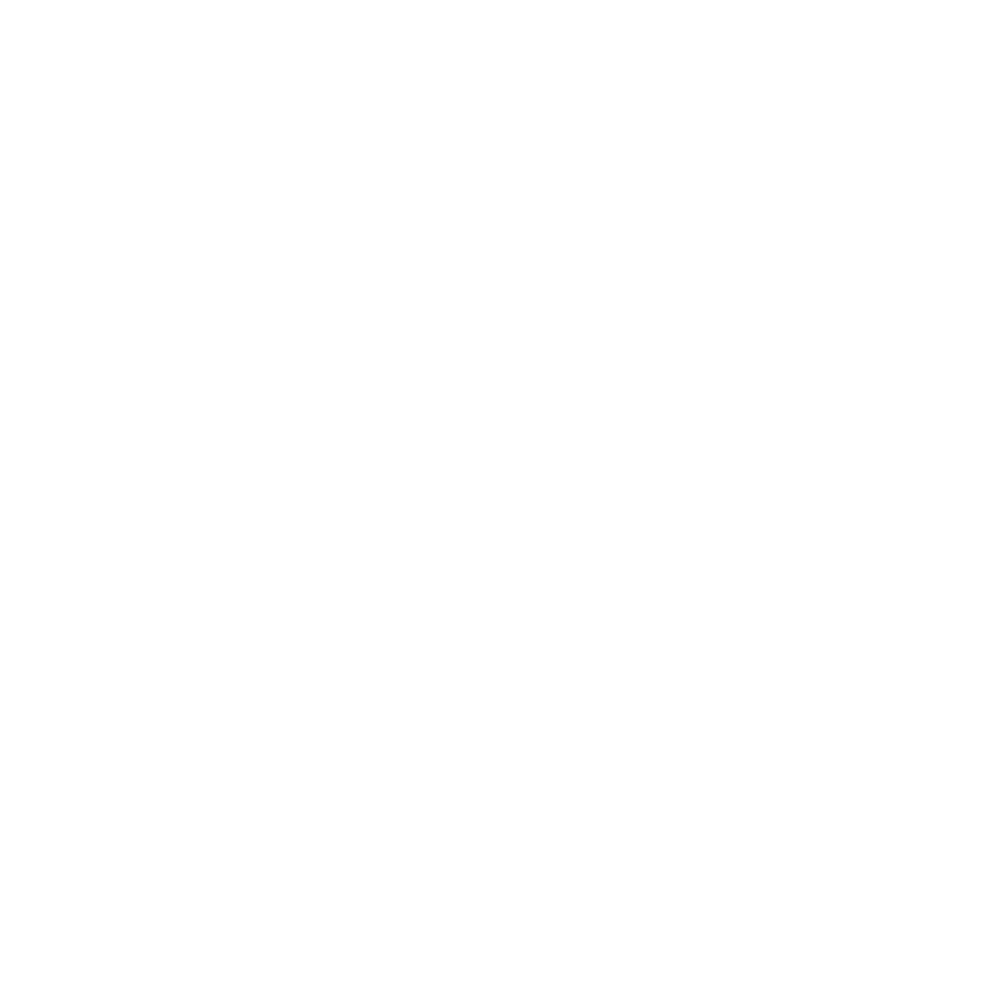

In [107]:
%%R -w 1200 -h 1200 -o heatdata

#Select the top 100 most significant genes that change over pseudotime
topgenes <- names(sort(gam.pval, decreasing = FALSE))[1:100]
topgenes[startsWith(topgenes,'RP') == TRUE] = ""
heatdata <- assay(gob_start)[rownames(assay(gob_start)) %in% topgenes, 
                        order(t, na.last = NA, decreasing = FALSE)]
#Scale the data per gene for visualization
heatdata <- t(scale(t(heatdata)))

#Trimm z-score scale
heatdata[heatdata > 3] = 3
heatdata[heatdata < -3] = -3

#Get cluster assignment
heatclus <- gob_start$verydetailannotated[order(t, na.last = NA)]

#Set up a clusterExperiment data structure for heatmap visualization
ce <- ClusterExperiment(heatdata, heatclus, transformation = function(x){x})

#Plot the heatmap
k = plotHeatmap(ce, clusterSamplesData = "orderSamplesValue", visualizeData = 'transformed', fontsize=15, showSampleNames = FALSE, filename = 'gob_time2.jpg',labCol = NA, cexRow = 2)

## DE analysis in R

### Monocle3

#### ECLC

In [185]:
ec = adata[adata.obs['overallannotated'].isin(['ECLC']),:]
ec = ec[ec.obs['verydetailannotated'].isin(['Early ECLC 6'])==0,:]
sc.pp.filter_genes(ec, min_cells = 10)

filtered out 3603 genes that are detected in less than 10 cells


In [186]:
colnames = ec.obs_names
rownames = ec.var_names
condition = ec.obs['condition_general']
roughcelltype = ec.obs['overallannotated']
detailedcelltype = ec.obs['verydetailannotated']
UMAP = ec.obsm['X_umap']
PCA = ec.obsm['X_pca']
counts = ec.layers['counts'].T

In [187]:
%%R -i counts -i colnames -i rownames -i condition -i roughcelltype -i UMAP -i PCA -i detailedcelltype
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "transwell", min.cells = 0, min.features = 0, assay = "RNA")

srat[["condition"]] = condition
srat[["roughcelltype"]] = roughcelltype
srat[["detailedcelltype"]] = detailedcelltype

In [188]:
%%R
library(monocle3)
library(SeuratWrappers)
cds <- as.cell_data_set(srat)
cds <- estimate_size_factors(cds)
cds@rowRanges@elementMetadata@listData[["gene_short_name"]] <- rownames(srat[["RNA"]])
#cds = preprocess_cds(cds, num_dim = 50)

In [189]:
%%R
gene_fits <- fit_models(cds, model_formula_str = "~condition")

In [190]:
%%R
fit_coefs <- coefficient_table(gene_fits)

In [191]:
%%R -o terms
library(magrittr) # needs to be run every time you start R and want to use %>%
library(dplyr)    # alternatively, this also loads %>%

terms <- fit_coefs %>% filter(term == "conditiontreated")
#colnames(terms)
terms = terms %>% select(gene_short_name, term, q_value, normalized_effect)
#terms = terms %>% filter (q_value < 0.05) %>%
         #select(gene_short_name, term, q_value, normalized_effect)

In [196]:
terms['-logQ'] = -np.log10(terms['q_value'])
terms = terms[terms['-logQ']>0]

In [271]:
terms = terms_ec

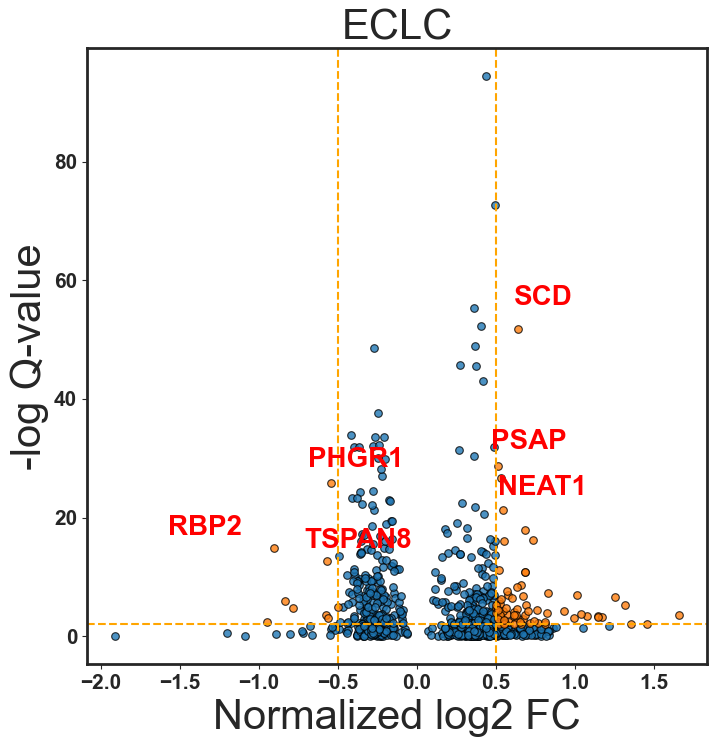

In [272]:
##### Volcano plot of results
from adjustText import adjust_text
plt.rcParams.update({'font.size': 14, 'font.weight': 'bold','axes.linewidth':2})
lowqval_de = terms[np.array(terms['-logQ']>=2) & np.array(abs(terms['normalized_effect'])>=0.5)]
other_de = terms[np.array(terms['-logQ']<2) | np.array(abs(terms['normalized_effect'])<0.5)]

fig, ax = plt.subplots()
sb.regplot(other_de['normalized_effect'], other_de['-logQ'], fit_reg=False, scatter_kws={'s':30, 'edgecolors': 'black', 'linewidths': 0.8})
sb.regplot(lowqval_de['normalized_effect'], lowqval_de['-logQ'], fit_reg=False, scatter_kws={'s':30,'edgecolors': 'black', 'linewidths': 0.8})
ax.set_xlabel("Normalized log2 FC", fontsize=30)
ax.set_ylabel("-log Q-value", fontsize=30)
ax.tick_params(labelsize=15)
ax.set_title('ECLC',size = 30)
    
    
    
# Label names and positions
x = [i*1.1-0.1 for i in lowqval_de['normalized_effect']]
y = [i*1.05 for i in lowqval_de['-logQ']]
labels = lowqval_de['gene_short_name']

# Show only some labels to avoid overcrowding the figure
to_remove = np.where(np.array(lowqval_de['gene_short_name'].str.startswith('RP'))|np.array(lowqval_de['gene_short_name'].str.startswith('MT'))
                     |(np.array(lowqval_de['normalized_effect']>0.5)&np.array(lowqval_de['normalized_effect']<1)&np.array(lowqval_de['-logQ']<20))|np.array(lowqval_de['-logQ']<10))
labels = ["" if i in to_remove[0] else lab for i,lab in enumerate(labels) ]
texts = []
for i,txt in enumerate(labels):
    texts.append(ax.text(x[i], y[i], txt,size = 20, color= 'red', weight = 'bold'))

adjust_text(texts)
#ax.xaxis.label.set_fontweight('bold')
#ax.yaxis.label.set_fontweight('bold')
#ax.yaxis.label.set_fontsize(22)
    #ax.annotate(txt, (x[i], y[i]),size = 10,bbox=dict(boxstyle="Square,pad=0.3", fc="orange", ec="b", lw=2, alpha = 0.6))
    #plt.xlim([-0.6,0.65])
plt.axhline(y=2, color="orange", linestyle="--")
plt.axvline(x = -0.5, color="orange", linestyle="--")
plt.axvline(x = 0.5, color="orange", linestyle="--")
plt.savefig('f:/figures/deeclc.jpg')

In [220]:
terms_ec = terms

In [327]:
terms_ta[terms_ta['normalized_effect']>1]

,gene_short_name,term,q_value,normalized_effect,-logQ
4,PLEKHN1,conditiontreated,8.071964e-03,1.634435,2.093021
2408,VGLL3,conditiontreated,3.697531e-01,1.146562,0.432088
3237,SNHG18,conditiontreated,2.835707e-02,1.409439,1.547339
3773,TXNDC5,conditiontreated,8.206800e-03,1.069031,2.085826
3949,AGER,conditiontreated,9.495803e-03,1.109264,2.022468
4121,OGFRL1,conditiontreated,7.890159e-03,1.634435,2.102914
4312,SAMD5,conditiontreated,3.102295e-01,1.088776,0.508317
4325,ULBP1,conditiontreated,8.295895e-01,1.371503,0.081137
5566,JPH1,conditiontreated,1.292520e-03,1.276461,2.888563
8082,LINC01234,conditiontreated,6.822732e-03,1.006482,2.166042


#### ISC

In [221]:
isc = adata[adata.obs['overallannotated'].isin(['ISCLC']),:]
sc.pp.filter_genes(isc, min_cells = 10)

filtered out 4843 genes that are detected in less than 10 cells


In [222]:
colnames = isc.obs_names
rownames = isc.var_names
condition = isc.obs['condition_general']
roughcelltype = isc.obs['overallannotated']
detailedcelltype = isc.obs['verydetailannotated']
UMAP = isc.obsm['X_umap']
PCA = isc.obsm['X_pca']
counts = isc.layers['counts'].T

In [223]:
%%R -i counts -i colnames -i rownames -i condition -i roughcelltype -i UMAP -i PCA -i detailedcelltype
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "transwell", min.cells = 0, min.features = 0, assay = "RNA")

srat[["condition"]] = condition
srat[["roughcelltype"]] = roughcelltype
srat[["detailedcelltype"]] = detailedcelltype

In [224]:
%%R
library(monocle3)
library(SeuratWrappers)
cds <- as.cell_data_set(srat)
cds <- estimate_size_factors(cds)
cds@rowRanges@elementMetadata@listData[["gene_short_name"]] <- rownames(srat[["RNA"]])
#cds = preprocess_cds(cds, num_dim = 50)

In [225]:
%%R
gene_fits <- fit_models(cds, model_formula_str = "~condition")

In [226]:
%%R
fit_coefs <- coefficient_table(gene_fits)

In [227]:
%%R -o terms
library(magrittr) # needs to be run every time you start R and want to use %>%
library(dplyr)    # alternatively, this also loads %>%

terms <- fit_coefs %>% filter(term == "conditiontreated")
#colnames(terms)
terms = terms %>% select(gene_short_name, term, q_value, normalized_effect)
#terms = terms %>% filter (q_value < 0.05) %>%
         #select(gene_short_name, term, q_value, normalized_effect)

In [235]:
terms['-logQ'] = -np.log10(terms['q_value'])
terms = terms[terms['-logQ']>0]

In [273]:
terms = terms_isc

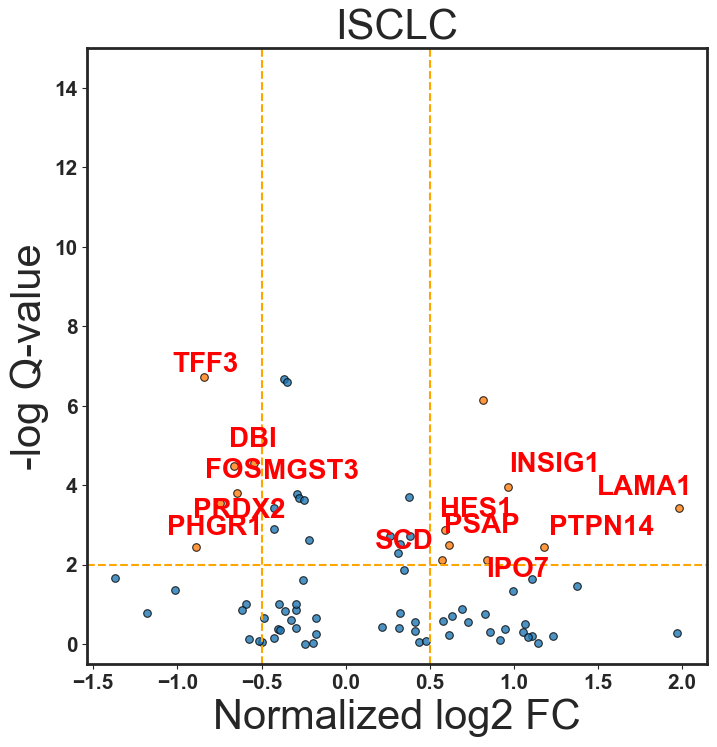

In [274]:
##### Volcano plot of results
from adjustText import adjust_text
plt.rcParams.update({'font.size': 14, 'font.weight': 'bold','axes.linewidth':2})
lowqval_de = terms[np.array(terms['-logQ']>=2) & np.array(abs(terms['normalized_effect'])>=0.5)]
other_de = terms[np.array(terms['-logQ']<2) | np.array(abs(terms['normalized_effect'])<0.5)]

fig, ax = plt.subplots()
sb.regplot(other_de['normalized_effect'], other_de['-logQ'], fit_reg=False, scatter_kws={'s':30, 'edgecolors': 'black', 'linewidths': 0.8})
sb.regplot(lowqval_de['normalized_effect'], lowqval_de['-logQ'], fit_reg=False, scatter_kws={'s':30,'edgecolors': 'black', 'linewidths': 0.8})
ax.set_xlabel("Normalized log2 FC", fontsize=30)
ax.set_ylabel("-log Q-value", fontsize=30)
ax.tick_params(labelsize=15)
ax.set_title('ISCLC',size = 30)
    
    
    
# Label names and positions
x = [i*1.1-0.1 for i in lowqval_de['normalized_effect']]
y = [i*1.05 for i in lowqval_de['-logQ']]
labels = lowqval_de['gene_short_name']

# Show only some labels to avoid overcrowding the figure
to_remove = np.where(np.array(lowqval_de['gene_short_name'].str.startswith('RP'))|np.array(lowqval_de['gene_short_name'].str.startswith('MT'))
                    )
labels = ["" if i in to_remove[0] else lab for i,lab in enumerate(labels) ]
texts = []
for i,txt in enumerate(labels):
    texts.append(ax.text(x[i], y[i], txt,size = 20, color= 'red', weight = 'bold'))

adjust_text(texts)
    #ax.annotate(txt, (x[i], y[i]),size = 10,bbox=dict(boxstyle="Square,pad=0.3", fc="orange", ec="b", lw=2, alpha = 0.6))
    #plt.xlim([-0.6,0.65])
plt.axhline(y=2, color="orange", linestyle="--")
plt.axvline(x = -0.5, color="orange", linestyle="--")
plt.axvline(x = 0.5, color="orange", linestyle="--")
plt.ylim([-0.5,15])
plt.savefig('f:/figures/deisclc.jpg')

In [237]:
terms_isc=terms

#### TA

In [240]:
talc = adata[adata.obs['overallannotated'].isin(['TALC']),:]
sc.pp.filter_genes(talc, min_cells = 10)

filtered out 3600 genes that are detected in less than 10 cells


In [241]:
colnames = talc.obs_names
rownames = talc.var_names
condition = talc.obs['condition_general']
roughcelltype = talc.obs['overallannotated']
detailedcelltype = talc.obs['verydetailannotated']
UMAP = talc.obsm['X_umap']
PCA = talc.obsm['X_pca']
counts = talc.layers['counts'].T

In [242]:
%%R -i counts -i colnames -i rownames -i condition -i roughcelltype -i UMAP -i PCA -i detailedcelltype
colnames(counts) = colnames
rownames(counts) = rownames

srat <- CreateSeuratObject(counts = counts, project = "transwell", min.cells = 0, min.features = 0, assay = "RNA")

srat[["condition"]] = condition
srat[["roughcelltype"]] = roughcelltype
srat[["detailedcelltype"]] = detailedcelltype

In [243]:
%%R
library(monocle3)
library(SeuratWrappers)
cds <- as.cell_data_set(srat)
cds <- estimate_size_factors(cds)
cds@rowRanges@elementMetadata@listData[["gene_short_name"]] <- rownames(srat[["RNA"]])
#cds = preprocess_cds(cds, num_dim = 50)

In [244]:
%%R
gene_fits <- fit_models(cds, model_formula_str = "~condition")

In [245]:
%%R
fit_coefs <- coefficient_table(gene_fits)

In [246]:
%%R -o terms
library(magrittr) # needs to be run every time you start R and want to use %>%
library(dplyr)    # alternatively, this also loads %>%

terms <- fit_coefs %>% filter(term == "conditiontreated")
#colnames(terms)
terms = terms %>% select(gene_short_name, term, q_value, normalized_effect)
#terms = terms %>% filter (q_value < 0.05) %>%
         #select(gene_short_name, term, q_value, normalized_effect)

In [247]:
terms['-logQ'] = -np.log10(terms['q_value'])
terms = terms[terms['-logQ']>0]

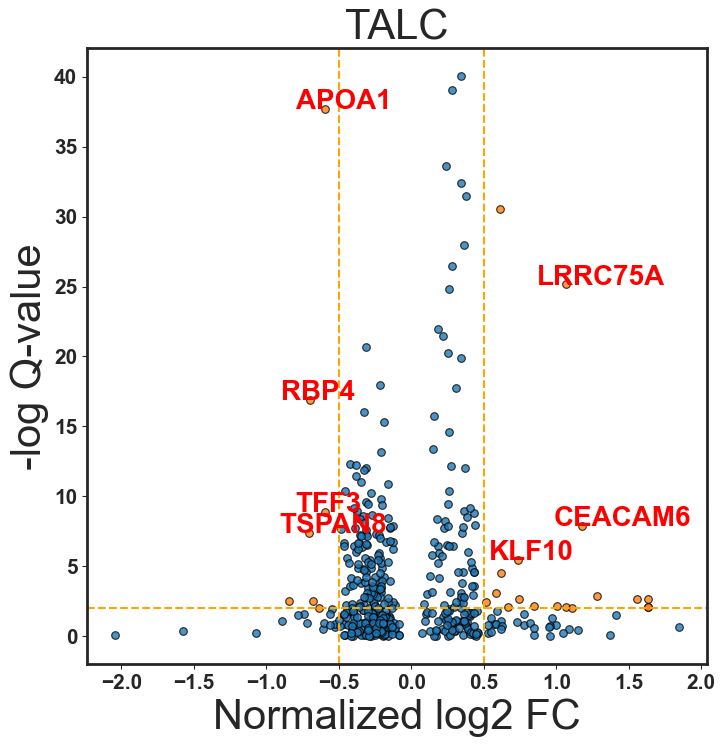

In [264]:
##### Volcano plot of results
from adjustText import adjust_text
plt.rcParams.update({'font.size': 20, 'font.weight': 'bold','axes.linewidth':2})
lowqval_de = terms[np.array(terms['-logQ']>=2) & np.array(abs(terms['normalized_effect'])>=0.5)]
other_de = terms[np.array(terms['-logQ']<2) | np.array(abs(terms['normalized_effect'])<0.5)]

fig, ax = plt.subplots()
sb.regplot(other_de['normalized_effect'], other_de['-logQ'], fit_reg=False, scatter_kws={'s':30, 'edgecolors': 'black', 'linewidths': 0.8})
sb.regplot(lowqval_de['normalized_effect'], lowqval_de['-logQ'], fit_reg=False, scatter_kws={'s':30,'edgecolors': 'black', 'linewidths': 0.8})
ax.set_xlabel("Normalized log2 FC", fontsize=30)
ax.set_ylabel("-log Q-value", fontsize=30)
ax.tick_params(labelsize=15)
ax.set_title('TALC',size = 30)
    
    
    
# Label names and positions
x = [i-0.2 for i in lowqval_de['normalized_effect']]
y = [i for i in lowqval_de['-logQ']]
labels = lowqval_de['gene_short_name']

# Show only some labels to avoid overcrowding the figure
to_remove = np.where(np.array(lowqval_de['gene_short_name'].str.startswith('RP'))|np.array(lowqval_de['gene_short_name'].str.startswith('MT'))
                     |np.array(lowqval_de['-logQ']<5))
labels = ["" if i in to_remove[0] else lab for i,lab in enumerate(labels) ]
texts = []
for i,txt in enumerate(labels):
    texts.append(ax.text(x[i], y[i], txt,size = 20, color= 'red', weight = 'bold'))

#adjust_text(texts)
    #ax.annotate(txt, (x[i], y[i]),size = 10,bbox=dict(boxstyle="Square,pad=0.3", fc="orange", ec="b", lw=2, alpha = 0.6))
    #plt.xlim([-0.6,0.65])
plt.axhline(y=2, color="orange", linestyle="--")
plt.axvline(x = -0.5, color="orange", linestyle="--")
plt.axvline(x = 0.5, color="orange", linestyle="--")
plt.savefig('f:/figures/detalc.jpg')

In [265]:
terms_ta = terms

In [267]:
all_terms =[terms_isc, terms_ta,terms_ec]

### Visualize by violin plots

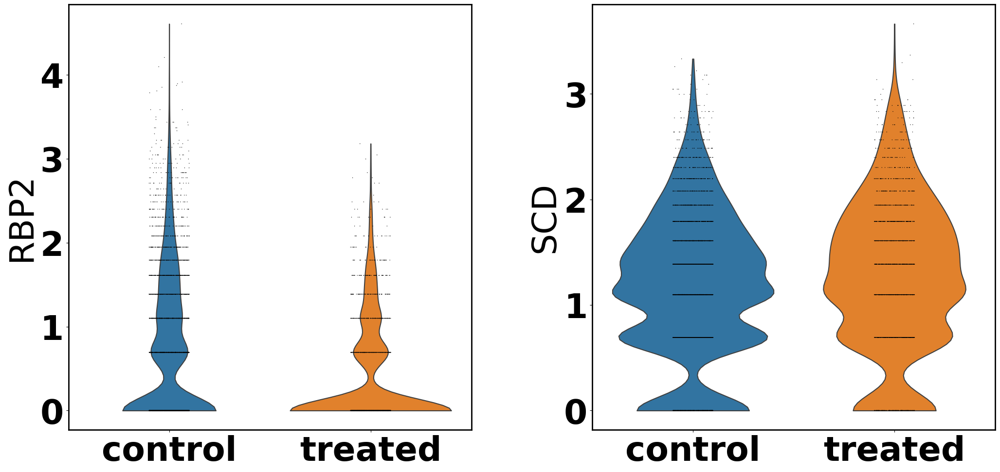

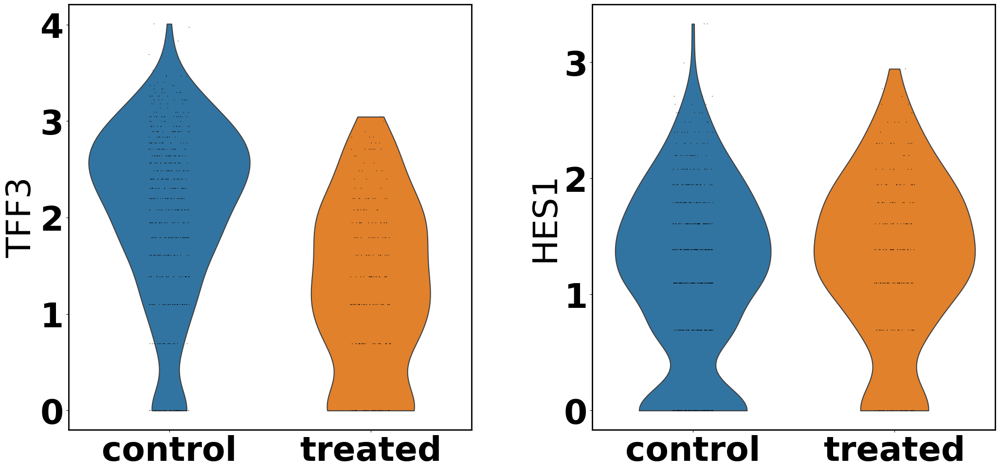

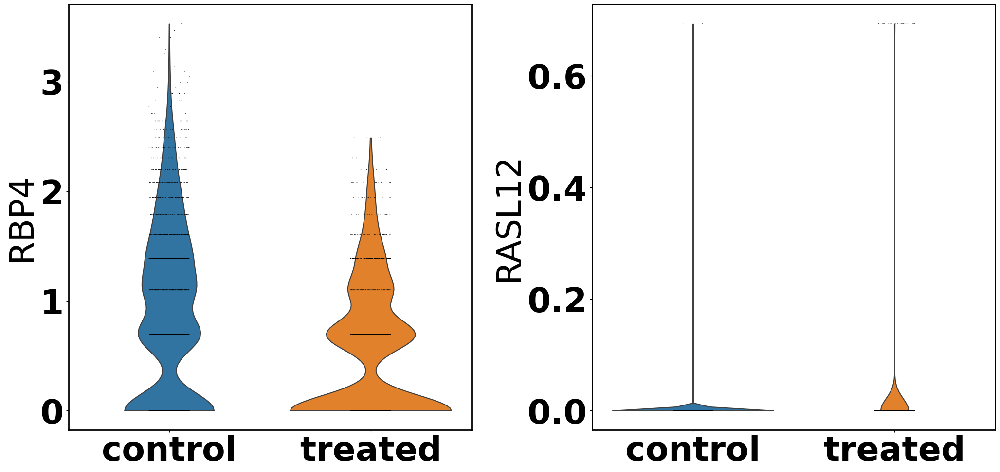

In [328]:
plt.rcParams.update({'font.size': 50, 'font.weight': 'heavy','axes.linewidth':2,'figure.figsize': [9,12]})
sc.pl.violin(ec,['RBP2','SCD'],groupby = 'condition_general' , scale ='area',xlabel = None, return_fig = True, save = 'ecdevio.png')
sc.pl.violin(isc,['TFF3','HES1'],groupby = 'condition_general' , scale ='area',xlabel = None, return_fig = True, save = 'iscdevio.png')
sc.pl.violin(talc,['RBP4','RASL12'],groupby = 'condition_general' , scale ='area',xlabel = None, return_fig = True, save = 'talcdevio.png')

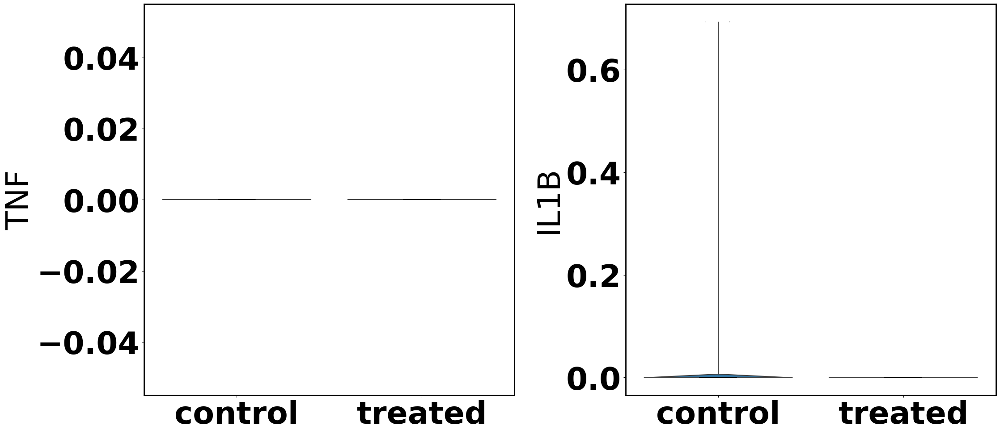

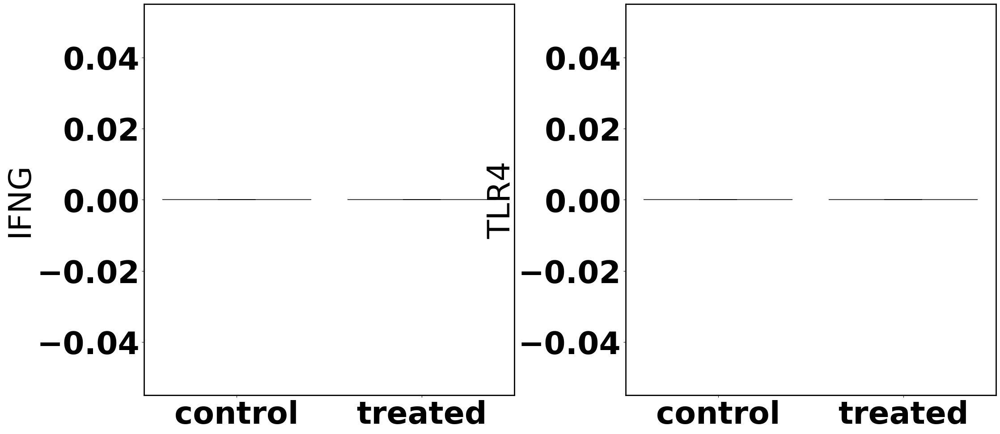

In [444]:
import matplotlib
matplotlib.rc_file_defaults()
plt.rcParams.update({'font.size': 50, 'font.weight': 'heavy','axes.linewidth':2,'figure.figsize': [9,12]})
#sc.pl.violin(adata,['TJP1','OCLN','CLDN1','CLDN7'],groupby = 'condition_general' , scale ='area',xlabel = None,save = 'junctions.png')
sc.pl.violin(adata_vis,['TNF','IL1B'],groupby = 'condition_general' , scale ='area',xlabel = None,save = 'inflam1.png')
sc.pl.violin(adata_vis,['IFNG','TLR4'],groupby = 'condition_general' , scale ='area',xlabel = None,save = 'inflam2.png')

## GSEA

### gseapy

#### ec up

In [376]:
import gseapy as gp

enr_GOBP_up = gp.enrichr(gene_list=terms_ec[np.array(terms_ec['-logQ']>-np.log10(0.05)) & np.array(terms_ec['normalized_effect']>0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/enr_DEGs_GOBP_ec',
 cutoff=0.5 
 )

In [377]:
enr_GOBP_up.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,neutrophil degranulation (GO:0043312),12/481,0.000003,0.000901,0,0,5.991523,76.344105,CNN2;ACLY;CEACAM1;NCSTN;GM2A;CEACAM6;IMPDH1;ALDH3B1;PSAP;SLC2A3;MAGT1;SLC2A5
1,GO_Biological_Process_2021,neutrophil activation involved in immune response (GO:0002283),12/485,0.000003,0.000901,0,0,5.939632,75.177905,CNN2;ACLY;CEACAM1;NCSTN;GM2A;CEACAM6;IMPDH1;ALDH3B1;PSAP;SLC2A3;MAGT1;SLC2A5
2,GO_Biological_Process_2021,neutrophil mediated immunity (GO:0002446),12/488,0.000003,0.000901,0,0,5.901286,74.319495,CNN2;ACLY;CEACAM1;NCSTN;GM2A;CEACAM6;IMPDH1;ALDH3B1;PSAP;SLC2A3;MAGT1;SLC2A5
3,GO_Biological_Process_2021,extracellular structure organization (GO:0043062),8/216,0.000009,0.001455,0,0,8.707781,101.337003,LOX;MMP15;COL6A1;LAMC2;LAMC1;AGRN;F11R;HSPG2
4,GO_Biological_Process_2021,external encapsulating structure organization (GO:0045229),8/217,0.000009,0.001455,0,0,8.665677,100.555035,LOX;MMP15;COL6A1;LAMC2;LAMC1;AGRN;F11R;HSPG2


In [394]:
from gseapy.plot import barplot, dotplot
barplot(enr_GOBP_up.res2d,title='GSEA: ECLC UP',color = 'r',figsize=(3, 5),top_term = 7)
plt.savefig('ec_gsea',bbox_inches='tight')

#### ec down

In [379]:
ec_GOBP_down = gp.enrichr(gene_list=terms_ec[np.array(terms_ec['-logQ']>-np.log10(0.05)) & np.array(terms_ec['normalized_effect']<-0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/ec_GOBP_down',
 cutoff=0.5 
 )

In [381]:
ec_GOBP_down.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,glutathione derivative biosynthetic process (GO:1901687),2/22,0.000076,0.004127,0,0,199.680000,1894.647073,GSTA2;GSTA1
1,GO_Biological_Process_2021,glutathione derivative metabolic process (GO:1901685),2/22,0.000076,0.004127,0,0,199.680000,1894.647073,GSTA2;GSTA1
2,GO_Biological_Process_2021,glutathione metabolic process (GO:0006749),2/43,0.000294,0.010680,0,0,97.302439,791.273330,GSTA2;GSTA1
3,GO_Biological_Process_2021,chemokine-mediated signaling pathway (GO:0070098),2/56,0.000499,0.012490,0,0,73.829630,561.298343,TFF2;CCL15
4,GO_Biological_Process_2021,cellular response to chemokine (GO:1990869),2/60,0.000573,0.012490,0,0,68.724138,513.008614,TFF2;CCL15


In [393]:
from gseapy.plot import barplot, dotplot
barplot(ec_GOBP_down.res2d,title='GSEA: ECLC DOWN',color = 'b',figsize=(3, 5),top_term = 7)
plt.savefig('ec_gsea_down',bbox_inches='tight')

#### isc up

In [395]:
isc_GOBP_up = gp.enrichr(gene_list=terms_isc[np.array(terms_isc['-logQ']>-np.log10(0.05)) & np.array(terms_isc['normalized_effect']>0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/isc_GOBP_up',
 cutoff=0.5 
 )

In [396]:
isc_GOBP_up.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,SREBP signaling pathway (GO:0032933),2/8,0.000008,0.001546,0,0,740.111111,8715.627567,INSIG1;SREBF2
1,GO_Biological_Process_2021,cellular response to sterol depletion (GO:0071501),2/9,0.000010,0.001546,0,0,634.349206,7310.931552,INSIG1;SREBF2
2,GO_Biological_Process_2021,regulation of lipid metabolic process (GO:0019216),3/92,0.000015,0.001579,0,0,83.848315,930.607310,SCD;PSAP;SREBF2
3,GO_Biological_Process_2021,regulation of primary metabolic process (GO:0080090),3/130,0.000043,0.003335,0,0,58.647638,590.182813,SCD;PSAP;SREBF2
4,GO_Biological_Process_2021,extracellular structure organization (GO:0043062),3/216,0.000192,0.010168,0,0,34.816901,297.913057,LAMA1;TGFBI;THBS1


In [398]:
barplot(isc_GOBP_up.res2d,title='GSEA: ISCLC UP',color = 'r',figsize=(3, 5),top_term = 7)
plt.savefig('isc_gsea_up',bbox_inches='tight')

#### isc down

In [399]:
isc_GOBP_down = gp.enrichr(gene_list=terms_isc[np.array(terms_isc['-logQ']>-np.log10(0.05)) & np.array(terms_isc['normalized_effect']<-0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/isc_GOBP_down',
 cutoff=0.5 
 )

In [400]:
isc_GOBP_down.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,epithelial structure maintenance (GO:0010669),2/18,0.000021,0.001313,0,0,416.166667,4475.619360,TFF3;TFF2
1,GO_Biological_Process_2021,maintenance of gastrointestinal epithelium (GO:0030277),2/18,0.000021,0.001313,0,0,416.166667,4475.619360,TFF3;TFF2
2,GO_Biological_Process_2021,cellular response to oxidative stress (GO:0034599),2/125,0.001059,0.036809,0,0,53.845528,368.883425,PRDX2;FOS
3,GO_Biological_Process_2021,regulation of protein lipidation (GO:1903059),1/6,0.002398,0.036809,0,0,571.057143,3445.289983,DBI
4,GO_Biological_Process_2021,negative regulation of digestive system process (GO:0060457),1/7,0.002797,0.036809,0,0,475.857143,2797.660500,TFF2


In [402]:
barplot(isc_GOBP_down.res2d,title='GSEA: ISCLC DOWN',color = 'b',figsize=(3, 5),top_term = 7)
plt.savefig('isc_gsea_down',bbox_inches='tight')

#### ta up

In [403]:
ta_GOBP_up = gp.enrichr(gene_list=terms_ta[np.array(terms_ta['-logQ']>-np.log10(0.05)) & np.array(terms_ta['normalized_effect']>0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/ta_GOBP_up',
 cutoff=0.5 
 )

In [404]:
ta_GOBP_up.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,positive regulation of heterotypic cell-cell adhesion (GO:0034116),2/15,0.000120,0.031333,0,0,153.576923,1386.201747,CEACAM6;AGER
1,GO_Biological_Process_2021,positive regulation of activated T cell proliferation (GO:0042104),2/20,0.000217,0.031333,0,0,110.888889,935.499801,CD24;AGER
2,GO_Biological_Process_2021,regulation of heterotypic cell-cell adhesion (GO:0034114),2/25,0.000341,0.032872,0,0,86.760870,692.606882,CEACAM6;AGER
3,GO_Biological_Process_2021,regulation of activated T cell proliferation (GO:0046006),2/34,0.000634,0.043438,0,0,62.331250,458.944557,CD24;AGER
4,GO_Biological_Process_2021,positive regulation of exocytosis (GO:0045921),2/37,0.000752,0.043438,0,0,56.980000,409.881123,UNC13D;CFTR


In [410]:
barplot(ta_GOBP_up.res2d,title='GSEA: TALC UP',color = 'r',figsize=(3, 5),top_term = 5)
plt.savefig('ta_gsea_up',bbox_inches='tight')

#### ta down

In [407]:
ta_GOBP_down = gp.enrichr(gene_list=terms_ta[np.array(terms_ta['-logQ']>-np.log10(0.05)) & np.array(terms_ta['normalized_effect']<-0.5)]['gene_short_name'].tolist() ,
 gene_sets=['GO_Biological_Process_2021'],
 organism='Human', 
 outdir='test/ta_GOBP_down',
 cutoff=0.5 
 )

In [408]:
ta_GOBP_down.results.head(5)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,epithelial structure maintenance (GO:0010669),3/18,1.005290e-07,0.000014,0,0,499.350000,8045.936335,RBP4;TFF3;TFF2
1,GO_Biological_Process_2021,maintenance of gastrointestinal epithelium (GO:0030277),3/18,1.005290e-07,0.000014,0,0,499.350000,8045.936335,RBP4;TFF3;TFF2
2,GO_Biological_Process_2021,diterpenoid metabolic process (GO:0016101),3/64,5.062739e-06,0.000462,0,0,122.508197,1493.816296,RBP4;RBP2;APOA1
3,GO_Biological_Process_2021,retinoid metabolic process (GO:0001523),3/92,1.513198e-05,0.001037,0,0,83.848315,930.607310,RBP4;RBP2;APOA1
4,GO_Biological_Process_2021,regulation of heterotypic cell-cell adhesion (GO:0034114),2/25,8.193318e-05,0.004490,0,0,192.908213,1815.190364,FGG;APOA1


In [411]:
barplot(ta_GOBP_down.res2d,title='GSEA: TALC DOWN',color = 'b',figsize=(3, 5),top_term = 5)
plt.savefig('ta_gsea_down',bbox_inches='tight')

## Make an object with missing genes for visualization

In [10]:
adata1 = sc.read_10x_h5('C1_filtered_feature_bc_matrix.h5')
full_genes = adata1.var_names
del(adata1)

reading C1_filtered_feature_bc_matrix.h5
 (0:00:00)


In [11]:
missing = full_genes[full_genes.isin(adata.var_names) == 0]

In [12]:
import anndata
import scipy
adata_vis = anndata.AnnData(X = scipy.sparse.hstack((adata.X, scipy.sparse.csr_array((len(adata.obs_names),len(missing))))))
adata_vis.var_names = list(adata.var_names) + list(missing.values.ravel())
adata_vis.obs_names = adata.obs_names
adata_vis.obs = adata.obs

In [13]:
adata_vis

AnnData object with n_obs × n_vars = 13784 × 33542
    obs: 'n_counts', 'n_genes', 'condition', 'phase', 'mt_frac', 'ribo_frac', 'leiden', 'condition_general', 'leiden8', 'overallannotated', 'detailannotated', 'verydetailannotated', 'roughannotated', 'leiden2', 'leiden3', 'leiden4', 'leiden5', 'leiden6'

## Figures

### Composition pie chart

([<matplotlib.patches.Wedge at 0x1802ba1bfd0>,
 [Text(-0.19452344026673324, 1.0826636740866458, 'ISCLC'),
  Text(-1.062301829719143, 0.28550800790058545, 'TALC'),
  Text(0.5581579906758595, -0.9478711185834746, 'ECLC'),
  Text(1.941061315983247, 0.8014243367863156, 'SECPLC'),
  Text(1.9049506476212734, 0.8838342775245207, 'GCLC'),
  Text(1.8291694796725917, 1.0315711389110787, 'Early EECLC'),
  Text(0.7016527714966758, 0.847161961050562, 'U-HT29'),
  Text(0.22479363257931917, 1.0767858759993996, 'D-HT29'),
  Text(0.017548345951224602, 1.0998600163449785, 'FLC')],
 [Text(-0.1061036946909454, 0.5905438222290794, '5.7%'),
  Text(-0.5794373616649872, 0.1557316406730466, '30.3%'),
  Text(0.3044498130959233, -0.5170206101364406, '45.0%'),
  Text(1.4789038597967594, 0.6106090185038595, '0.6%'),
  Text(1.4513909696162082, 0.6733975447805871, '0.8%'),
  Text(1.3936529368934032, 0.7859589629798693, '1.7%'),
  Text(0.3827196935436413, 0.46208834239121555, '9.9%'),
  Text(0.12261470867962862, 0.58

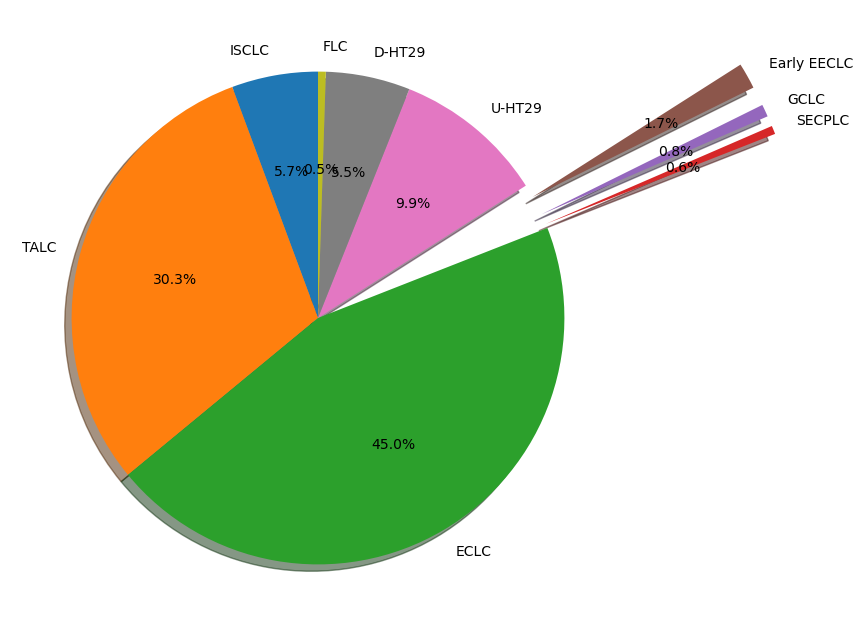

In [173]:
explode = [0,0,0,1,1,1,0,0,0]
plt.pie(np.array(adata.obs.groupby('overallannotated').size())/len(adata.obs_names), labels = np.array(adata.obs['overallannotated'].cat.categories),autopct='%1.1f%%',explode = explode,shadow=True, startangle=90)

In [447]:
fig, ax = plt.subplots(figsize=(8, 8))

recipe = adata.obs['overallannotated'].cat.categories

data = adata.obs.groupby('overallannotated').size()

w,l,p = ax.pie(data, wedgeprops=dict(width=0.5), startangle=-40,autopct='%1.1f%%',pctdistance = 1.15)

ax.legend(wedges, np.array(adata.obs['overallannotated'].cat.categories),
          title="Cell types",
          loc="center left",
          bbox_to_anchor=(1, 0, 0.5, 1))
[t.set_fontsize(20) for t in p]
plt.savefig('comp_pie.png',bbox_inches='tight')

In [ ]:
import plotly.express as px
plt.close()
df = pd.DataFrame()
df['cell type'] = adata.obs['overallannotated'].cat.categories
df['count'] = adata.obs.groupby('overallannotated').size()
fig = px.pie(df, values='count', names='cell type')
fig.write_image("fig1.png")

### Basic Cluster Map

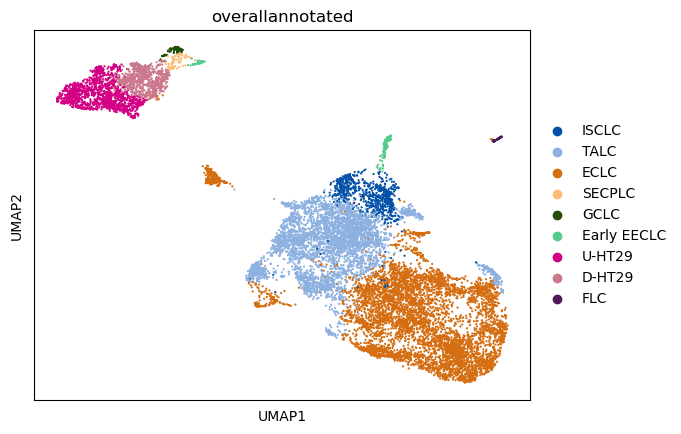

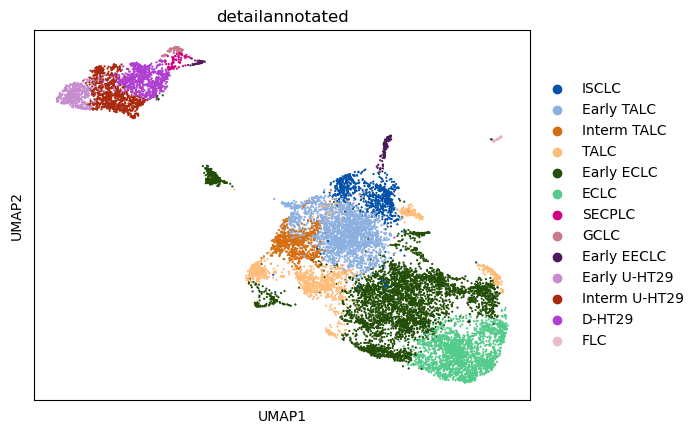

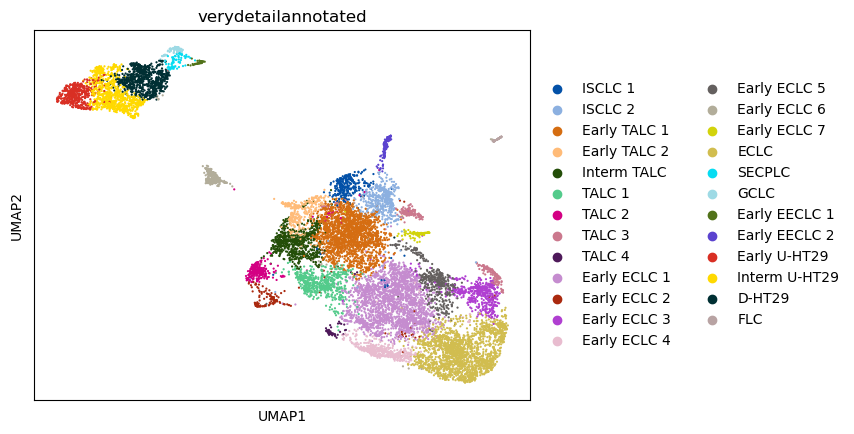

In [446]:
matplotlib.rc_file_defaults()
sc.pl.umap(adata, color=['overallannotated'] ,size = 10, palette  = my_pallete,save = 'general.png')
sc.pl.umap(adata, color=['detailannotated'] ,size = 10, palette  = my_pallete,save = 'detail.png')
sc.pl.umap(adata, color=['verydetailannotated'] ,size = 10, palette  = my_pallete,save = 'verydetail.png')

### Density map

In [143]:
adata.obs['cond_general'] = ['control' if reg!='treated' else 'treated' for reg in adata.obs['condition']]
sc.tl.embedding_density(adata, basis='umap', groupby='cond_general')

computing density on 'umap'
--> added
    'umap_density_cond_general', densities (adata.obs)
    'umap_density_cond_general_params', parameter (adata.uns)


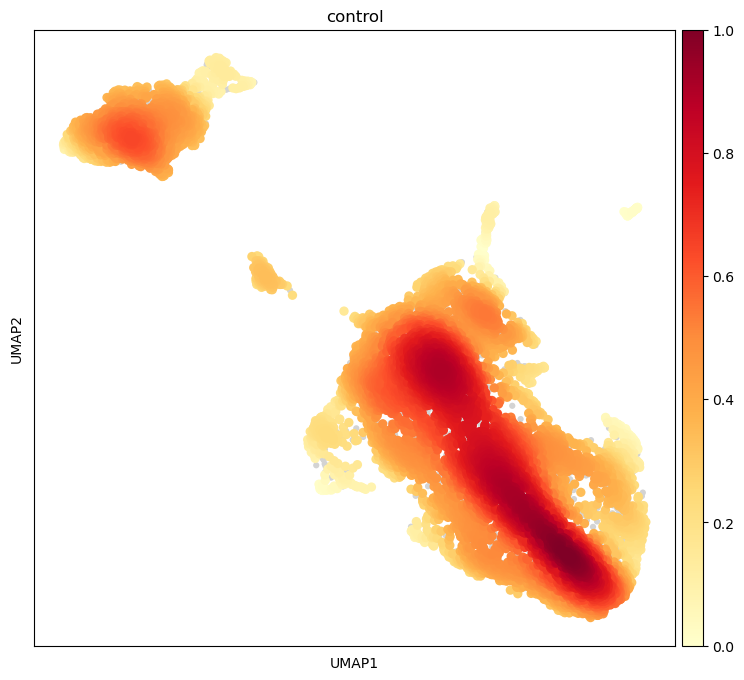

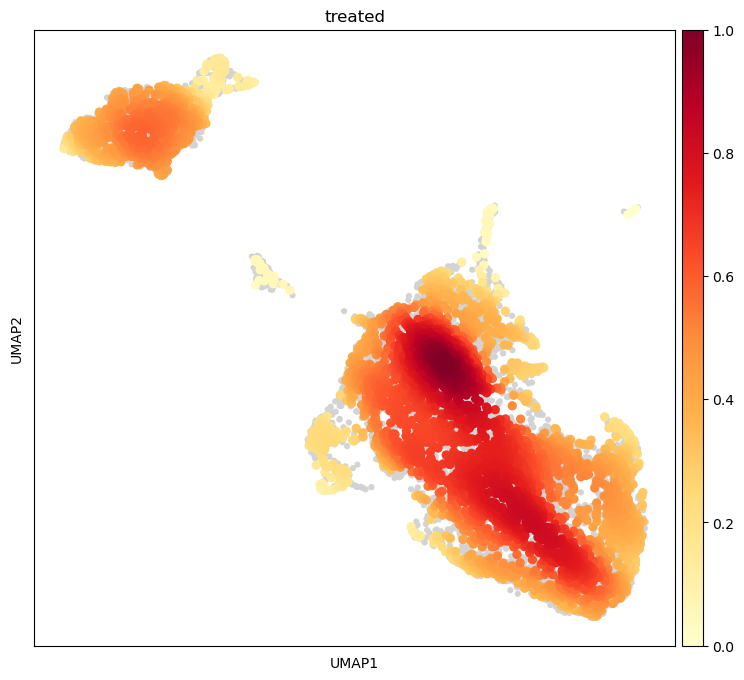

In [146]:
adata.obs['cond_general'].value_counts()
sc.pl.embedding_density(adata, basis='umap', key='umap_density_cond_general', group='control')
sc.pl.embedding_density(adata, basis='umap', key='umap_density_cond_general', group='treated')

### Conditions' fractions bar plot

In [ ]:
treated_frac = pd.DataFrame()
for i in set(adata.obs['celltype']):
    additional = pd.DataFrame({
        i: [np.sum(np.array(adata.obs['celltype']==i)&np.array(adata.obs['batch']=='treated')) / np.sum(adata.obs['celltype']==i)]
    })
    treated_frac = pd.concat([treated_frac, additional], ignore_index=False, axis=1)
control_frac = 1 - treated_frac.values
group_names = treated_frac.columns
treated_frac = treated_frac.T
#treated_frac['groups'] = group_names
treated_frac['control fraction'] = np.transpose(control_frac)
treated_frac = treated_frac.rename(columns = {0:'treated fraction'})

In [51]:
treated_frac = treated_frac.sort_values(by = 'treated fraction')

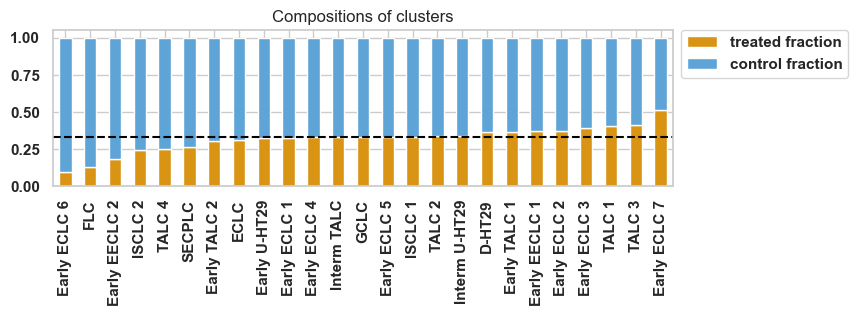

In [196]:
treated_frac.plot.bar(stacked = True, title ='Compositions of clusters', color = ['#d99414','#5ea4d6']).legend(bbox_to_anchor=(1, 1.05))
plt.axhline(y=np.sum(np.array(adata.obs['condition']=='treated')/adata.shape[0]), color="black", linestyle="--")
plt.gca().set_aspect(6)
plt.savefig('comp_composition.png',bbox_inches='tight')

### Visualize the expression of markers in different clusters by using dot plots

In [580]:
marker_genes = dict()
marker_genes['Stem'] = ['LGR5', 'ASCL2','SMOC2','AXIN2']
marker_genes['Cancer Stem'] = ['SOX2','PROM1','CD44','CD24','BMP4']
marker_genes['Paneth'] = ['REG3A','ITLN2','PLA2G2A','LYZ','DLL4'] # No paneth in colon
marker_genes['Transit_amplifying'] = ['MKI67','TOP2A','CENPA','MXD3','FOXM1','PCNA','EPHB2','MSI1'] # Divide this into G1 and G2, HES1 commit to ent
marker_genes['Goblet'] = ['SPDEF', 'FCGBP', 'ZG16', 'MUC2','TFF3','BEST2'] #(ATOH1) # Divide this into secretory progenitor?? BEST2 specifically for colon goblet
marker_genes['Secretory_Progenitors'] = ['ATOH1','DLL1']
marker_genes['BEST4_enterocytes'] = ['BEST4','OTOP2','CA7','SPIB']
#marker_genes['Enterocyte'] = ['RBP2','ANPEP', 'FABP2']
marker_genes['Colonocytes'] = ['CA1','SLC26A3','CEACAM7','FABP1','CA2','SLC26A2'] # DIVIDE this into mature and immature (BATF2)
#marker_genes['Microfold_cells'] = ['SPIB', 'GP2','IGHA1']
marker_genes['Tuft'] = ['POU2F3', 'LRMP', 'TRPM5','AZGP1','AVIL']
marker_genes['Enteroendocrine'] = ['CHGA', 'CHGB']
marker_genes['Neural'] = ['ETV1','BNC2']

In [1898]:
marker_genes = dict()
marker_genes['Stem'] = ['LGR5','SMOC2','ASCL2']
marker_genes['Fetal Stem'] = ['AFP','FGB','FGG','PLA2G2A']
marker_genes['Cancer Stem'] = ['CD24','CD44','PROM1','SOX2']
marker_genes['Proliferative'] = ['MKI67','TOP2A']
marker_genes['Other Signature'] = ['DKK1','GNRH2','EPCAM']

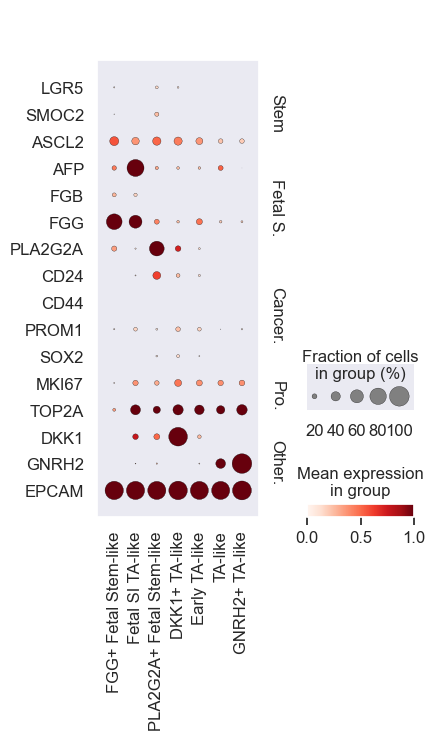

In [1899]:
sc.pl.dotplot(adata[adata.obs['leiden6'].isin(['0-5,3','0-5,4','0-5,0','0-5,5','1','7,1','6,1']),:],
              marker_genes, 'celltype', 
              layer  = 'counts', vmax =1, swap_axes = True, dot_min = 0.05, 
              categories_order = ['FGG+ Fetal Stem-like','Fetal SI TA-like', 'PLA2G2A+ Fetal Stem-like', 'DKK1+ TA-like','Early TA-like','TA-like', 'GNRH2+ TA-like'])

In [ ]:
fig, axs = plt.subplots(1,2)
plt.figure(figsize = (9,8))
p = sns.color_palette("blend:#000000,#FF0000", as_cmap=True)
axs[0] = sns.scatterplot(HT29.obsm['X_pca'][:,0],HT29.obsm['X_pca'][:,1], hue = path2, palette =p,legend = False)
plt.plot()
norm2 = plt.Normalize(path1.min(), path1.max())
sm = plt.cm.ScalarMappable(norm=norm2, cmap = p)
sm.set_array([])
axs[0].figure.colorbar(sm,label = 'pseudotime',ticks = [])
axs[0].set_xticks([])
axs[0].set_yticks([])
plt.xlabel('PC1',fontsize = 20,fontweight = 'semibold')
plt.ylabel('PC2',fontsize = 20,fontweight = 'semibold')

### Heatmap of signature genes expression comparison

In [10]:
sc.tl.rank_genes_groups(adata, groupby='overallannotated', key_added='rank',method = 'wilcoxon')

ranking genes
    finished: added to `.uns['rank']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:23)


In [11]:
pass_genes = pd.DataFrame()
for i in set(adata.obs['overallannotated']):
    log2foldmask = adata.uns['rank']['logfoldchanges'][i].astype('double')>2
    pvalmask = adata.uns['rank']['pvals_adj'][i].astype('double')<0.01
    additional = pd.DataFrame({
        i: adata.uns['rank']['names'][i].astype('str')[log2foldmask & pvalmask]
    })
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

In [12]:
pass_genes= pass_genes[['ISCLC','TALC','SECPLC','GCLC','Early EECLC']]
pass_genes_reduced = pass_genes.iloc[0:100,:]

In [13]:
pass_genes.to_excel('brief_signature.xlsx')

In [39]:
human_DE = pd.read_excel('human_DE.xlsx')
human_DE

,SI ISC,C ISC,SI TA,SI TA2,C TA,SI Sec. Prog,C Sec. Prog,SI Goblet,C Goblet,SI EEC,C EEC
0,RARRES2,SMOC2,CDC45,AL118516.1,CDK2,TEAD2,TCF4,FAM177B,B3GNT6,MAP6,MARCH4
1,CEL,LGR5,FIGNL1,AL031963.3,NDC1,NHEJ1,MEX3A,MUC2,CLCA1,DUSP26,ELAVL4
2,PIWIL2,CYP4X1,LIG1,PTTG1,MCM5,SOX4,DNAL1,NXPE1,CAPN9,BAALC,PPP2R2B
3,GDF15,GDF15,CCNF,CCNB2,DEPDC1,ASF1A,MORC4,AKAP5,TAGLN,CDK5R2,NRXN1
4,CLDN2,ASCL2,MSH2,CENPF,TBCD,RCN2,PGBD1,FER1L6,LINC00261,CHST9,NLRP1
...,...,...,...,...,...,...,...,...,...,...,...
94,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MRPS6,SGSM3,GABRB3,SLC8A1
95,NaN,NaN,NaN,NaN,NaN,NaN,NaN,ARF4,WIPI1,SSTR2,CDKN1C
96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,MB,SIDT2,KCNB2,CDHR3
97,NaN,NaN,NaN,NaN,NaN,NaN,NaN,KDELR2,FOXA3,DHRS2,SCTR


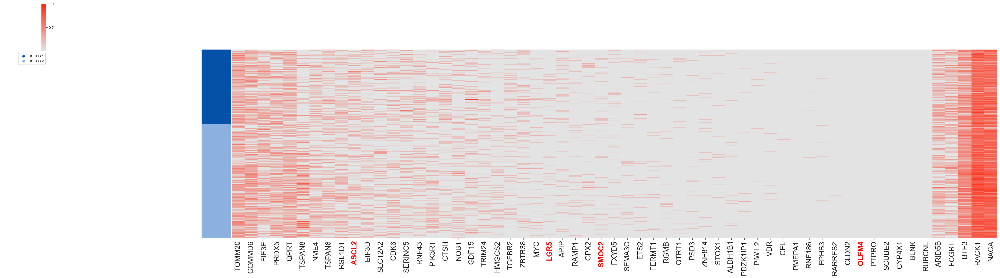

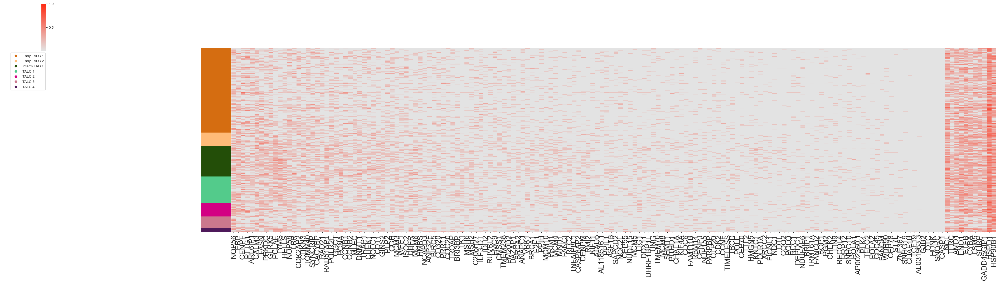

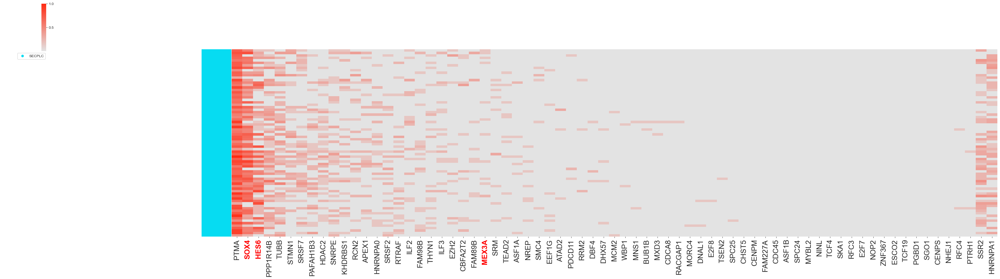

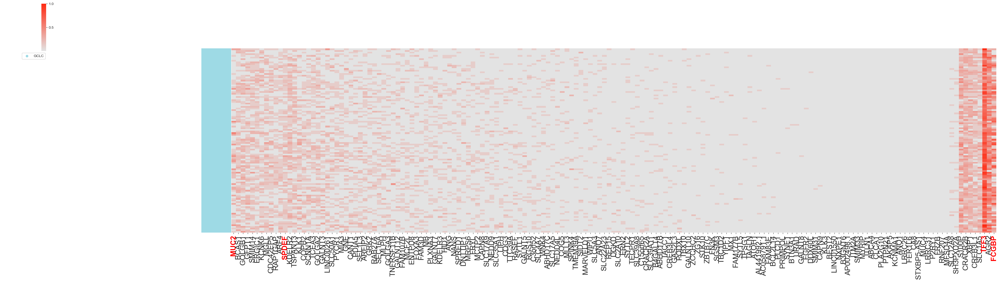

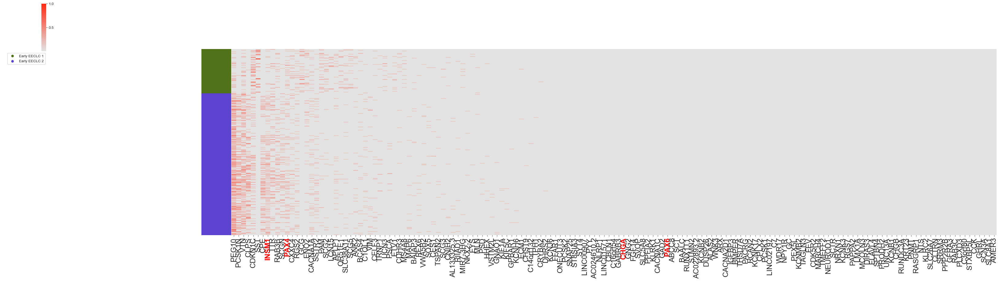

In [40]:
names = ['ISC','TA','Sec. Progenitor','Goblet','EEC']

imp_genes = dict()
imp_genes['ISC'] = ['LGR5', 'ASCL2','SMOC2','MSI1','OLFM4']
imp_genes['TA'] = ['MKI67','TOP2A','HES1']
imp_genes['Sec. Progenitor'] = ['HES6','SOX4','HOPX','ATOH1','MEX3A']
imp_genes['Goblet'] = ['MUC2','MUC5AC','FCGBP','SOX4','SPDEF', 'FCGBP','TFF3']
imp_genes['EEC'] = ['CHGA','CHGGB','INSM1','PAX4','PAX6']

our_names = pass_genes.columns
groups = [[0,1],[2,3,4],[5,6],[7,8],[9,10]] 
intersect = dict()
humansign = dict()
sorted_human= dict()
adata_vis.var_names_make_unique()
for i in range(0,len(names)):
    humansign[names[i]] = np.array(human_DE[human_DE.columns[groups[i]]].dropna().values.ravel())
    q = [i.startswith('RP')==0 for i in humansign[names[i]]]
    humansign[names[i]] = humansign[names[i]][q]
    
    intersect[names[i]] = set(humansign[names[i]]).intersection(set(pass_genes[our_names[i]]))
    
    
    sub_adata = adata_vis[adata_vis.obs['overallannotated']==our_names[i],adata_vis.var_names.isin(humansign[names[i]])]
    cmdf = pd.DataFrame(sub_adata.X.A,
                    columns = sub_adata.var_names)
    cmdf['sort'] = sub_adata.obs['verydetailannotated'].values.ravel()
    cmdf = cmdf.sort_values(by = 'sort')
    
    
    color = np.array(cmdf['sort'].values.ravel())
    for j in range(0, len(color)):
        id = np.where(adata.obs['verydetailannotated'].cat.categories == color[j])[0][0]
        color[j]=adata.uns['verydetailannotated_colors'][id]
    del(cmdf['sort'])
    cmdf = (cmdf-cmdf.min().min())/(cmdf.max().max()-cmdf.min().min()+ 0.000001)+ 0.0001
    
    z=sns.clustermap(cmdf,row_cluster = False,yticklabels = False,xticklabels=True,figsize = [38,10],cmap=my_cmap, row_colors = color,cbar_kws={"ticks":[0,0.5,1]})
    
    z.cax.set_aspect(10)
    z.ax_col_dendrogram.set_visible(False)
    z.cax.tick_params
    ax= z.fig.get_axes()
    ax[3].xaxis.set_tick_params(labelsize=20)
    xtick = ax[3].get_xticklabels()
    sorted_human[names[i]] = [i.get_text() for i in xtick]
    
    current_handles = []
    for k in range (0,len(sub_adata.obs['verydetailannotated'].cat.categories)):
        id = np.where(adata.obs['verydetailannotated'].cat.categories == sub_adata.obs['verydetailannotated'].cat.categories[k])[0][0]
        color=adata.uns['verydetailannotated_colors'][id]
        current_handles.append(plt.scatter(np.nan,np.nan,color = color, label = list(sub_adata.obs['verydetailannotated'].cat.categories)[k]))

        
    for lab in ax[3].get_xticklabels():
        text =  lab.get_text()
        if text in imp_genes[names[i]]:
        # set the properties of the ticklabel
            lab.set_weight('bold')
            lab.set_color('red')
    
    plt.legend(handles = current_handles,bbox_to_anchor=(1.2,0))
    plt.savefig(names[i]+'humansig2.jpg',bbox_inches='tight')

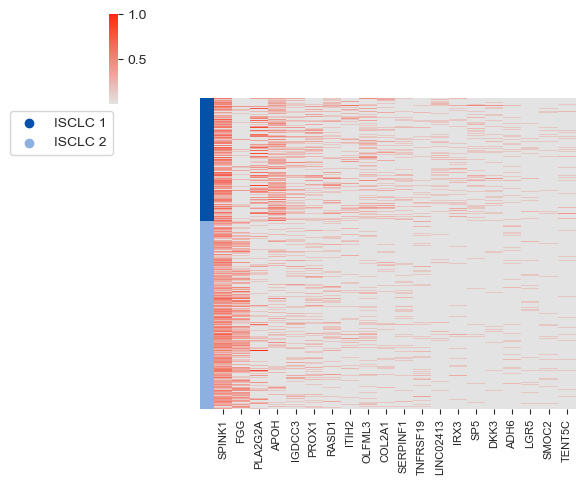

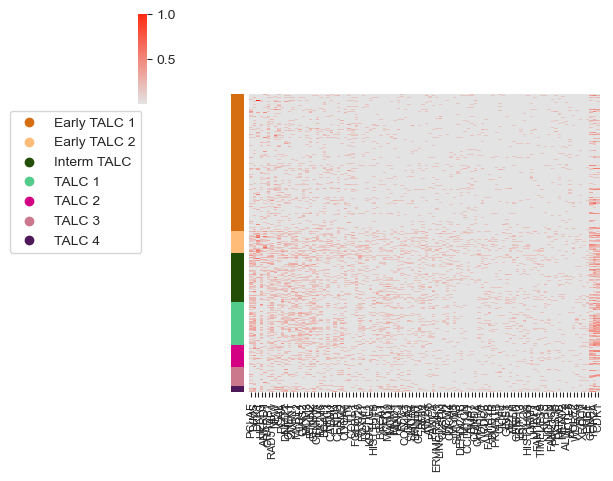

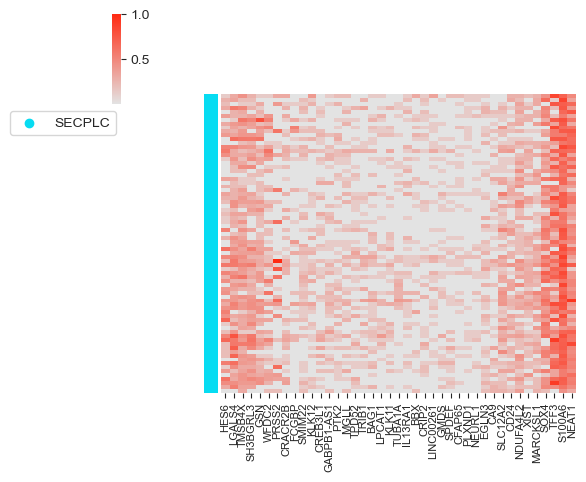

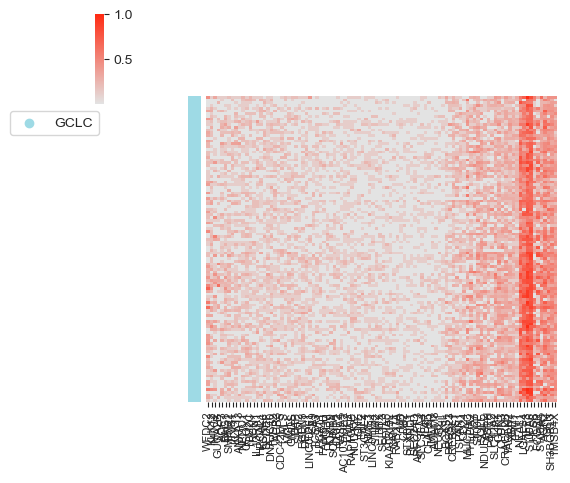

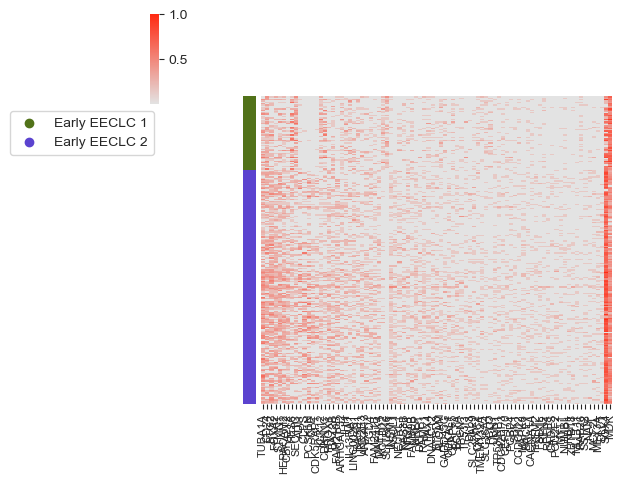

In [15]:
names = ['ISC','TA','Sec. Progenitor','Goblet','EEC']
our_names = pass_genes.columns
groups = [[0,1],[2,3,4],[5,6],[7,8],[9,10]] 
adata_vis.var_names_make_unique()
exp_genes = dict()
sorted_our= dict()
for i in range(0,5):
    sub_adata_0 = adata_vis[adata_vis.obs['overallannotated']==our_names[i],:]
    sub_adata = adata_vis[adata_vis.obs['overallannotated']==our_names[i],pass_genes_reduced[our_names[i]].dropna()]
    cmdf = pd.DataFrame(sub_adata.X.A,
                    columns = sub_adata.var_names)
    cmdf['sort'] = sub_adata.obs['verydetailannotated'].values.ravel()
    cmdf = cmdf.sort_values(by = 'sort')
    
    
    color = np.array(cmdf['sort'].values.ravel())
    for j in range(0, len(color)):
        id = np.where(adata.obs['verydetailannotated'].cat.categories == color[j])[0][0]
        color[j]=adata.uns['verydetailannotated_colors'][id]
    del(cmdf['sort'])
    cmdf = (cmdf-cmdf.min().min())/(cmdf.max().max()-cmdf.min().min()+ 0.000001)+ 0.0001
    
    z=sns.clustermap(cmdf,row_cluster = False,yticklabels = False,xticklabels=True,figsize = [5,5],cmap=my_cmap, row_colors = color,cbar_kws={"ticks":[0,0.5,1]})
    
    z.cax.set_aspect(10)
    z.ax_col_dendrogram.set_visible(False)
    z.cax.tick_params
    ax= z.fig.get_axes()
    ax[3].xaxis.set_tick_params(labelsize=8)
    xtick = ax[3].get_xticklabels()
    sorted_our[names[i]] = [i.get_text() for i in xtick]
    
    nonzero_counts = sub_adata_0.X.A!= 0
    cells_of_genes = nonzero_counts.sum(axis = 0)
    exp_genes[names[i]] = sub_adata_0.var_names[np.where(cells_of_genes>= 0.3*len(sub_adata_0.obs_names))]


    current_handles = []
    for k in range (0,len(sub_adata.obs['verydetailannotated'].cat.categories)):
        id = np.where(adata.obs['verydetailannotated'].cat.categories == sub_adata.obs['verydetailannotated'].cat.categories[k])[0][0]
        color=adata.uns['verydetailannotated_colors'][id]
        current_handles.append(plt.scatter(np.nan,np.nan,color = color, label = list(sub_adata.obs['verydetailannotated'].cat.categories)[k]))
        
    plt.legend(handles = current_handles,bbox_to_anchor=(1.2,0))
    #plt.show()
    plt.savefig(names[i]+'oursig.jpg',bbox_inches='tight')

In [16]:
sorted_our_df = pd.DataFrame()
for i in sorted_our.keys():
    additional = pd.DataFrame({
        i: sorted_our[i]
    })
    sorted_our_df = pd.concat([sorted_our_df, additional], ignore_index=False, axis=1)
sorted_our_df.to_excel('our_de.xlsx')

In [19]:
exp_genes_df = pd.DataFrame()
for i in sorted_our.keys():
    additional = pd.DataFrame({
        i: exp_genes[i]
    })
    exp_genes_df = pd.concat([exp_genes_df, additional], ignore_index=False, axis=1)

### Venn diagram of commonly expressed genes in human and model

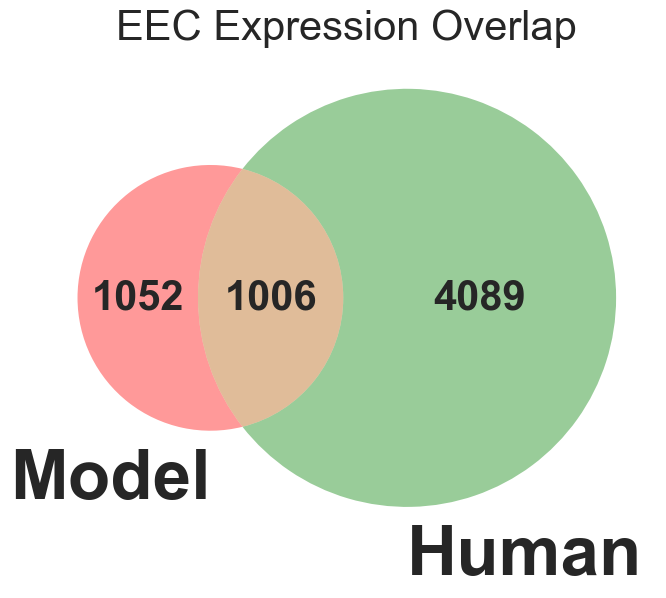

In [374]:
from matplotlib_venn import venn2
import inspect
dir(venn2)

exp_intersection = dict()
for i in exp_genes_df.columns:
    plt.close()
    exp_intersection[i] = set(exp_genes_df[i].dropna()).intersection(set(exp_human[i].dropna()))
    out = venn2(subsets = [len(exp_genes_df[i].dropna()), len(exp_human[i].dropna()), len(exp_intersection[i])], set_labels = ['Model', 'Human'])
    for text in out.subset_labels:
        text.set_fontsize(30)
    for text in out.set_labels:
        text.set_fontsize(50)
    plt.title(i+' Expression Overlap',size = 30)
    #plt.show()
    plt.savefig(i+'_venn_exp.jpg',bbox_inches='tight')

In [301]:

# Use the venn2 function


  Preparing metadata (setup.py): started
  Preparing metadata (setup.py): finished with status 'done'
  Created wheel for matplotlib_venn: filename=matplotlib_venn-0.11.7-py3-none-any.whl size=32155 sha256=eae99692b48ed5b1a0153850c202eb7e0e1b1dd9f1b1baf6c69ccb7ba577c213
  Stored in directory: c:\users\16220\appdata\local\pip\cache\wheels\32\41\5f\d0f29cd092d042d8e8a87d7bbe42193166aa555ff38b377343
Successfully built matplotlib_venn


### UMAP of cell subpopulations

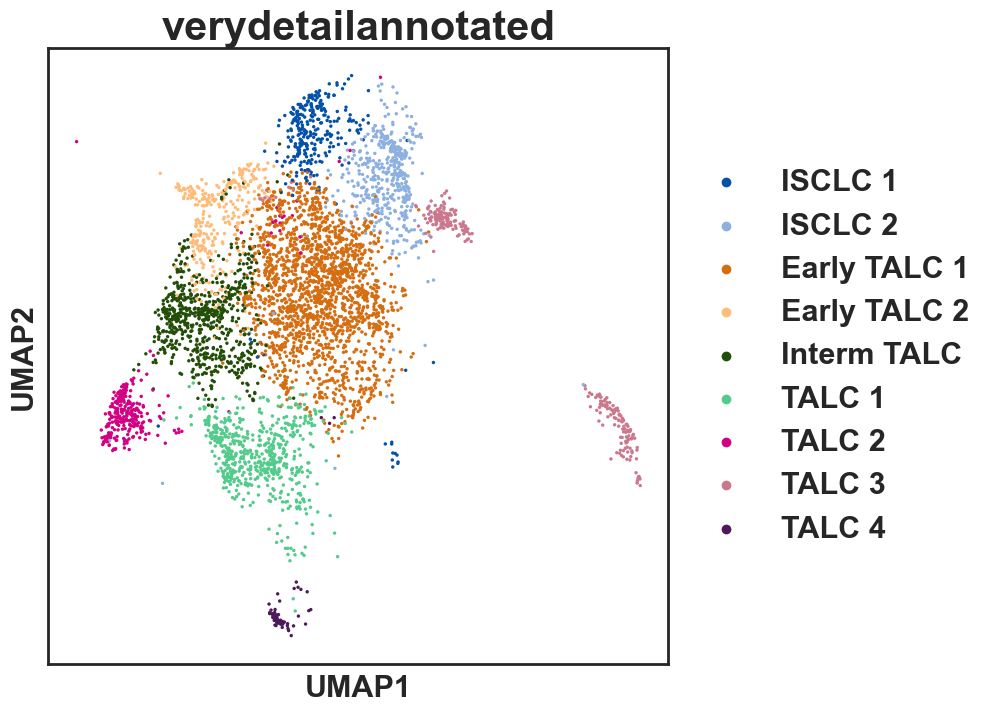

In [373]:
fig = sc.pl.umap(adata[adata.obs['overallannotated'].isin(['ISCLC','TALC']),:], color = ['verydetailannotated'], ncols = 5 ,return_fig = True,cmap = my_cmap)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('ISCTApart.png')

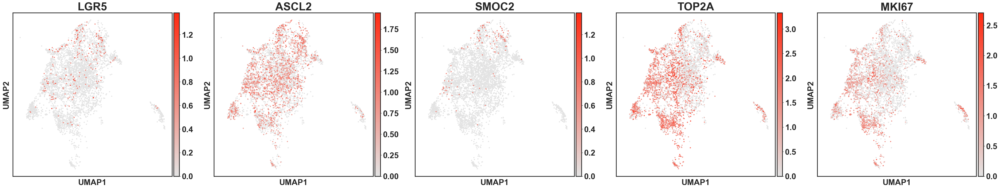

In [403]:
fig = sc.pl.umap(adata[adata.obs['overallannotated'].isin(['ISCLC','TALC']),:],color=['LGR5', 'ASCL2','SMOC2','TOP2A','MKI67'],size =40,ncols = 5,save = 'EC_map.png',cmap = my_cmap,return_fig = True,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('stem_map.png')

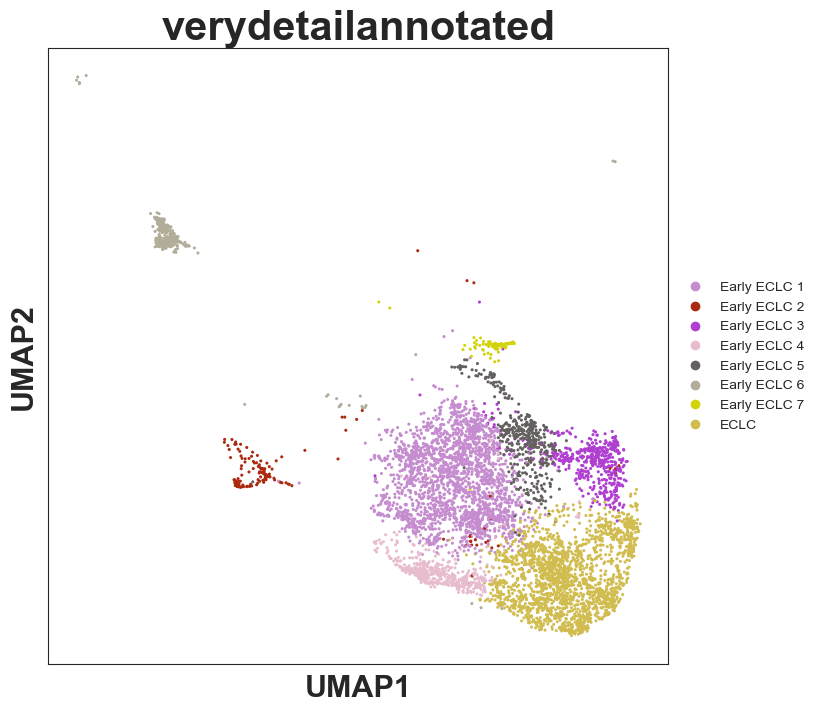

In [42]:
fig = sc.pl.umap(adata[adata.obs['overallannotated'].isin(['ECLC']),:], color = ['verydetailannotated'], ncols = 5 ,return_fig = True,cmap = my_cmap)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('ECLCpart.png',bbox_inches='tight')

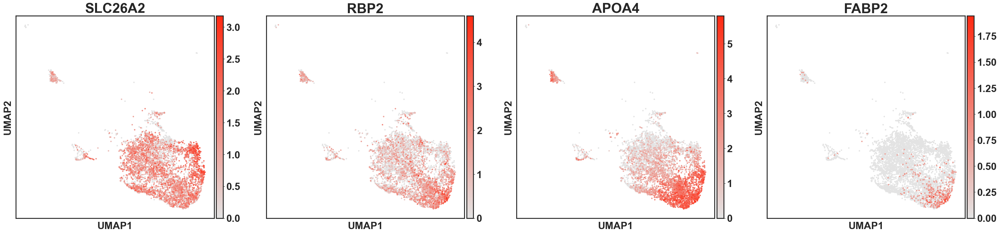

In [ ]:
fig = sc.pl.umap(adata[adata.obs['overallannotated'].isin(['ECLC']),:], color=['SLC26A2','RBP2','APOA4','FABP2'],size = 40,save = 'EC_map.png',cmap = my_cmap,return_fig = True,wspace  = 0.15)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('EC_map.png')

In [91]:
adata_vis.obsm['X_umap'] = adata.obsm['X_umap'] 
adata_vis.uns = adata.uns

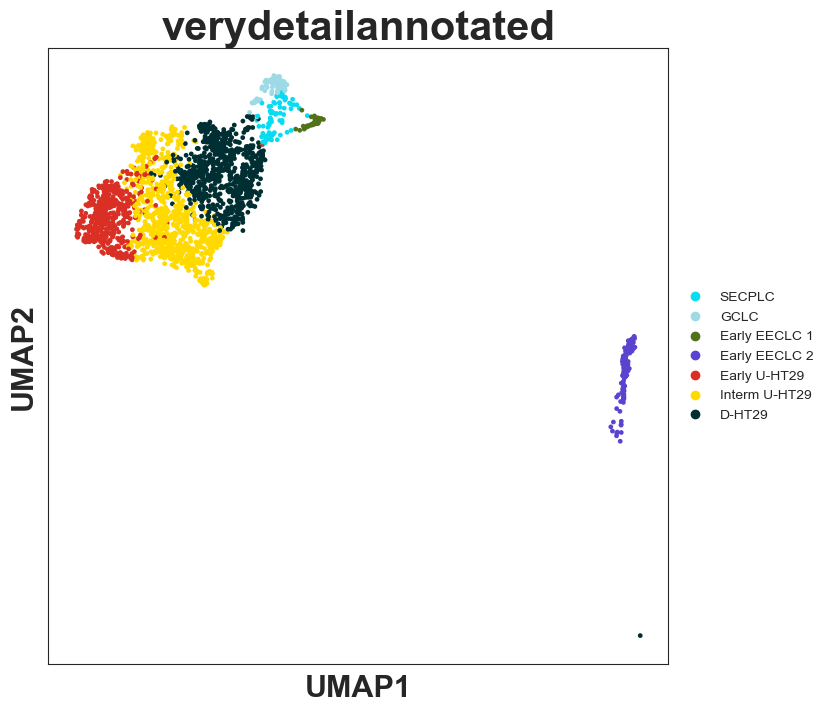

In [92]:
sec = adata_vis[adata_vis.obs['overallannotated'].isin(['U-HT29','D-HT29','GCLC','SECPLC','Early EECLC']),:]
fig = sc.pl.umap(sec, color = ['verydetailannotated'], ncols = 5 ,return_fig = True,cmap = my_cmap)
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
#plt.xlim([-6,2])
#plt.ylim([10,18])
plt.savefig('Secpart.png',bbox_inches='tight')

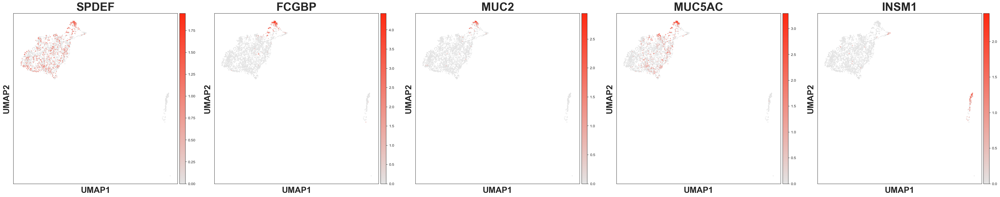

In [93]:
fig = sc.pl.umap(sec, color = ['SPDEF', 'FCGBP', 'MUC2','MUC5AC', 'INSM1'],size = 20,save = 'sec_map.png',ncols = 5,return_fig = True,cmap = my_cmap) #overview of the graph
ax = fig.get_axes()
for i in range(0,len(ax)):
    ax[i].xaxis.label.set_fontsize(22)
    ax[i].xaxis.label.set_fontweight('bold')
    ax[i].yaxis.label.set_fontsize(22)
    ax[i].title.set_fontsize(30)
    ax[i].yaxis.label.set_fontweight('bold')
    ax[i].title.set_fontweight('bold')
plt.savefig('Sec_map.png')

### Dotplots for each broad celltype

In [94]:
sec_sign = dict()
sec_sign['sig'] = ['RARRES2','TFF3']
sec_sign['Progenitor'] =['HES6','SOX4','STMN1']
sec_sign['Goblet'] = ['FCGBP','MUC2','MUC5AC','TFF3','ATOH1','DLL1']
sec_sign['Early Enteroendocrine'] = ['PAX4', 'INSM1', 'NEUROG3','RIMBP2'] 
sec_sign['Enteroendocrine-L'] = ['GCG', 'UCN3', 'ETV1','PROX1']
sec_sign['Enteroendocrine-D'] = ['SST','PCP4','HHEX']
sec_sign['Signaturee'] = ['VGF']
sec_sign['Proliferative'] = ['MKI67','TOP2A']

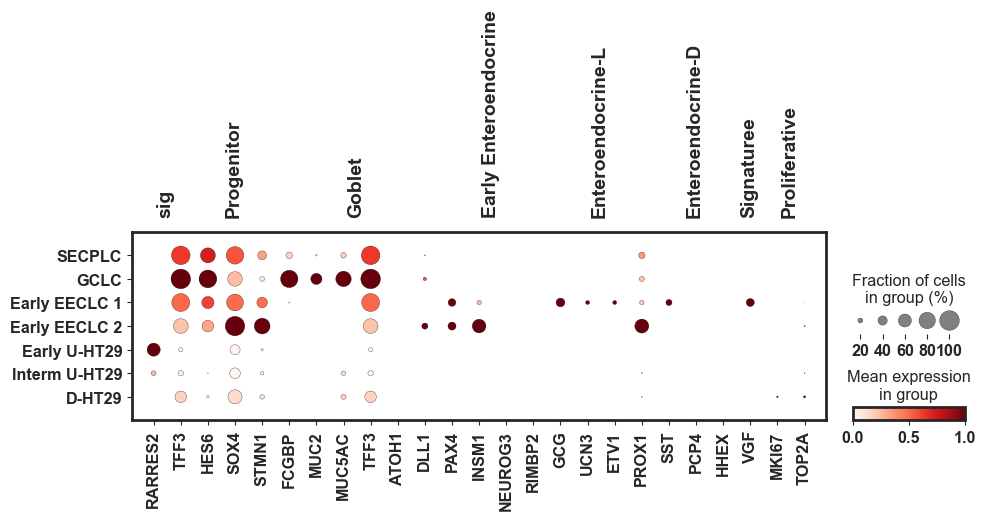

In [99]:
plt.rcParams.update({'font.size': 14, 'font.weight': 'bold','axes.linewidth':2})
sc.pl.dotplot(sec,
              sec_sign, 'verydetailannotated', vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'sec.png'
              )

In [56]:
ax[i].legend.set_fontweight('bold')

<bound method Axes.legend of <AxesSubplot:title={'center':'verydetailannotated'}, xlabel='UMAP1', ylabel='UMAP2'>>

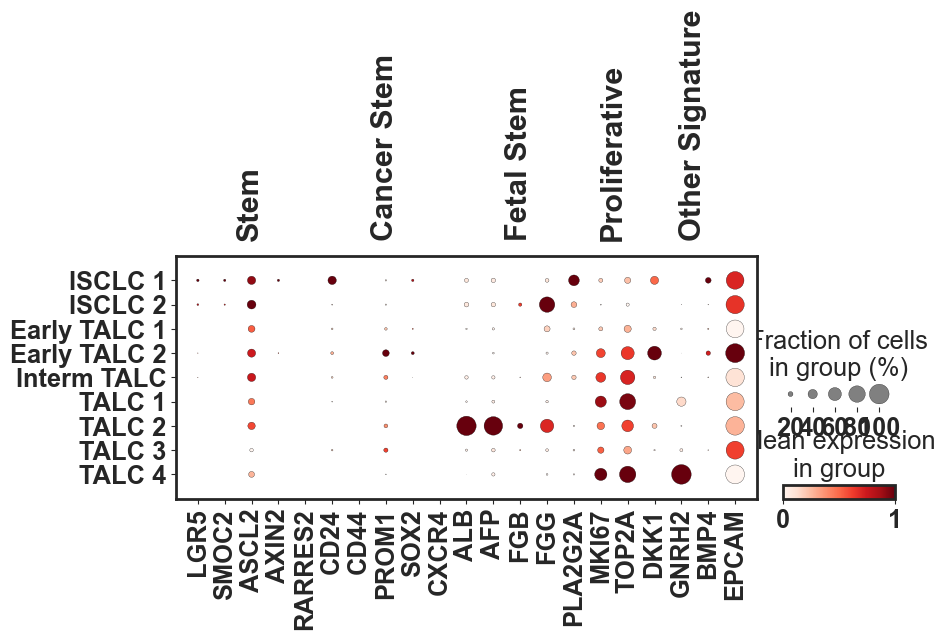

In [405]:
sc.pl.dotplot(adata[adata.obs['overallannotated'].isin(['ISCLC','TALC']),:],
              marker_genes, 'verydetailannotated',vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'id_stem.png')

In [347]:
marker_genes = dict()
marker_genes['Stem'] = ['LGR5','SMOC2','ASCL2','AXIN2','RARRES2']
marker_genes['Cancer Stem'] = ['CD24','CD44','PROM1','SOX2','CXCR4']
marker_genes['Fetal Stem'] = ['ALB','AFP','FGB','FGG','PLA2G2A']
marker_genes['Proliferative'] = ['MKI67','TOP2A']
marker_genes['Other Signature'] = ['DKK1','GNRH2','BMP4','EPCAM']

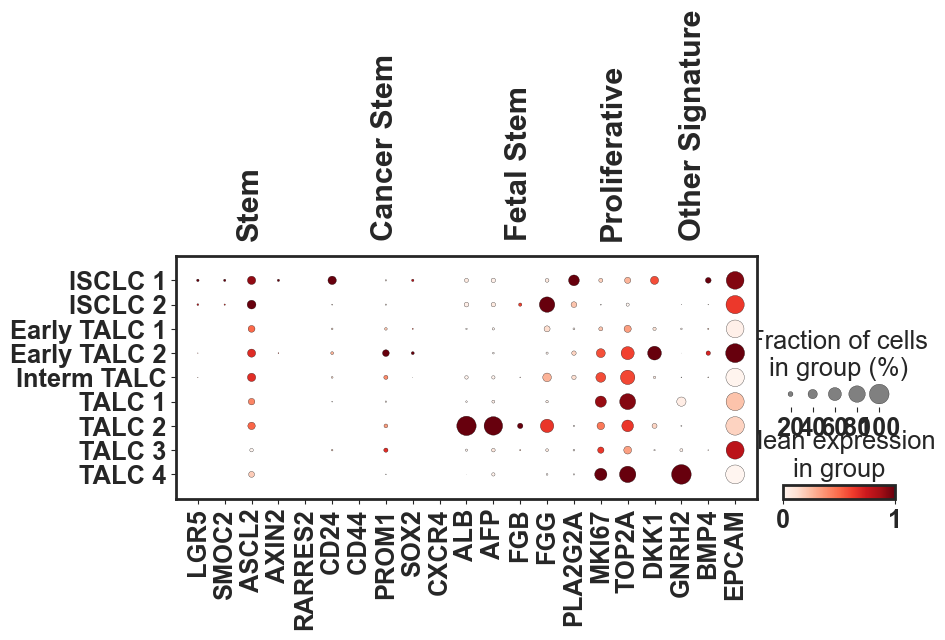

In [394]:
sc.pl.dotplot(adata[adata.obs['overallannotated'].isin(['ISCLC','TALC']),:],
              marker_genes, 'verydetailannotated', 
              layer  = 'counts', vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'id_stem.png')

In [423]:
SIG = dict()
SIG['Signatures'] = ['ALB','AFP','GNRH2','ANKRD37','LYZ','DEFB1']

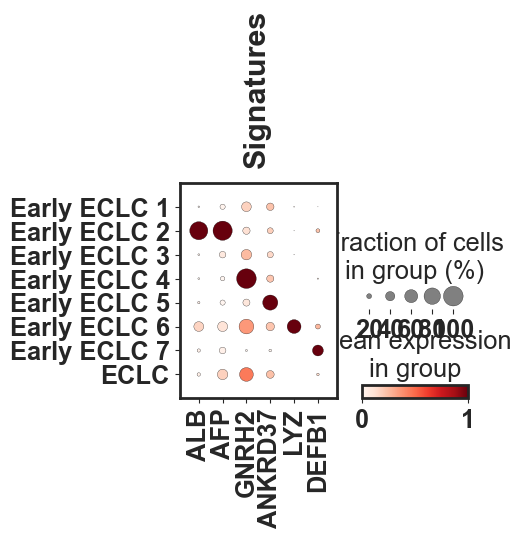

In [424]:
sc.pl.dotplot(adata[adata.obs['overallannotated'].isin(['ECLC']),:],
              SIG, 'verydetailannotated',vmax =1, swap_axes = False, dot_min = 0.05, standard_scale = 'var',save = 'id_EC.png')

In [382]:
absb = dict()
absb['Fatty Acid']=['SLC27A4', 'CD36', 'FABP1', 'FABP2', 'FABP6', 'APOA1', 'APOA4', 'APOB', 'APOC3', 'PCK1', 'PCK2', 'PDK4', 'MTTP', 'DGAT1', 'ASCL5']
absb['Glucose']=['SLC5A1', 'SLC2A2','SLC2A3', 'SLC2A5', 'SLC2A9', 'SLC2A10', 'SLC5A1', 'SLC5A9'] # SLC5A4
absb['Cholestrol']=['ABCG8', 'NPC1L1', 'SCARB1']
absb['Enzyme']=['MGAM', 'SI', 'LCT', 'ANPEP', 'ENPEP', 'DPP4', 'ALPI','CA1','CA2']
absb['Amino Acid']=['SLC15A1', 'SLC6A19', 'SLC6A20', 'PATL1', 'SLC25A15', 'SLC7A8', 'SLC3A1', 'SLC3A2', 'SLC6A6', 'SLC7A7', 'SLC1A5', 'SLC38A1']
absb['Cation']=['SLC22A1', 'SLC22A2', 'SLC22A3', 'SLC22A4', 'SLC22A5', 'SLCO2B1']
absb['Ion']=['SLC25A3', 'SLC26A3', 'SLC4A7']
absb['Vitamin']=['RBP2', 'RBP4', 'TCN2', 'CYP4F2', 'CD320']
absb['Water']=['AQP1', 'AQP3', 'AQP7', 'AQP8', 'AQP10', 'AQP11']
absb['Proliferative'] = ['MKI67','TOP2A']

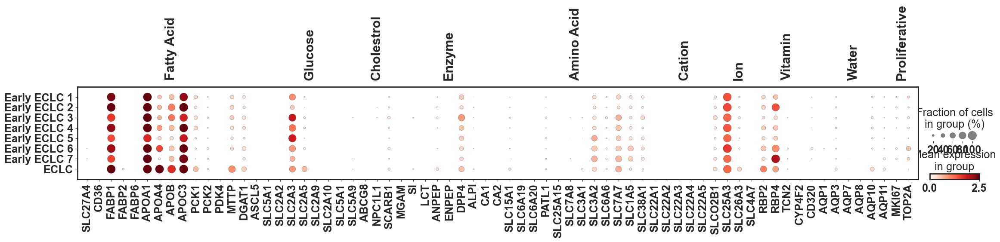

In [388]:
sc.pl.dotplot(adata_vis[adata_vis.obs['overallannotated'].isin(['ECLC']),:],
              absb, 'verydetailannotated', vmax =2.5, swap_axes = False, dot_min = 0.05, save = 'ECDOT.png'
              )

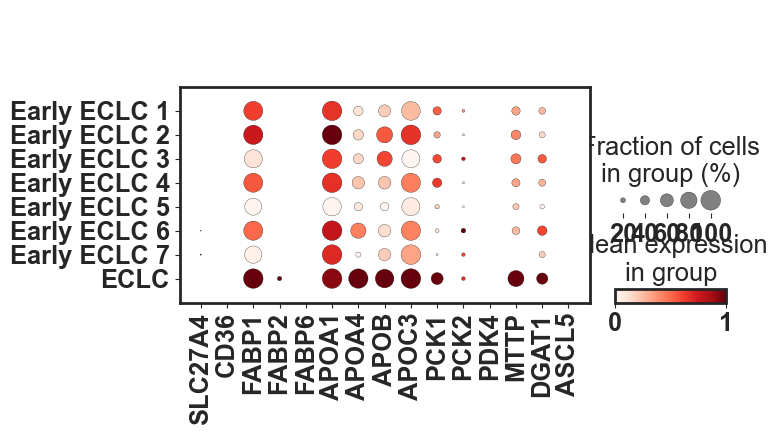

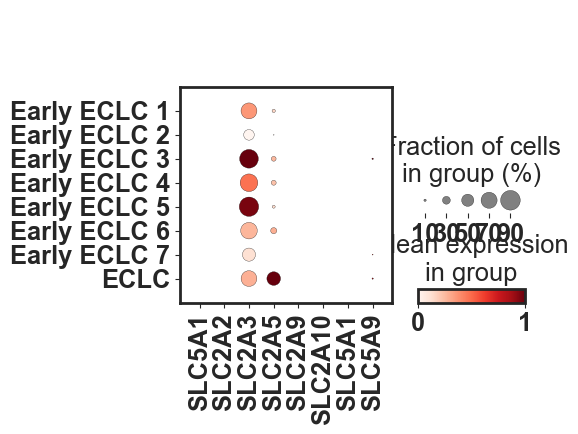

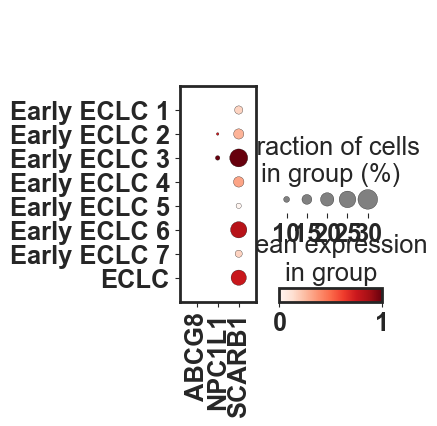

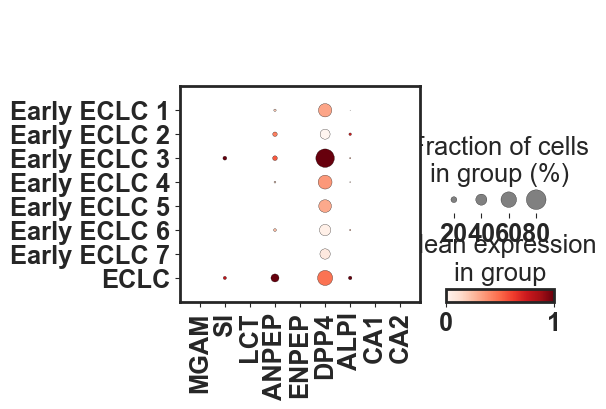

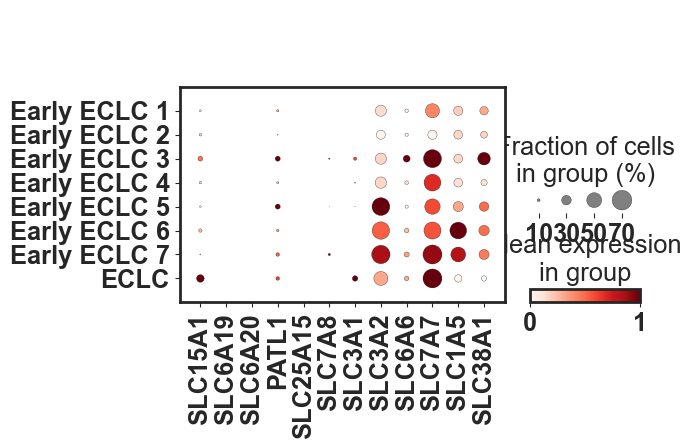

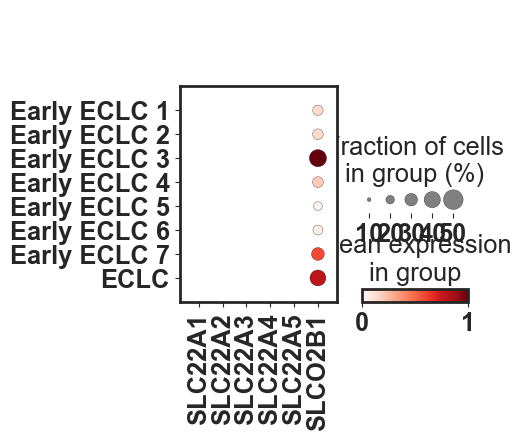

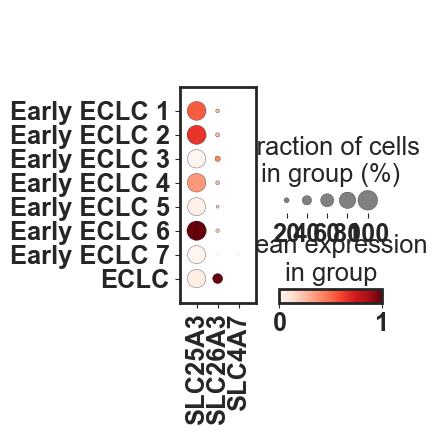

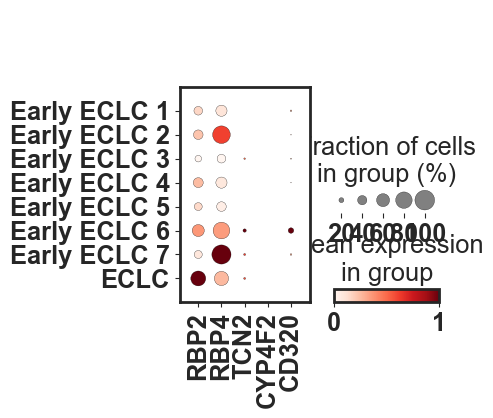

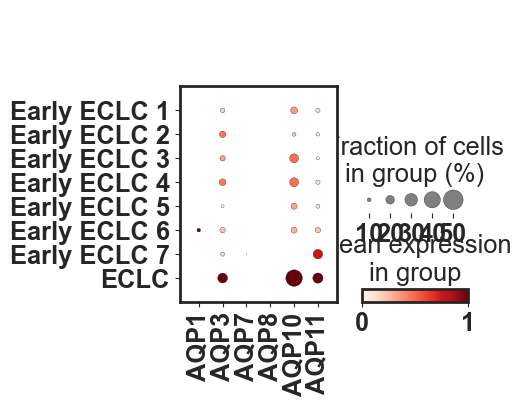

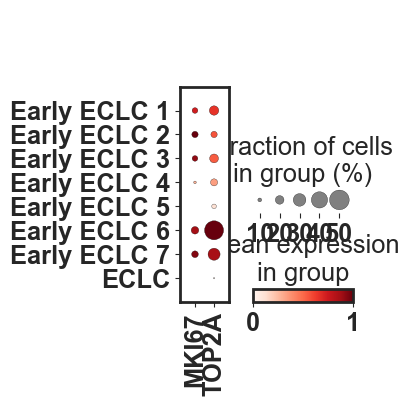

In [390]:
for i in absb.keys():
    sc.pl.dotplot(adata_vis[adata_vis.obs['overallannotated'].isin(['ECLC']),:],
              absb[i], 'verydetailannotated', vmax =1, swap_axes = False, dot_min = 0.05,  standard_scale='var',save = i+'.png'
              )

### Heatmap of signatures across all cell types

In [11]:
pass_genes = pd.DataFrame()
for i in set(adata.obs['celltype']):
    #log2foldmask = adata.uns['rank']['logfoldchanges'][i].astype('double')>1.5
    pvalmask = adata.uns['rank']['pvals'][i].astype('double')<0.01
    additional = pd.DataFrame({
        i: adata.uns['rank']['names'][i].astype('str')[pvalmask],
        'fold': adata.uns['rank']['logfoldchanges'][i][pvalmask]
    })
    additional = additional.sort_values(by = 'fold',ascending=False).reset_index()
    additional = additional[i][0:2]
    pass_genes = pd.concat([pass_genes, additional], ignore_index=False, axis=1) 

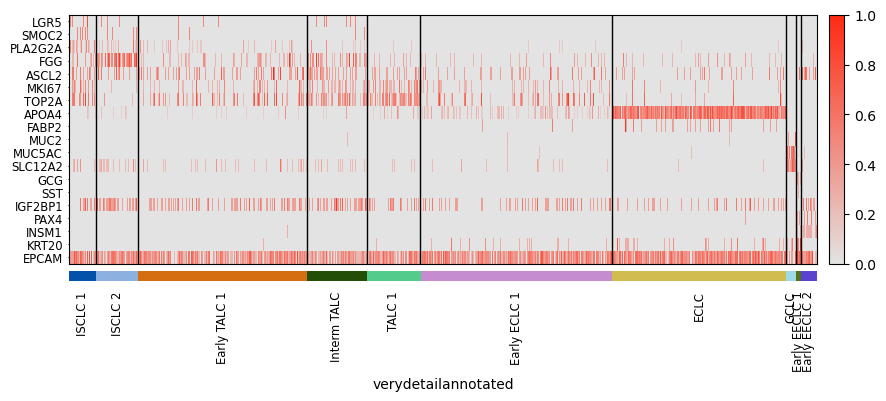

In [448]:
larger_group = adata[adata.obs['verydetailannotated'].isin(['ISCLC 1','ISCLC 2',
                    'Early TALC 1','Interm TALC','TALC 1','Early ECLC 1','ECLC','GCLC','Early EECLC 1','Early EECLC 2']),:]
Z = sc.pl.heatmap(larger_group, ['LGR5','SMOC2','PLA2G2A','FGG','ASCL2','MKI67','TOP2A','APOA4','FABP2','MUC2','MUC5AC','SLC12A2','GCG','SST','IGF2BP1','PAX4','INSM1','KRT20','EPCAM'], groupby='verydetailannotated', swap_axes=True, vmax =1, standard_scale='var',cmap = my_cmap,save ='id_marker_rep.png')

In [156]:
z = adata.obs['celltype'].cat.reorder_categories(ordered_celltype, inplace= True)
z.cat.reorder_categories(ordered_celltype, inplace= True)

C:\Users\16220\AppData\Local\Temp\ipykernel_23748\2440888213.py:2: FutureWarning: The `inplace` parameter in pandas.Categorical.reorder_categories is deprecated and will be removed in a future version. Reordering categories will always return a new Categorical object.
  z.cat.reorder_categories(ordered_celltype, inplace= True)


### PAGA

--> added 'pos', the PAGA positions (adata.uns['paga'])


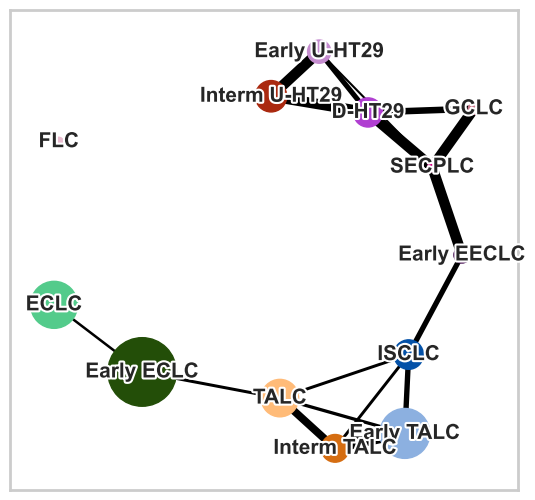

In [421]:
plt.rcParams.update({'font.size': 50, 'font.weight': 'heavy','axes.linewidth':2,'figure.figsize': [6,6]})
sc.pl.paga(adata,threshold = 0.15, labels=None, fontsize = 15, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

running PAGA
    finished: added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns) (0:00:02)
--> added 'pos', the PAGA positions (adata.uns['paga'])


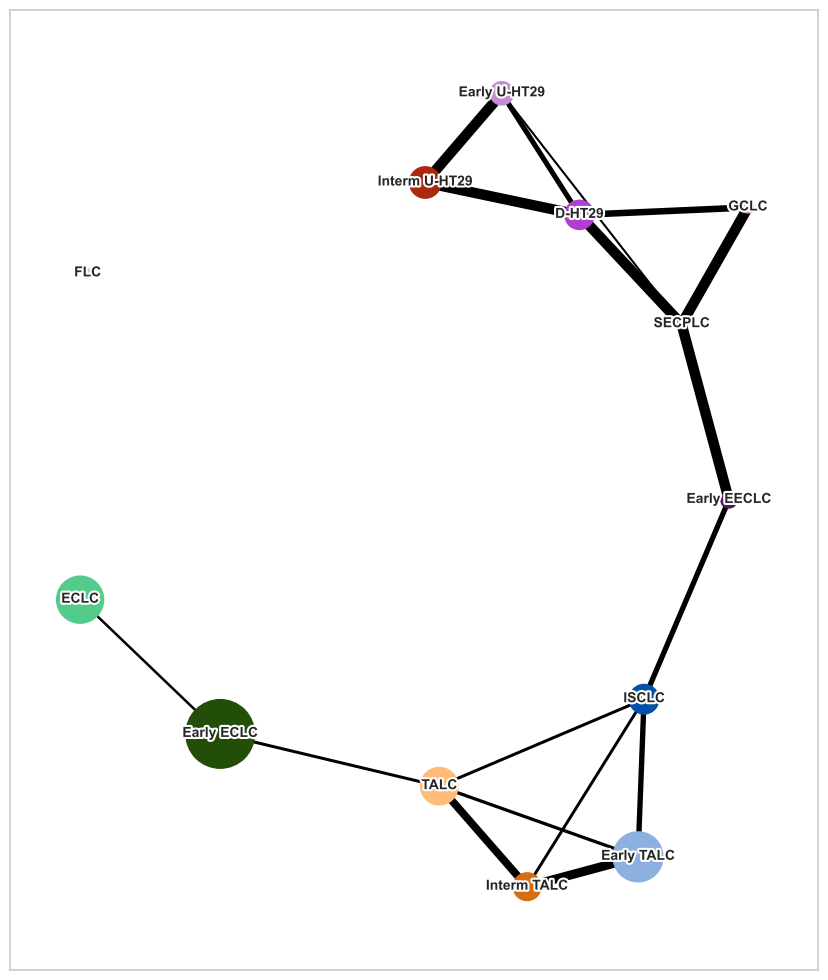

In [413]:
sc.tl.paga(adata, groups='detailannotated')
sc.pl.paga(adata,threshold = 0.15, labels=None, fontsize = 10, fontoutline = 3,node_size_scale = 3,node_size_power = 1,random_state = 0)

# Save and load

In [685]:
adata.write('standard2.h5ad')

In [7]:
adata_vis = sc.read_h5ad('forvis.h5ad')

In [8]:
adata = sc.read_h5ad('standard2.h5ad')

In [451]:
terms_isc.to_excel('DE_ISCLC.xlsx')
terms_ta.to_excel('DE_TALC.xlsx')
terms_ec.to_excel('DE_ECLC.xlsx')